# Fifth Exercise (Chapter 10)

This exercise focuses on recurrent neural networks (RNN). Also, we'll be using Pytorch from now on 🎉!

We will:
- implement an LSTM cell in Pytorch,
- train two forms of RNNs, namely:
    - many to one: value memorization
    - many to many: de-noising sequences

In [1]:
from typing import Tuple, Union

import numpy as np  # generate training data
# pytorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt

from torch.nn.parameter import Parameter
import math

## Preliminary Questions

Before we dive into the implementation parts, let's think about a few aspects of recurrent neural networks.
*Hint: Reading chapter 10 of the deep learning book might help with answering the questions.* Two other great resources are:
- Andrej Karpathy's [blog post on RNNs](http://karpathy.github.io/2015/05/21/rnn-effectiveness/), which, among other things, nicely explains the different variants of RNNs (one-to-one, many-to-many, etc).
- Chris Olah's [blog post on LSTMs](http://colah.github.io/posts/2015-08-Understanding-LSTMs/).



**1.** In what sense are convolutional neural networks and recurrent neural networks similar? In what sense are they different?

**Answer**:  

Convolutional Neural Networks (CNNs) use as input a fixed-sized vector (e.g. an image) and it produces a fixed-sized vector as output (e.g. the probability that such image belongs to different classes). CNNs perform this mapping between input and output through a fixed amount of computational steps (also called number of layers). As can be seen, CNNs are constrained in their API.

However, Recurrent Neural Networks (RNNs) are more flexible. RNNs work with sequences of vectors, and they can be in the input, output or both of them. This sequence regime is much powerful than using fixed-sized networks.

In the other side, one of the features that both network architectures share, is Weight Sharing (but in different ways). CNNs share weights across their input dimensions, and RNNs do the same, but in/through  time. 

**2.** How can one counteract vanishing or exploding gradients in RNNs, allowing to learn long-term dependencies?

**Answer**:  

Before in MLPs, we faced the Vanishing Gradient problem with bypass or skips connections, which allow us to drive the unaltered gradients to other parts of the network. Here, LSTMs could to the same thing, if the cell state would persists indefinitely.

In the other hand, exploding gradients can be solved by clipping the cell states of the LSTMs.

## LSTM cell
See chapter 10.10.1 of the DL book.

In Pytorch, all layers inherit from `nn.Module` and implement the `forward` function (the `backward` pass is computed automatically). Parameters should be initialized in the constructor.

To get a feeling for how layers are implemented in pytorch, you can for example take a look at the source code of the [Linear layer](https://pytorch.org/docs/stable/_modules/torch/nn/modules/linear.html#Linear) ($h = wX+b$).

Your task here is to implement the LSTMCell, which takes a feature tensor and the hidden state as input and returns the new hidden state (sometimes also referred to as output) and the new cell state.


In [2]:
class LSTMCell(nn.Module):
    """The LSTM layer."""
    
    def __init__(self, input_size: int, hidden_size: int):
        super().__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        
        # START TODO #############
        # initialize required parameters / layers

        #Forget Gate
        self.Wf = Parameter(torch.Tensor(self.input_size + self.hidden_size, self.hidden_size))
        self.bf = Parameter(torch.Tensor((self.hidden_size)))
        #self.reset_parameter(self.Wf, self.bf)
        
        #Input Gate
        self.Wi = Parameter(torch.Tensor(self.input_size + self.hidden_size, self.hidden_size))
        self.bi = Parameter(torch.Tensor((self.hidden_size)))
        #self.reset_parameter(self.Wi, self.bi)
        
        #Cell state
        self.Wc = Parameter(torch.Tensor(self.input_size + self.hidden_size, self.hidden_size))
        self.bc = Parameter(torch.Tensor((self.hidden_size)))
        #self.reset_parameter(self.Wc, self.bc)
        
        #Output
        self.Wo = Parameter(torch.Tensor(self.input_size + self.hidden_size, self.hidden_size))
        self.bo = Parameter(torch.Tensor((self.hidden_size)))
        #self.reset_parameter(self.Wo, self.bo)
        
        for w in [
            self.Wf, self.bf,
            self.Wi, self.bi,
            self.Wc, self.bc,
            self.Wo, self.bo,
        ]:
            w.data.uniform_(-0.05, 0.05)
            
        # END TODO #############
            
    def reset_parameter(self, weight, bias):
        stdv = 1. / math.sqrt(weight.size(1))
        weight.data.uniform_(-stdv, stdv)
        if bias is not None:
            bias.data.uniform_(-stdv, stdv)
    
    def forward(self, x: torch.Tensor, hx: Tuple[torch.Tensor] = None) -> Tuple[torch.Tensor]:
        """
        
        Args:
            x: The input tensor with shape (batch_size, feature_dim)
            hx: The initial hidden state, optional. Is a two-tuple consisting of
                the current hidden state and the internal cell state. Both have
                shape (batch_size, hidden_size).
                
        Returns:
            Tuple as (output_hidden, new_internal_state).
        """
        if hx is None:
            hx = self._init_hidden_state(x)
        hidden_state, internal_state = hx
        
        # START TODO #############

        # First, we concatenate the hidden state (ht-1) with the input x
        # We will use this concatenation more times after
        conc = torch.cat((hidden_state,x),1)
        
        # 1°Step: Forgot Gate layer
        # ====================
        # We decide which information we throw away, and which we keep
        # It outputs a number between 0 and 1 determining the importance of the information
        # (e.g 1 is keep all, 0 is remove completely)
        f_tmp = torch.mm(conc,self.Wf)
        forget_gate = torch.sigmoid(f_tmp + self.bf.expand_as(f_tmp))
        
        # 2°Step: Input Gate layer
        # Here we decide which new information we are going to store in the cell state
        # To do so, there are two steps:
        
        # First, the sigmoid function says which values we are goint to update        
        i_tmp = torch.mm(conc,self.Wi)
        input_gate = torch.sigmoid(i_tmp + self.bi.expand_as(i_tmp))
        
        # Second, the tanh function create a vector of candidates to be added to the cell state
        c_tmp = torch.mm(conc, self.Wc)
        internal_state_candidates = torch.tanh(c_tmp + self.bc.expand_as(c_tmp))
        
        # 3°Step: Update Cell State
        # We replace the old Cell State by the updated one.
        # First, we multiply the old state by the Forgetting function, forgetting the things we decided to forget earlier. 
        # Then we add the new candidate values, scaled by how much we decided to update each state value
        new_internal_state = (forget_gate*internal_state) + (input_gate*internal_state_candidates)
        
        # 4°Step: Output
        # Here we decide what we are going to output. It is basically a "filtered" Cell State. There are two steps:
        
        # The sigmoid function "filters", by deciding which parts of the Cell State we are going to output
        temp_o = torch.mm(conc, self.Wo)
        output = torch.sigmoid(temp_o + self.bo.expand_as(temp_o))
        
        # Then, we multiply the previous output, by a tanh version of the (updated already) Cell State
        new_hidden_state = output*torch.tanh(new_internal_state)
                
        return new_hidden_state, new_internal_state
    
        # END TODO #############
    
    def _init_hidden_state(self, x):
        """Returns the hidden state with zeros.
        
        Returns:
            A two-tuple (initial_hidden_state, initial_cell_state).
            Both are all zeros with shape (batch_size, hidden_size).
        """
        batch_size = x.shape[0]
        return torch.zeros(batch_size, self.hidden_size),torch.zeros(batch_size, self.hidden_size)

In [3]:
class LSTM(LSTMCell):
    """Convenience class that automatically iterates over the sequence."""
    
    def forward(self, x: Union[np.ndarray, torch.Tensor], hx=None):
        """Iterate over the sequence and apply the LSTM cell.
        
        Args:
            x: The input tensor with shape (seq_len, batch, input_size)
            hx: The initial hidden state, optional. Is a two-tuple consisting of
                the current hidden state and the internal cell state. Both have
                shape (batch_size, hidden_size). If None, set to zero.
        
        Returns:
            Tuple as (output_stacked_hidden, (last_hidden_state, last_new_internal_state)).
            output_stacked_hidden is the stacked output of all LSTMCells
            (excluding the cell state!)
        """
        # START TODO #############
        
        if not isinstance(x, torch.Tensor):
            x = torch.Tensor(x, requires_grad=True)
        
        # Lengh of the sequence
        seq_len = x.shape[0]
        
        # Batch size
        batch_size = x.shape[1]
        
        # Input size
        input_size = x.shape[2]

        output_stacked_hidden = torch.Tensor(seq_len, batch_size, self.hidden_size) 
        
        # Iteration over each element of the sequence
        for i in range(seq_len):
            xt = x[i,:,:]
            hx = super().forward(xt,hx)
            output_stacked_hidden[i] = hx[0]
        
        return output_stacked_hidden, hx
    
        # END TODO #############

As a simple test, let's see if the LSTM can learn to echo a value at a specific index of the sequence. If your implementation is correct, you should get around 97% accuracy.

In [5]:
# Create 100 training sequences of length 10
num_samples = 1000
seq_length = 10
batch_size = 5
# we use a hidden size larger 1 as it makes training easier
# as prediction we compute the mean over the output.
hidden_size = 6
training_sequences = torch.rand(seq_length, num_samples, 1)
print("training sequences size : {}".format(training_sequences.shape))
test_sequences = torch.rand(seq_length, 100, 1)
model = LSTM(1, hidden_size)
optimizer = optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=100)
loss_fn = torch.nn.MSELoss(reduction='elementwise_mean')


def accuracy(y, label, eps=1e-2):
    assert y.shape == label.shape, (y.shape, label.shape)
    return np.sum(np.abs(y - label) < eps) / len(y)


for epoch in range(101):
    for batch_idx in range(num_samples // batch_size):
        optimizer.zero_grad()
        batch = training_sequences[:, batch_idx * batch_size:(batch_idx + 1) * batch_size]
        # [10,5,1] batch sizes going in
        output = model(batch)[1][0]
        labels = batch[1]  # echo the second element
        loss = loss_fn(labels, output)
        loss.backward()
        optimizer.step()
    if epoch % 10 == 0: 
        #print(f"epoch: {epoch}, loss:{loss}")
        print("epoch: {}, loss:{}".format(epoch,loss)) # <- for Python3.5
        output = model(test_sequences)[1][0]
        labels = test_sequences[1]  # echo the second element
        acc = accuracy(np.squeeze(labels.numpy()),
                       np.mean(output.detach().numpy(), axis=-1))
        #print(f"test accuracy: {acc}")
        print("test accuracy: {}".format(acc)) # <- for Python3.5
    scheduler.step()

# 99% achieved using uniform distribution (-0.05, 0.05)

training sequences size : torch.Size([10, 1000, 1])
epoch: 0, loss:3.423022747039795
test accuracy: 0.03
epoch: 10, loss:0.028968337923288345
test accuracy: 0.25
epoch: 20, loss:0.043796148151159286
test accuracy: 0.19
epoch: 30, loss:0.05042068660259247
test accuracy: 0.25
epoch: 40, loss:0.005129443947225809
test accuracy: 0.78
epoch: 50, loss:0.02741079591214657
test accuracy: 0.26
epoch: 60, loss:0.002410437446087599
test accuracy: 0.48
epoch: 70, loss:0.0011290108086541295
test accuracy: 0.78
epoch: 80, loss:0.0003590034320950508
test accuracy: 0.96
epoch: 90, loss:0.00022453011479228735
test accuracy: 0.97
epoch: 100, loss:0.00031926206429488957
test accuracy: 0.97


## LSTM Use Case - Noise Removal
Implement an RNN to remove noise from different sine function instances. If you didn't finish the `LSTM` implementation part, you can use `nn.LSTM` here.

The goal is to remove gaussian noise from a sequence generated from a sine function.

To get an idea what the data look like, plot six different sine function instances with and without noise.

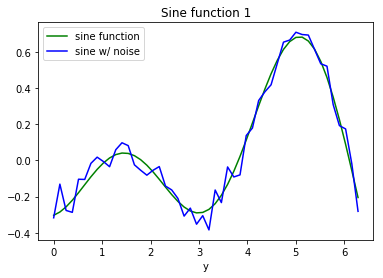

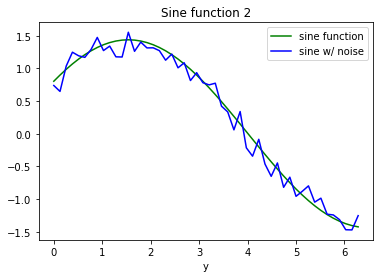

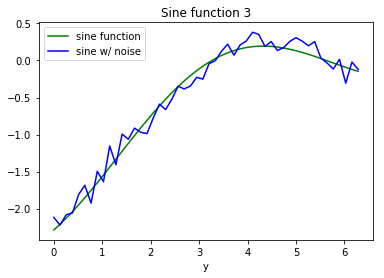

In [6]:
# let's create a generator for sine functions with different amplitudes, shift and frequency

class RandomSineFunction:
    
    def __init__(self):
        num_sines = np.random.randint(1, 4)
        self.amplitude = np.random.uniform(0, 2, num_sines)
        self.offsets = np.random.uniform(-np.pi, np.pi, num_sines)
        self.frequency = np.random.uniform(0.1, 1, num_sines)
        
    def __call__(self, x):
        return np.array([a * np.sin(np.pi * f * x + o)
                         for a, f, o in zip(self.amplitude, self. frequency, self.offsets)]).sum(axis=0)

    
def sample_sine_functions(num_functions):
    return [RandomSineFunction() for _ in range(num_functions)]


def noisy(y, noise_ratio=0.05, axes=None):
    noise_range = np.ptp(y, axis=axes, keepdims=True) * noise_ratio
    return y + np.random.normal(0, noise_range, size=y.shape)

# START TODO #############

functions = sample_sine_functions(3)
for i in range(len(functions)):

    # Generate equally spaced data in x and function in y
    x = np.linspace(0, 2*np.pi, 50)
    y = functions[i](x)
    yn = noisy(y)
    
    plt.figure(i)
    plt.title("Sine function %s" % (i+1) )
    plt.xlabel("x")
    plt.xlabel("y")
    plt.plot(x,y, color = 'green', label = 'sine function')
    plt.plot(x,yn, color = 'blue', label = 'sine w/ noise')
    plt.legend()
    plt.show()

# END TODO #############


Now it's time to define the model! Let's stack two LSTMs both with output shape (sequence_length, batch_size, hidden_size) followed by a Linear layer which takes a (sequence_length, batch_size, hidden_size) vector as input and outputs a tensor with shape (sequence_length, batch_size, 1).


To allow the model to see some values before estimating the output, pad the sequence accordingly.

In [8]:
class NoiseRemovalModel(nn.Module):
    """
    """
    
    def __init__(self, hidden_size: int, shift: int = 10):
        """
        Args:
            hidden_size: the number of units of the LSTM hidden state size.
            shift:       the number of steps the RNN is run before its output
                             is considered ("many-to-many shifted to the right").
        """
        super().__init__()
        self.shift = shift
        
        # START TODO #############
        
        # LSTM_1 (x=1, hx) -> LSTM_2 (x=hx, hx) -> Linear(x=hx, 1)
        self.LSTM_1 = LSTM(1, hidden_size)
        self.LSTM_2 = LSTM(hidden_size, hidden_size)
        self.LINEAR = nn.Linear(hidden_size, 1)
    
        # END TODO #############

        
    def forward(self, x: np.ndarray) -> torch.Tensor:
        """Forward pass of noise removal.
        
        This function
        1) pads the input sequence with self.interval zeros at the end,
        2) applies an LSTM
        3) cuts the first self.interval outputs
        4) applies another LSTM
        5) applies Linear layer.
        
        Args:
            x: The input sequence (equence_length, batch_size, 1)
        
        Returns:
            A torch.Tensor of shape (sequence length, batch_size, 1)
        """
        
        # Pad input sequence x at the end (shifted many-to-many model).
        # This allows the model to see a few numbers before it has to guess
        # the noiseless output.
        
        # START TODO #############
        
        # 1) We pad the input sequence at the end
        # x.size before (80, 10, 1)
        x = F.pad(x, (0,0,0,0,0,self.shift), 'constant', 0)    
        # x.size before (90, 10, 1)

        # 2) LSTM_1
        h1, (_,_) = self.LSTM_1.forward(x)
        
        # 3) Cuts the first self.interval outputs
        h1 = h1[self.shift:,:,:]
                
        # 4) LSTM_2
        h2, (_,_) = self.LSTM_2.forward(h1)
                
        # h1.size before (90, 10, 40)
        # h1.size after (80, 10, 40)
        # h2.size before (80, 10, 40)   
        # h2.size after (80, 10, 1)

        # 5) Linear layer
        out = self.LINEAR.forward(h2)
        # output size (80, 10, 1)

        return out
    
        # END TODO #############

In [9]:
num_functions = 200
sequence_length = 80
noise_ratio = 0.05
np.random.seed(0)
train_functions = sample_sine_functions(num_functions)
val_functions = sample_sine_functions(50)
# interval on which we'll train and evaluate
x = np.linspace(0, 5, sequence_length)


def prepare_sequences(functions):
    """Convert to tensor and create noisy sequence"""
    sequences = np.array([f(x).reshape(-1, 1) for f in functions])
    # put the sequence into the first dimension
    sequences = sequences.transpose([1, 0, 2])
    # add some noise
    noisy_sequences = noisy(sequences, noise_ratio, axes=(0, 2))
    return torch.Tensor(sequences), torch.Tensor(noisy_sequences)


train_sequences, noisy_train_sequences = prepare_sequences(train_functions)
val_sequences, noisy_val_sequences = prepare_sequences(val_functions)
print(train_sequences.shape)

torch.Size([80, 200, 1])


In [10]:
loss_fn = torch.nn.MSELoss(reduction='elementwise_mean')


def plot_curves(ground_truth, noisy_sequence, model_output):
    plt.figure(figsize=(14,3))
    for i in range(min(len(ground_truth), 5)):
        plt.subplot(1, 5, i + 1)
        plt.plot(x, ground_truth[i], label="ground_truth")
        plt.plot(x, noisy_sequence[i], label="noisy_sequence")
        plt.plot(x, model_output[i], label="model_output")
    plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
    plt.show()

    
def percentage_noise_removed(ground_truth, noisy_sequence, model_output):
    """Computes the percentage of noise the model removed."""
    return 100 * (1 - (np.abs(ground_truth - model_output).sum() /
                  np.abs(ground_truth - noisy_sequence).sum()))


def train(model, optimizer, scheduler, num_epochs, batch_size, plot=True):
    for epoch in range(num_epochs):
        for batch_idx in range(num_functions//batch_size): # 20 batches going in, each of size 80x10x1
            batch =  noisy_train_sequences[:, batch_idx * batch_size:(batch_idx + 1) * batch_size]
            
            # Set grad to zero
            optimizer.zero_grad()
            
            output = model(batch)
            labels = train_sequences[:, batch_idx * batch_size:(batch_idx + 1) * batch_size]
            loss = loss_fn(labels, output)
            loss.backward()
            optimizer.step()
        # compute the validation loss
        output = model(noisy_val_sequences)
        loss = loss_fn(val_sequences, output)
        print("epoch: {}, validation loss:{}".format(epoch,loss)) # <- for Python3.5
        if epoch % 1 == 0:
            np_tensors = [a.detach().numpy().transpose([1, 0, 2])
                          for a in (val_sequences, noisy_val_sequences, output)]
            if plot:
                plot_curves(*np_tensors)
            print("{:.2f}% of noise removed.".format(percentage_noise_removed(*np_tensors))) # <-for Python3.5
            #print(f"{percentage_noise_removed(*np_tensors):2.4f}% of noise removed.") 
        scheduler.step()


cuda avialable : False
epoch: 0, validation loss:1924.744873046875


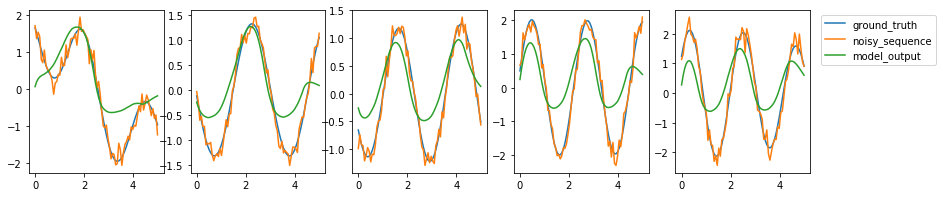

-299.05% of noise removed.
epoch: 1, validation loss:1290.202392578125


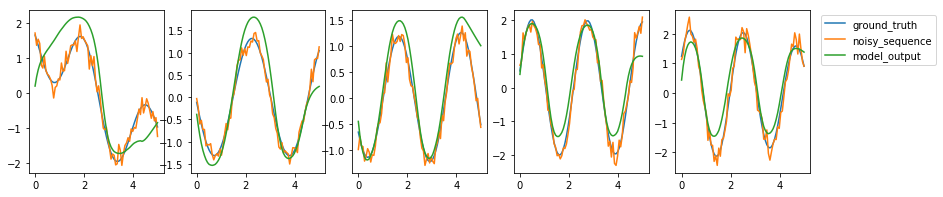

-261.06% of noise removed.
epoch: 2, validation loss:846.9428100585938


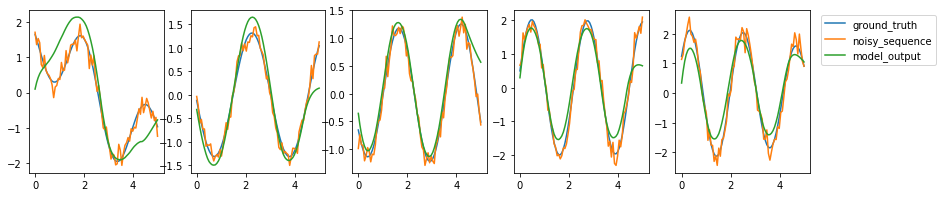

-180.51% of noise removed.
epoch: 3, validation loss:683.1470336914062


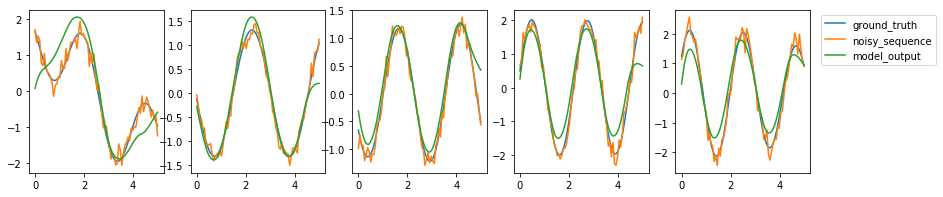

-146.74% of noise removed.
epoch: 4, validation loss:525.8858642578125


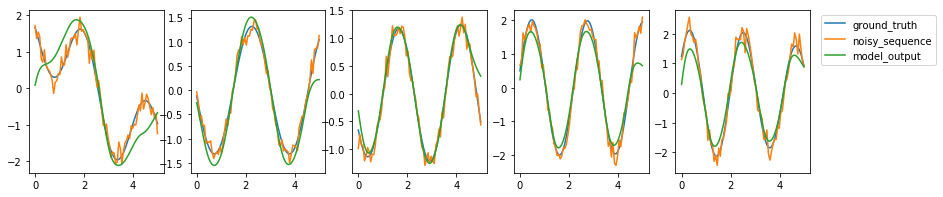

-115.15% of noise removed.
epoch: 5, validation loss:358.3366394042969


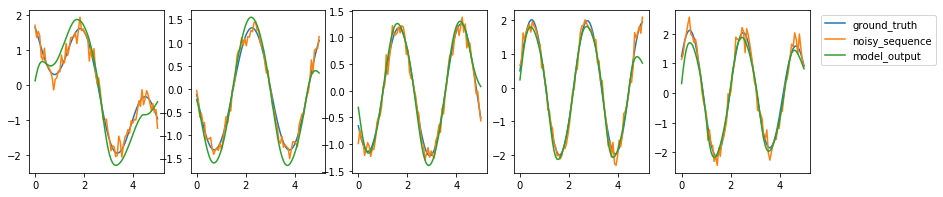

-68.28% of noise removed.
epoch: 6, validation loss:382.3981018066406


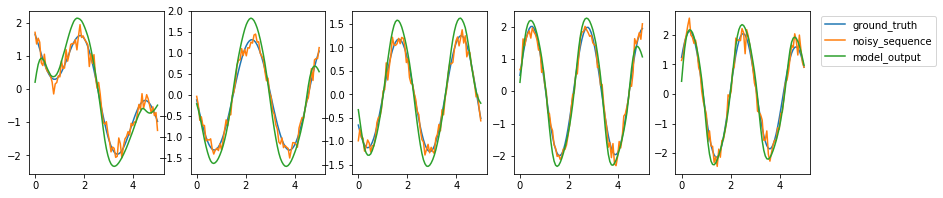

-90.77% of noise removed.
epoch: 7, validation loss:272.490966796875


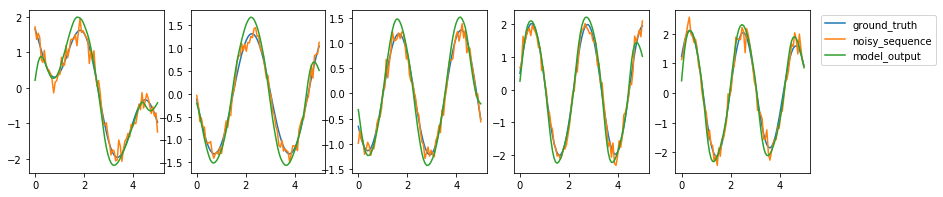

-48.46% of noise removed.
epoch: 8, validation loss:191.18081665039062


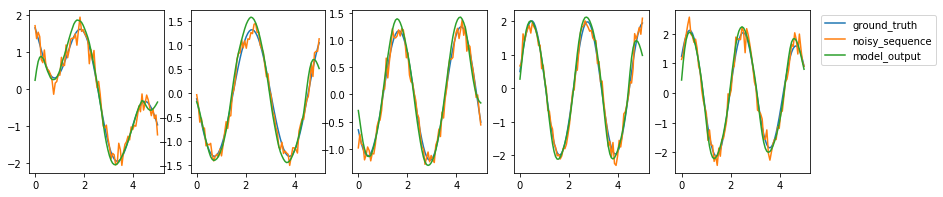

-14.17% of noise removed.
epoch: 9, validation loss:174.64373779296875


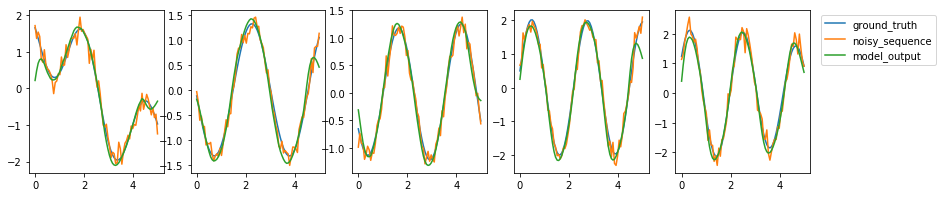

1.04% of noise removed.
epoch: 10, validation loss:183.89389038085938


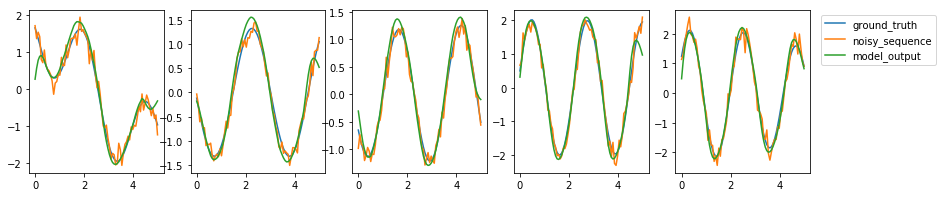

-14.59% of noise removed.
epoch: 11, validation loss:297.195556640625


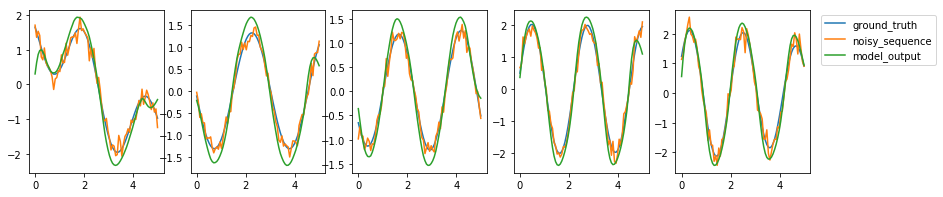

-69.59% of noise removed.
epoch: 12, validation loss:236.3197021484375


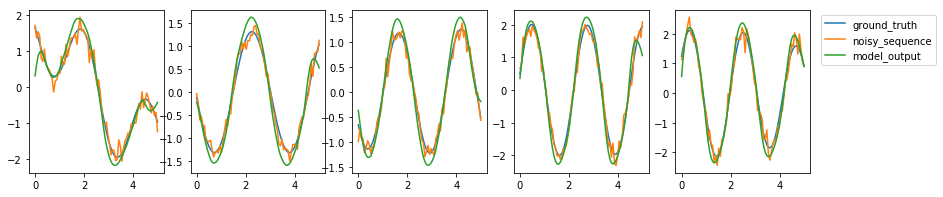

-43.81% of noise removed.
epoch: 13, validation loss:320.25933837890625


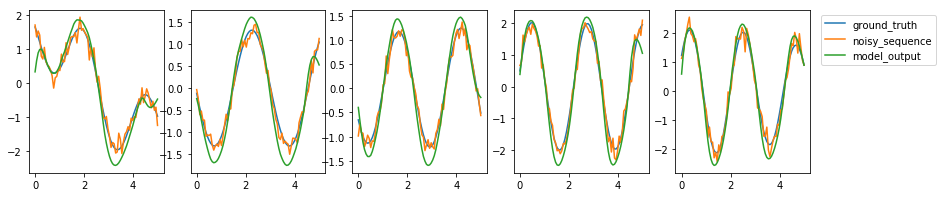

-74.51% of noise removed.
epoch: 14, validation loss:227.94505310058594


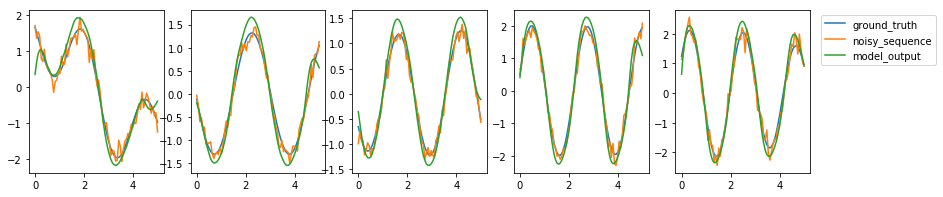

-41.78% of noise removed.
epoch: 15, validation loss:374.3262023925781


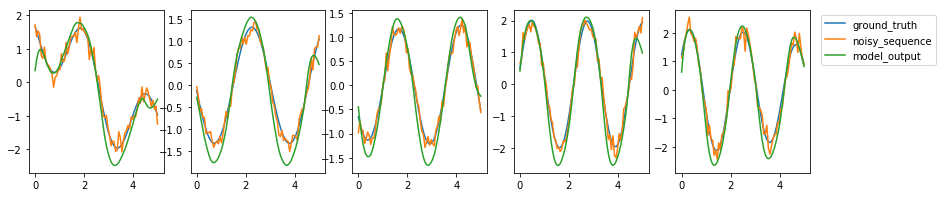

-86.16% of noise removed.
epoch: 16, validation loss:207.79513549804688


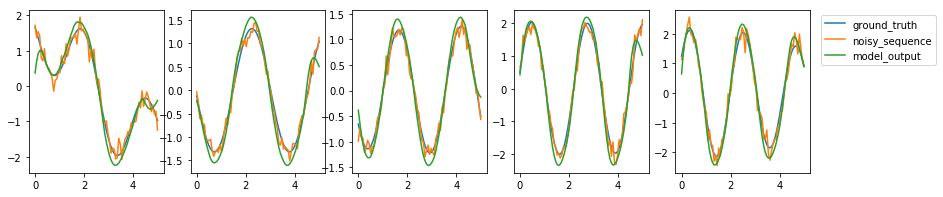

-33.31% of noise removed.
epoch: 17, validation loss:223.5905303955078


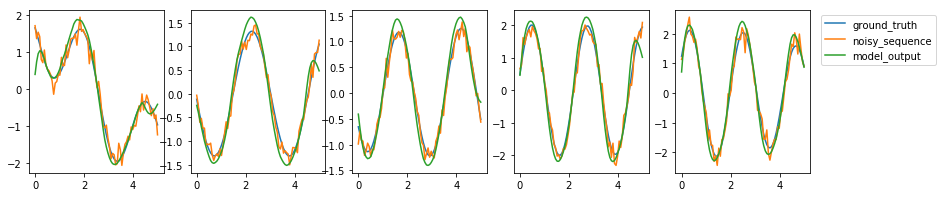

-38.51% of noise removed.
epoch: 18, validation loss:260.3240966796875


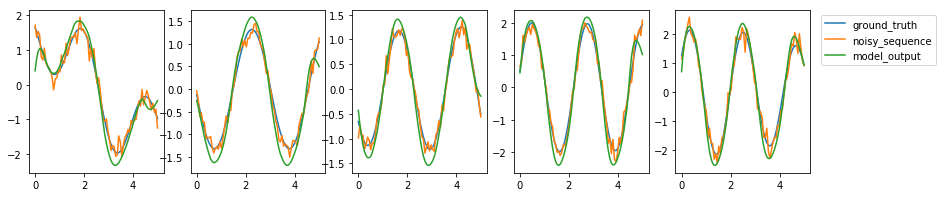

-57.46% of noise removed.
epoch: 19, validation loss:218.765869140625


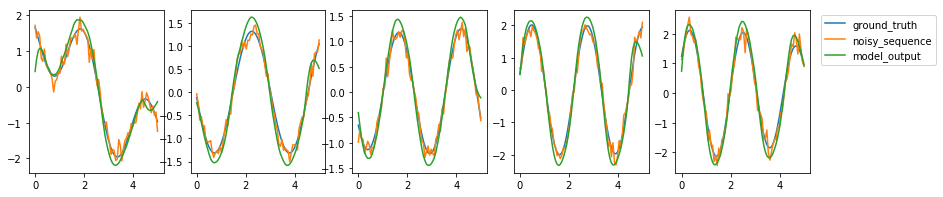

-40.97% of noise removed.
epoch: 20, validation loss:206.32086181640625


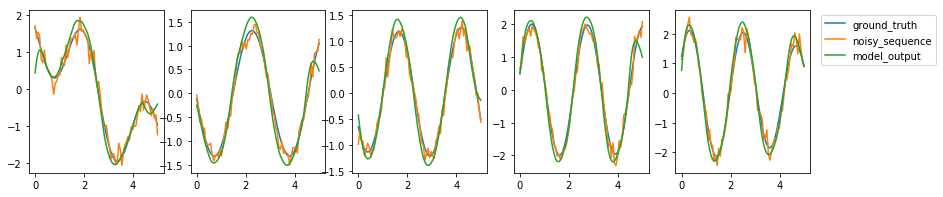

-32.36% of noise removed.
epoch: 21, validation loss:242.5245361328125


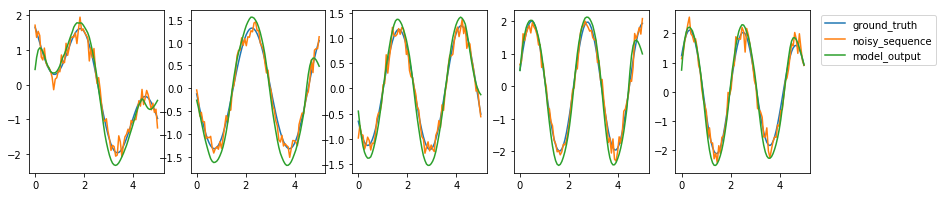

-51.12% of noise removed.
epoch: 22, validation loss:203.47154235839844


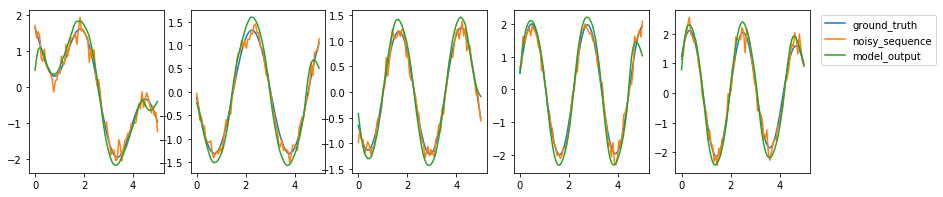

-35.27% of noise removed.
epoch: 23, validation loss:191.68814086914062


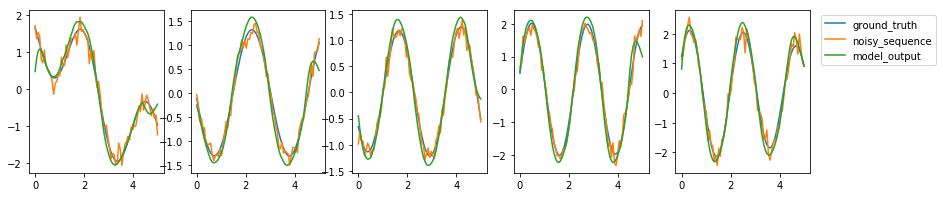

-28.12% of noise removed.
epoch: 24, validation loss:229.5247039794922


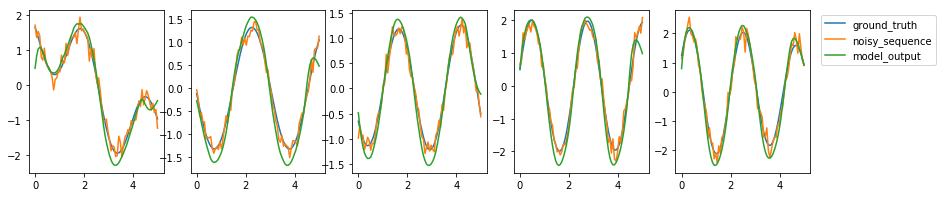

-46.78% of noise removed.
epoch: 25, validation loss:182.6816864013672


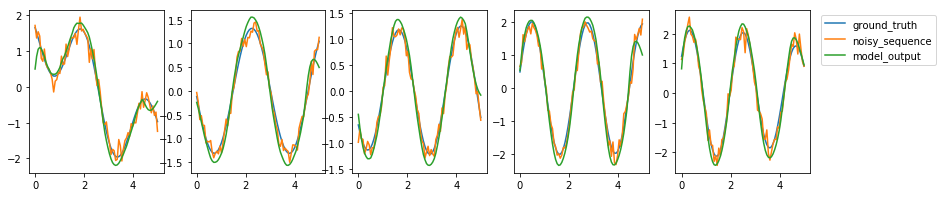

-27.05% of noise removed.
epoch: 26, validation loss:179.8080596923828


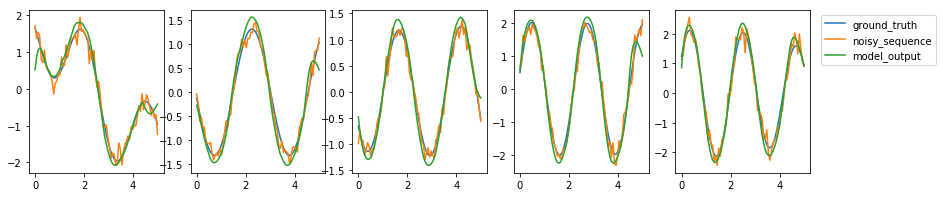

-25.38% of noise removed.
epoch: 27, validation loss:213.1221160888672


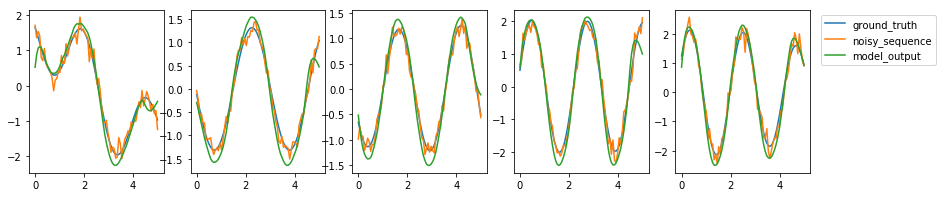

-42.40% of noise removed.
epoch: 28, validation loss:167.98362731933594


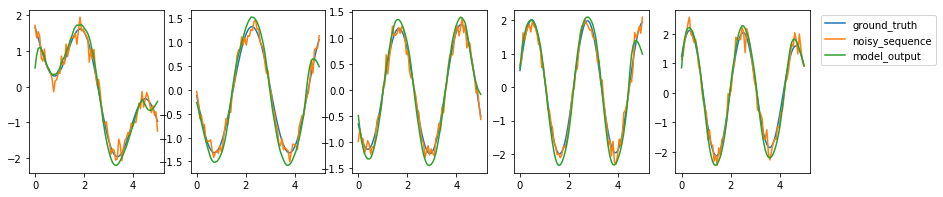

-20.70% of noise removed.
epoch: 29, validation loss:153.8345489501953


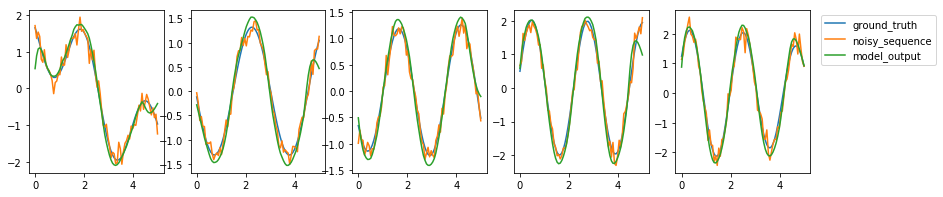

-14.69% of noise removed.
epoch: 30, validation loss:181.51995849609375


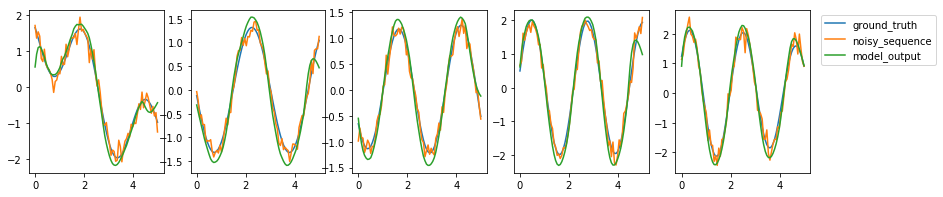

-29.87% of noise removed.
epoch: 31, validation loss:164.84912109375


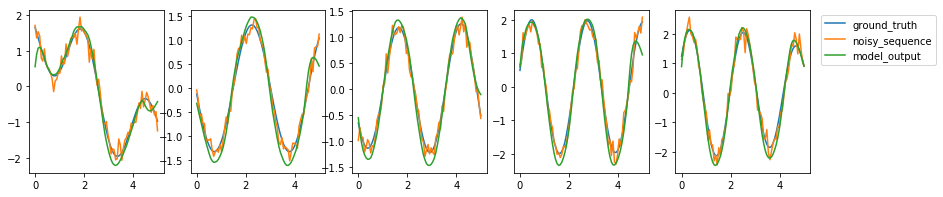

-18.89% of noise removed.
epoch: 32, validation loss:131.90036010742188


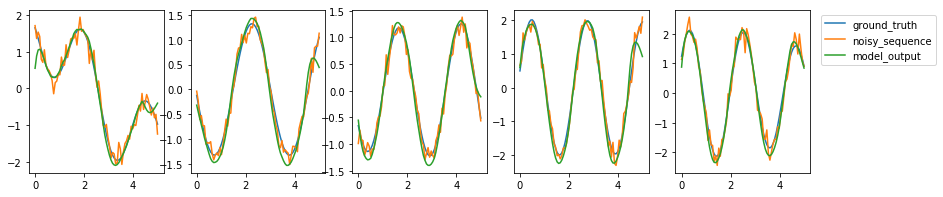

1.62% of noise removed.
epoch: 33, validation loss:106.70365905761719


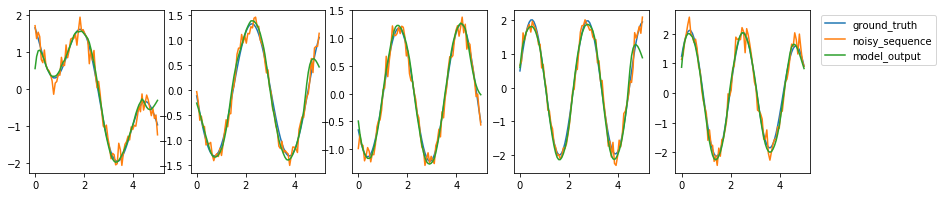

20.35% of noise removed.
epoch: 34, validation loss:215.75088500976562


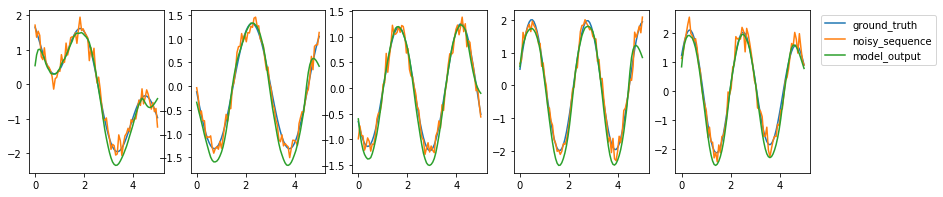

-29.14% of noise removed.
epoch: 35, validation loss:162.614990234375


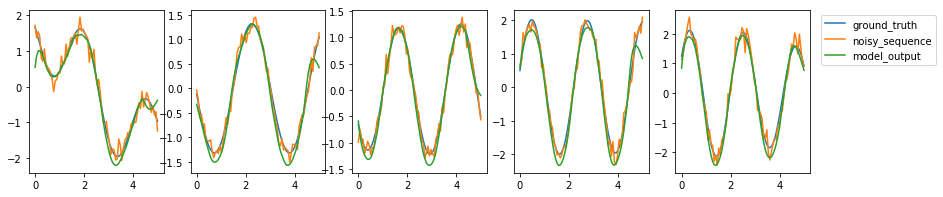

-7.98% of noise removed.
epoch: 36, validation loss:128.2152862548828


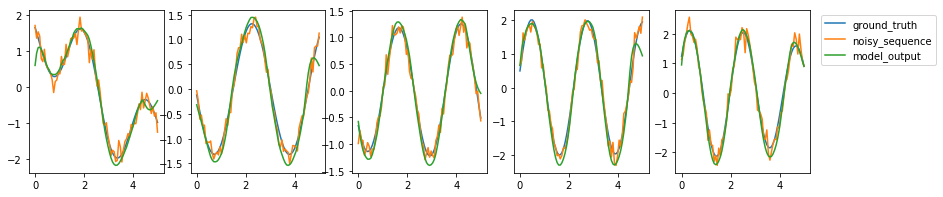

3.00% of noise removed.
epoch: 37, validation loss:137.03770446777344


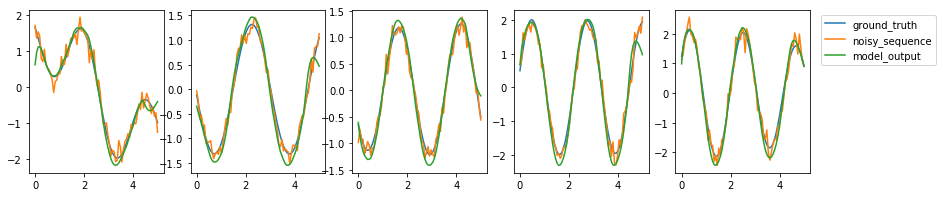

-4.07% of noise removed.
epoch: 38, validation loss:143.2144317626953


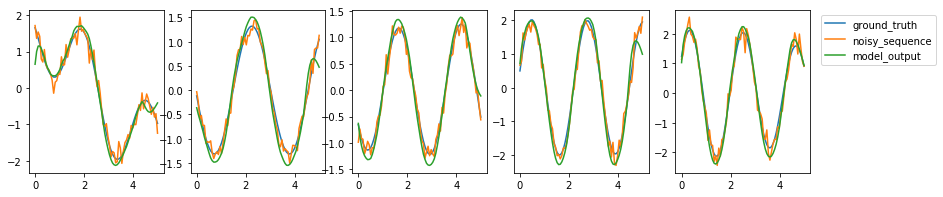

-11.53% of noise removed.
epoch: 39, validation loss:147.1931610107422


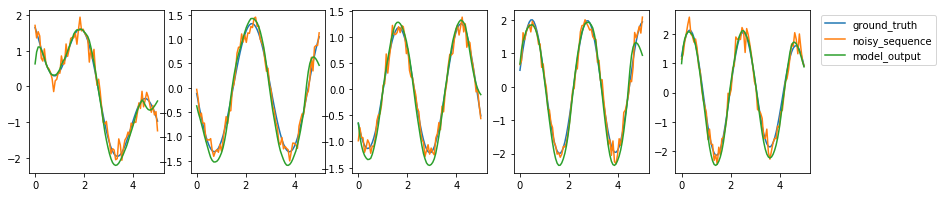

-6.97% of noise removed.
epoch: 40, validation loss:134.4793701171875


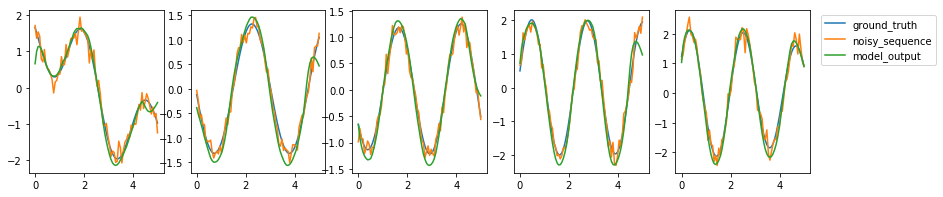

-4.83% of noise removed.
epoch: 41, validation loss:144.5919647216797


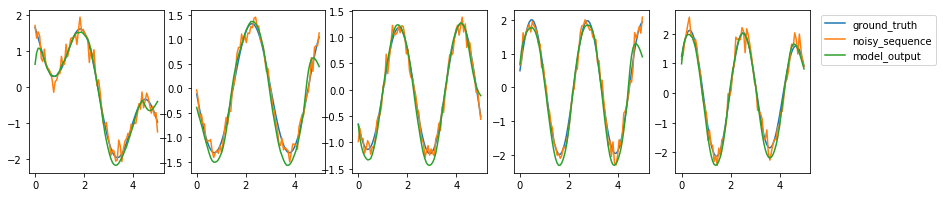

-3.78% of noise removed.
epoch: 42, validation loss:128.50656127929688


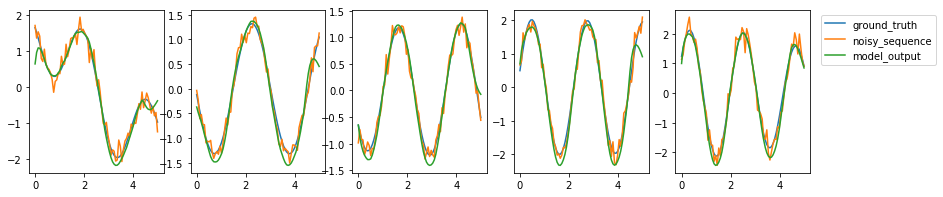

6.53% of noise removed.
epoch: 43, validation loss:120.66514587402344


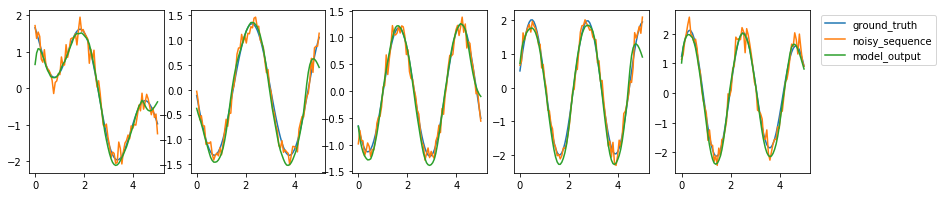

9.85% of noise removed.
epoch: 44, validation loss:115.5341796875


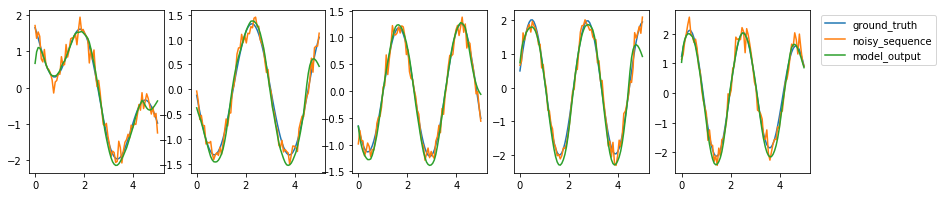

12.76% of noise removed.
epoch: 45, validation loss:120.20433044433594


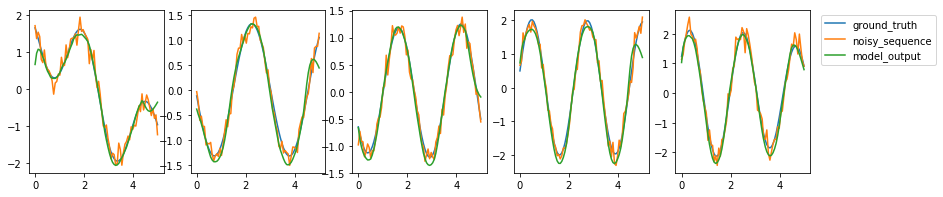

10.81% of noise removed.
epoch: 46, validation loss:104.48265075683594


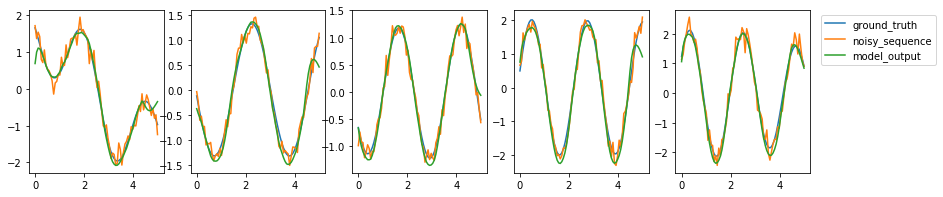

19.99% of noise removed.
epoch: 47, validation loss:116.2602310180664


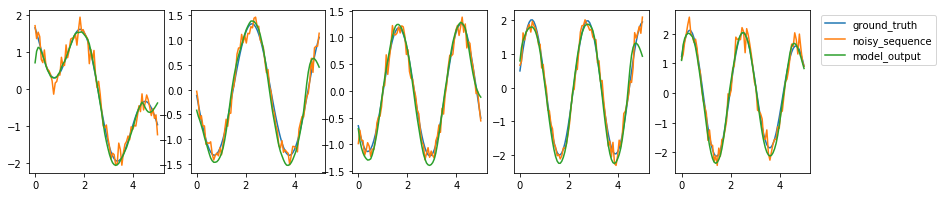

8.50% of noise removed.
epoch: 48, validation loss:111.25831604003906


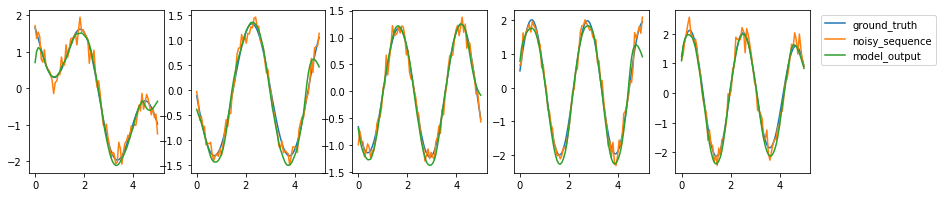

15.64% of noise removed.
epoch: 49, validation loss:103.88019561767578


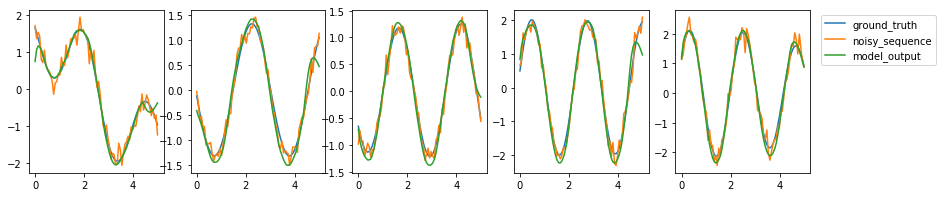

13.75% of noise removed.
epoch: 50, validation loss:121.21216583251953


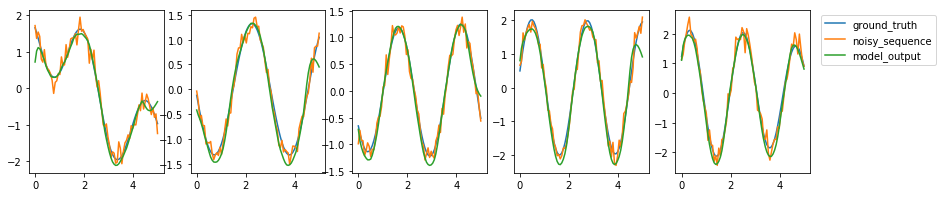

9.07% of noise removed.
epoch: 51, validation loss:118.17760467529297


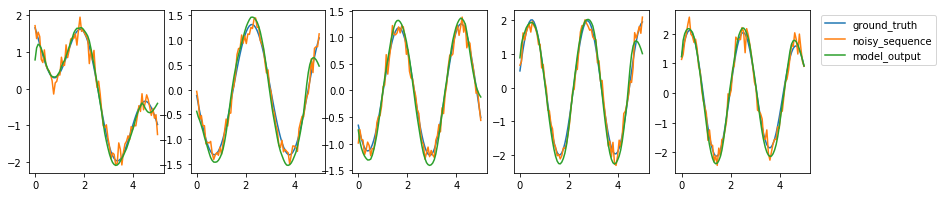

1.65% of noise removed.
epoch: 52, validation loss:116.04379272460938


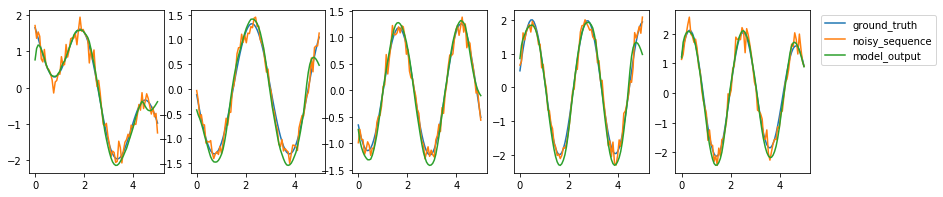

7.60% of noise removed.
epoch: 53, validation loss:101.7012710571289


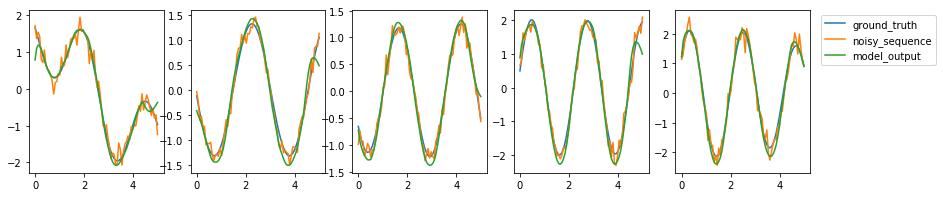

15.62% of noise removed.
epoch: 54, validation loss:101.11048126220703


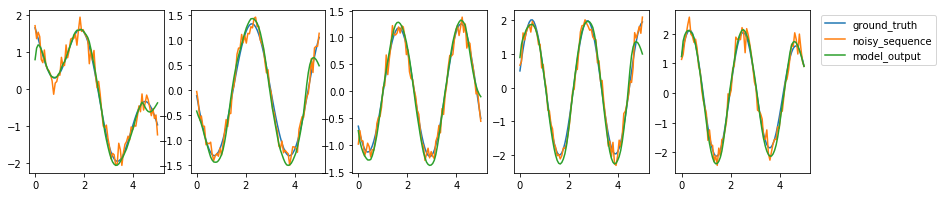

14.80% of noise removed.
epoch: 55, validation loss:102.60383605957031


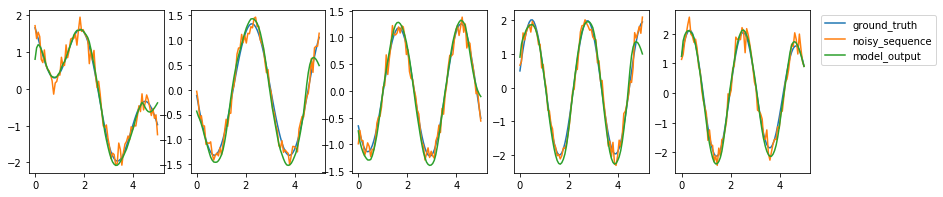

13.49% of noise removed.
epoch: 56, validation loss:100.2760009765625


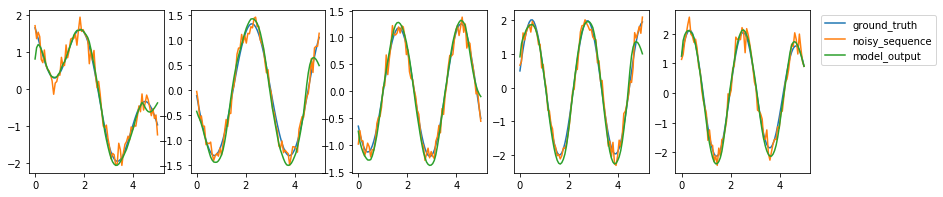

15.06% of noise removed.
epoch: 57, validation loss:99.49903106689453


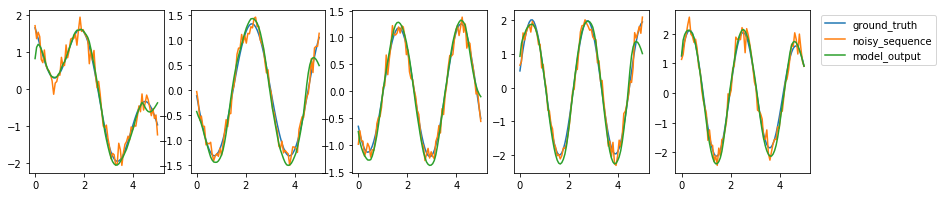

15.41% of noise removed.
epoch: 58, validation loss:99.83229064941406


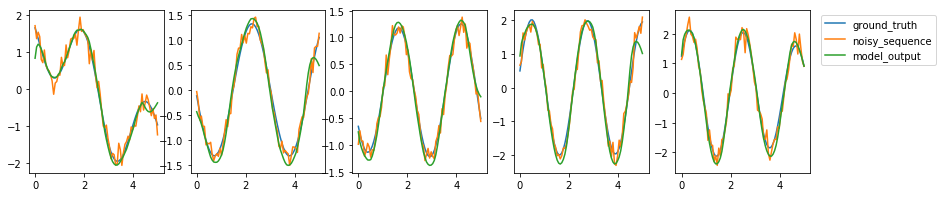

15.21% of noise removed.
epoch: 59, validation loss:99.2448501586914


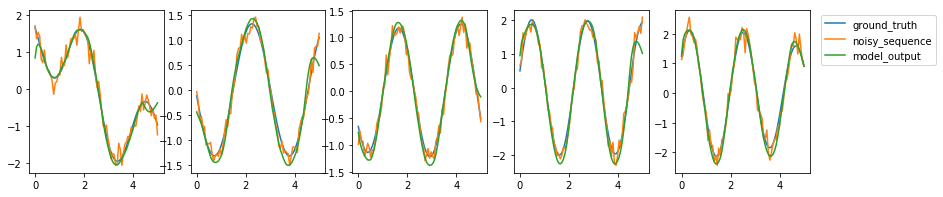

15.66% of noise removed.
epoch: 60, validation loss:98.0407943725586


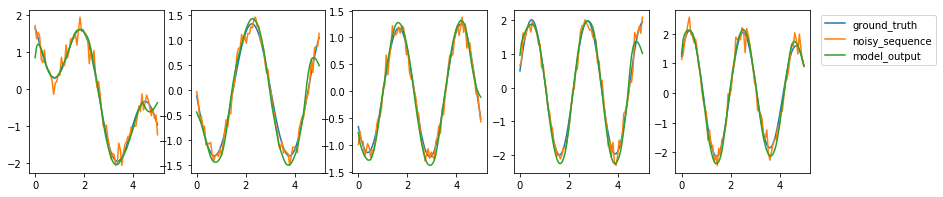

16.39% of noise removed.
epoch: 61, validation loss:96.83004760742188


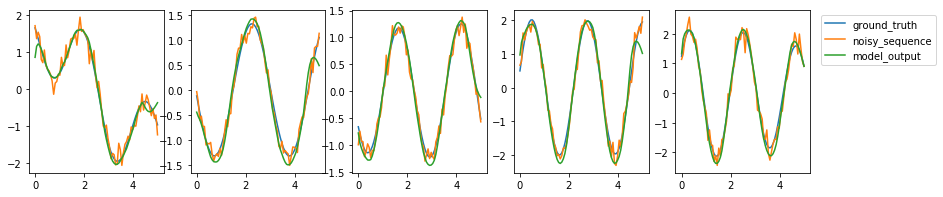

17.08% of noise removed.
epoch: 62, validation loss:95.7328872680664


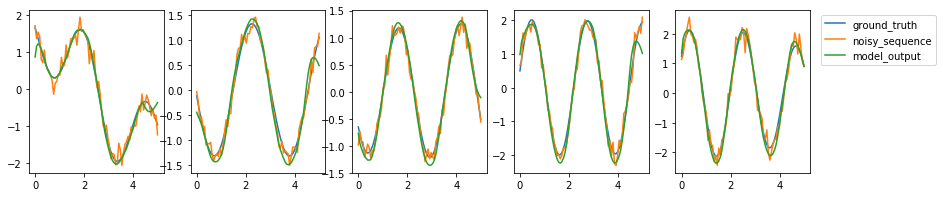

17.71% of noise removed.
epoch: 63, validation loss:94.7526626586914


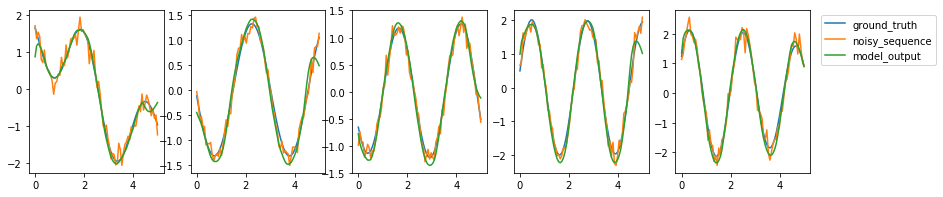

18.32% of noise removed.
epoch: 64, validation loss:93.69759368896484


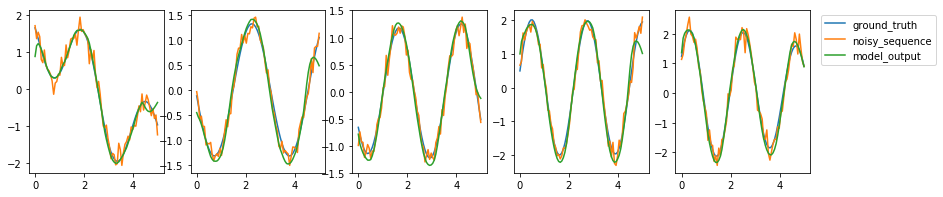

18.99% of noise removed.
epoch: 65, validation loss:92.17990112304688


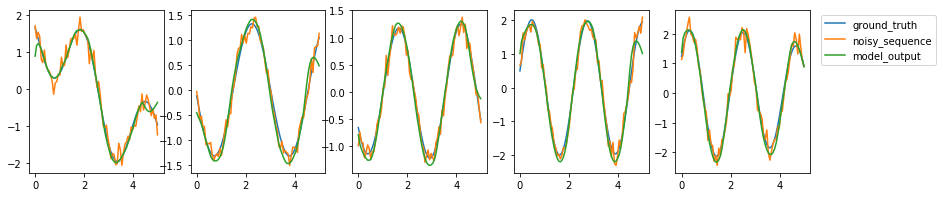

20.03% of noise removed.
epoch: 66, validation loss:89.99790954589844


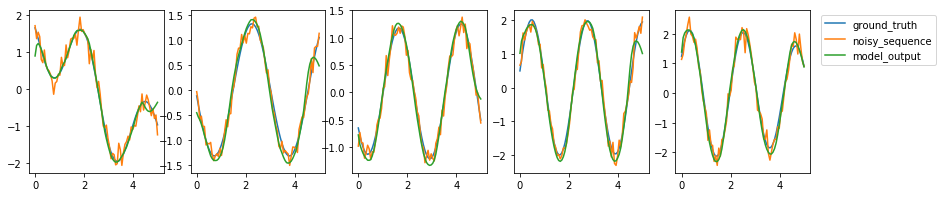

21.61% of noise removed.
epoch: 67, validation loss:87.4695816040039


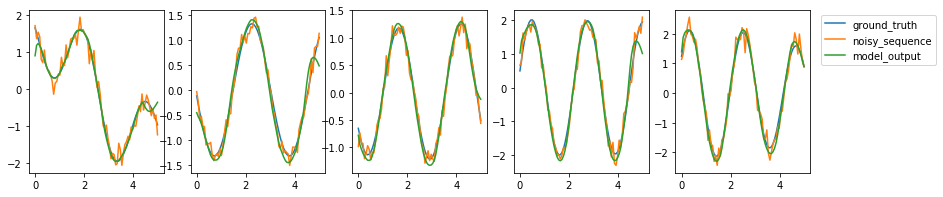

23.52% of noise removed.
epoch: 68, validation loss:85.04215240478516


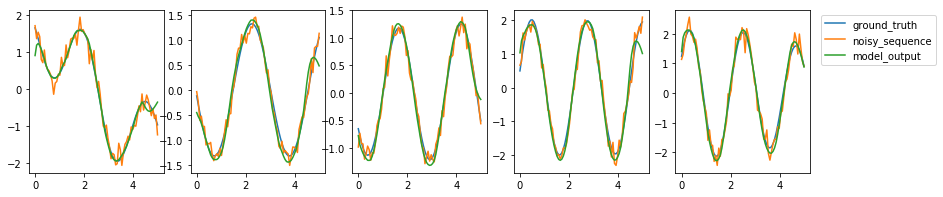

25.47% of noise removed.
epoch: 69, validation loss:82.90243530273438


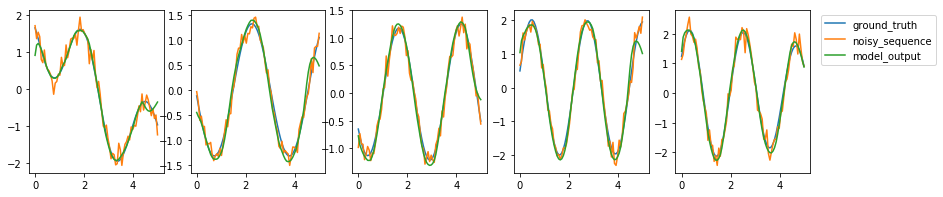

27.26% of noise removed.
epoch: 70, validation loss:81.02869415283203


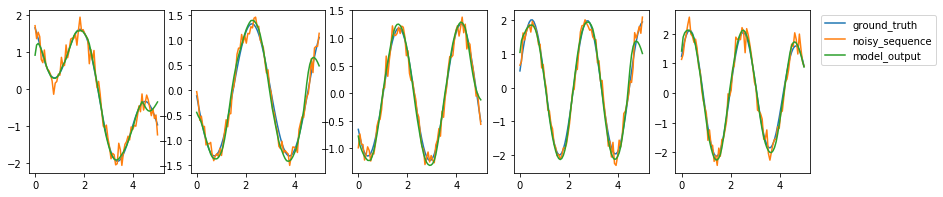

28.87% of noise removed.
epoch: 71, validation loss:79.3568344116211


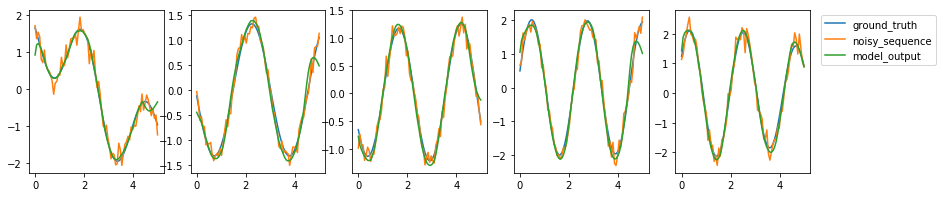

30.32% of noise removed.
epoch: 72, validation loss:77.84829711914062


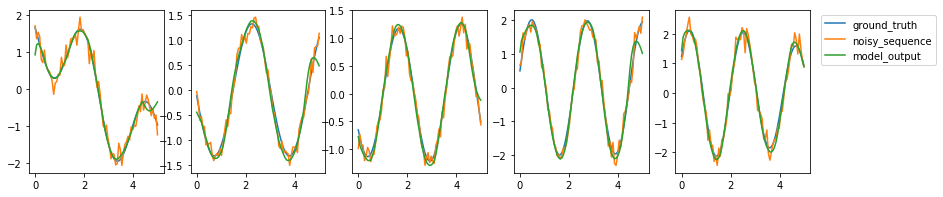

31.67% of noise removed.
epoch: 73, validation loss:76.48761749267578


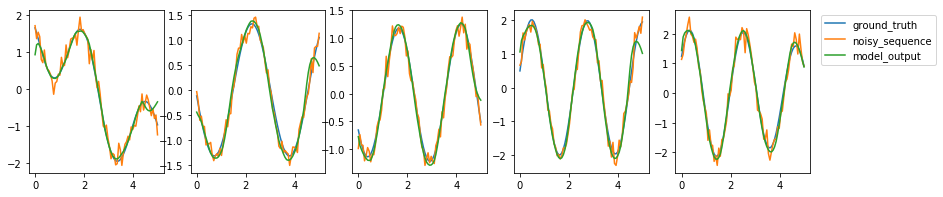

32.90% of noise removed.
epoch: 74, validation loss:75.26596069335938


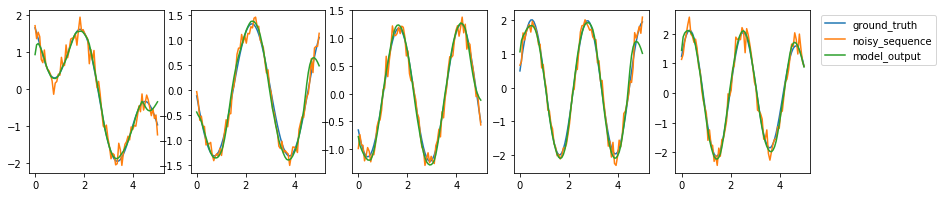

34.01% of noise removed.
epoch: 75, validation loss:74.17918395996094


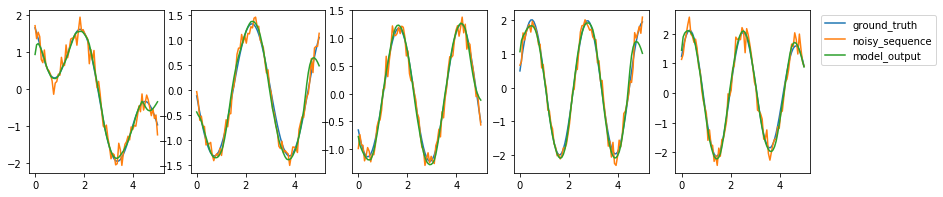

35.00% of noise removed.
epoch: 76, validation loss:73.232421875


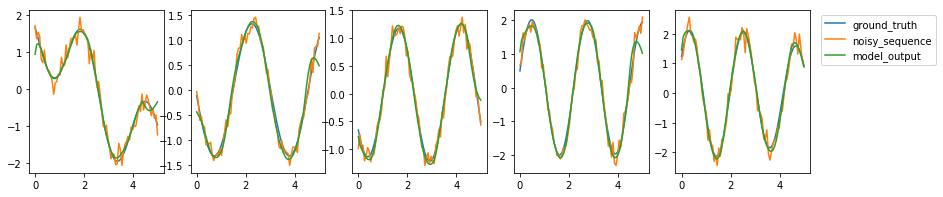

35.87% of noise removed.
epoch: 77, validation loss:72.44435119628906


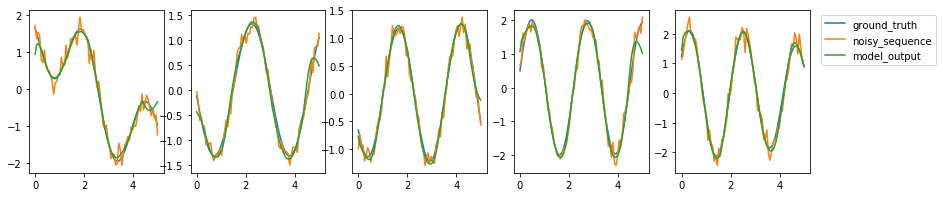

36.63% of noise removed.
epoch: 78, validation loss:71.85527038574219


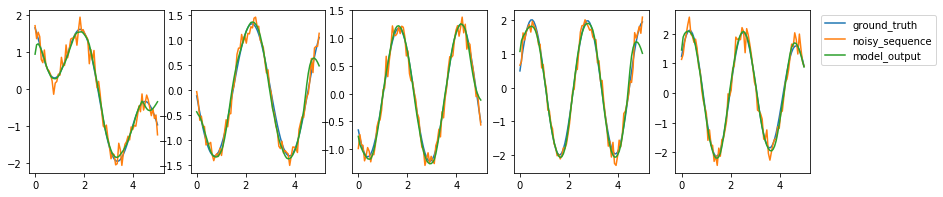

37.22% of noise removed.
epoch: 79, validation loss:71.53824615478516


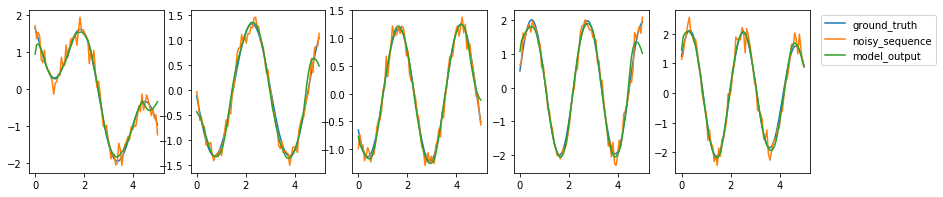

37.62% of noise removed.
epoch: 80, validation loss:71.58162689208984


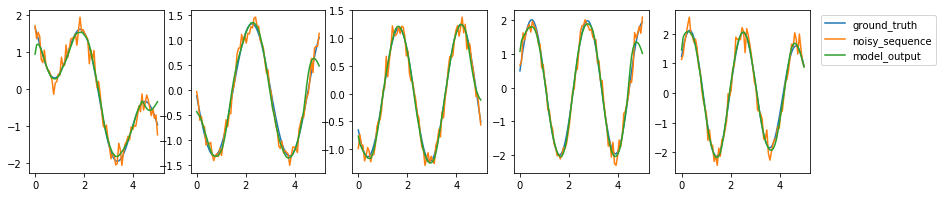

37.74% of noise removed.
epoch: 81, validation loss:71.94190216064453


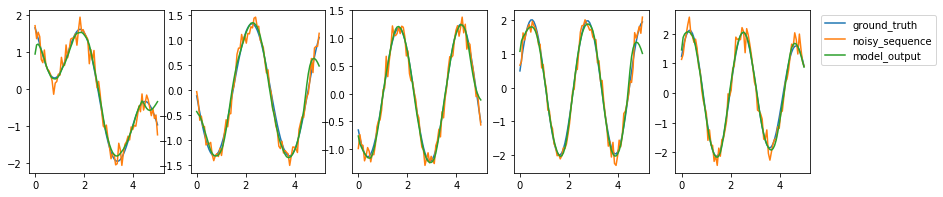

37.47% of noise removed.
epoch: 82, validation loss:72.12724304199219


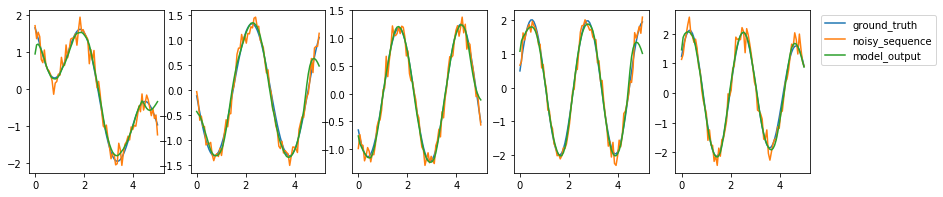

37.26% of noise removed.
epoch: 83, validation loss:71.43570709228516


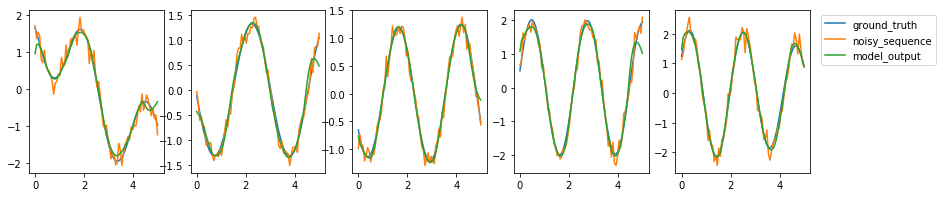

37.72% of noise removed.
epoch: 84, validation loss:70.31825256347656


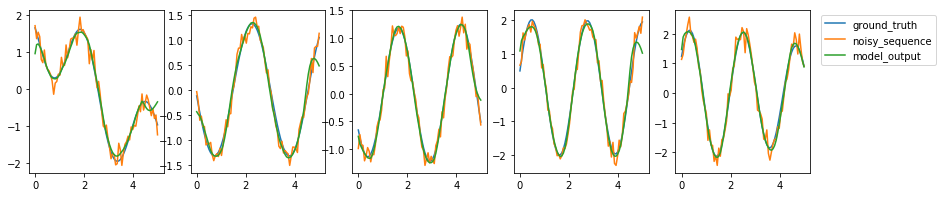

38.52% of noise removed.
epoch: 85, validation loss:69.51583862304688


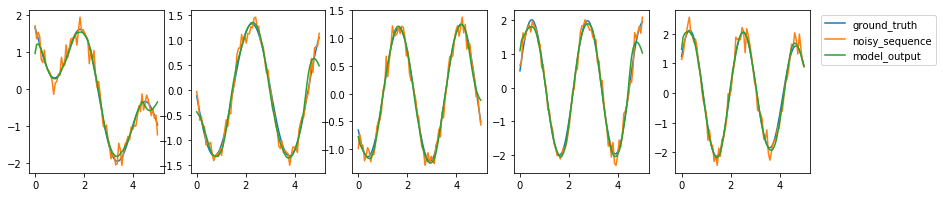

39.04% of noise removed.
epoch: 86, validation loss:68.8962173461914


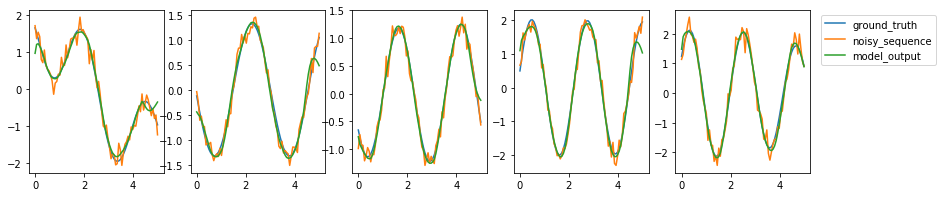

39.39% of noise removed.
epoch: 87, validation loss:68.29202270507812


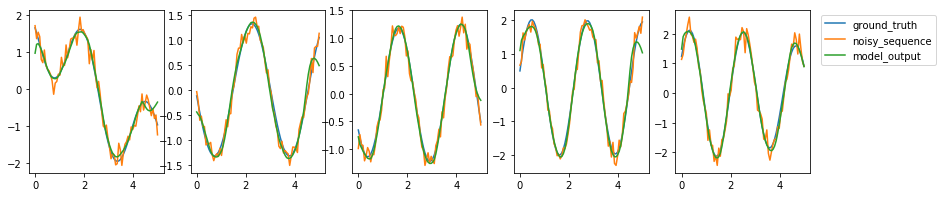

39.69% of noise removed.
epoch: 88, validation loss:67.61898803710938


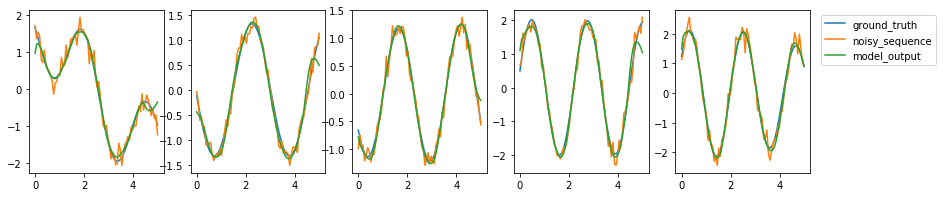

40.03% of noise removed.
epoch: 89, validation loss:66.86994171142578


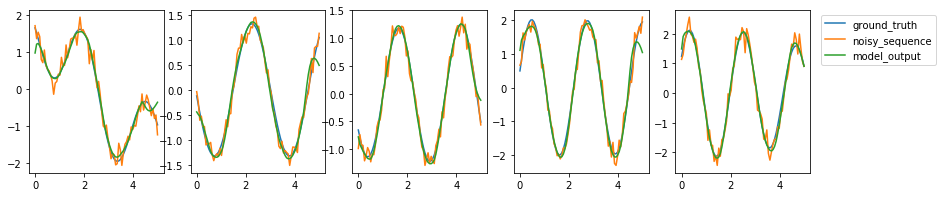

40.41% of noise removed.
epoch: 90, validation loss:66.17741394042969


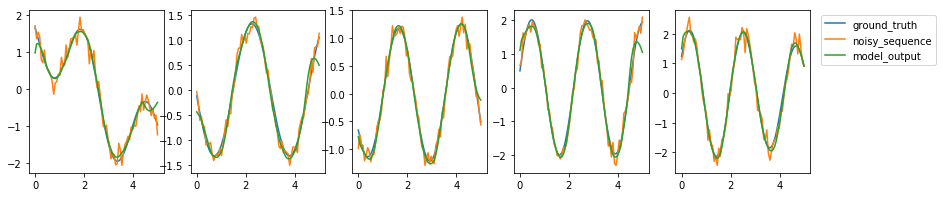

40.69% of noise removed.
epoch: 91, validation loss:65.6944580078125


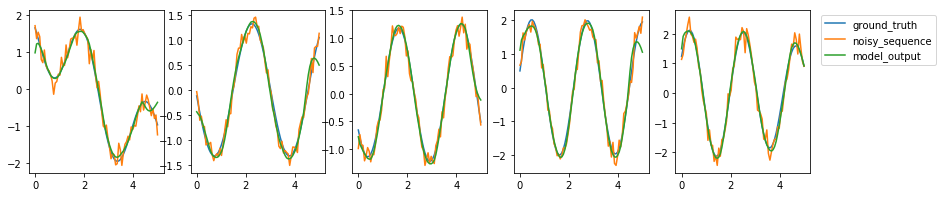

40.76% of noise removed.
epoch: 92, validation loss:65.45040893554688


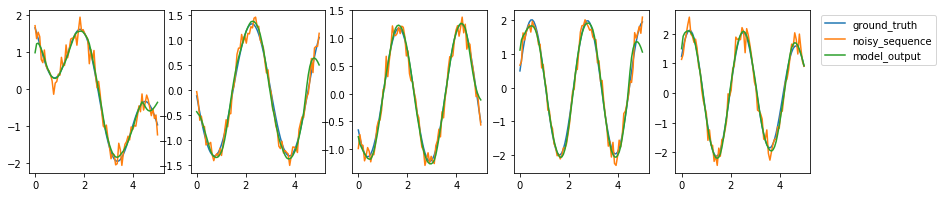

40.65% of noise removed.
epoch: 93, validation loss:65.34628295898438


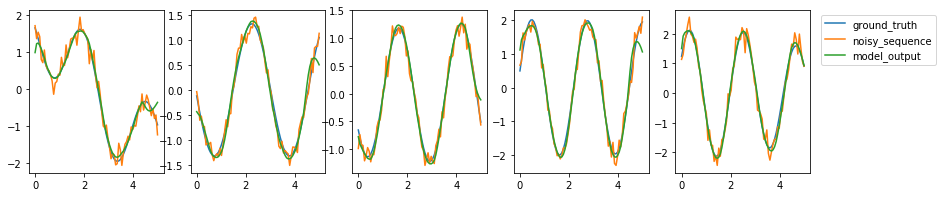

40.47% of noise removed.
epoch: 94, validation loss:65.23185729980469


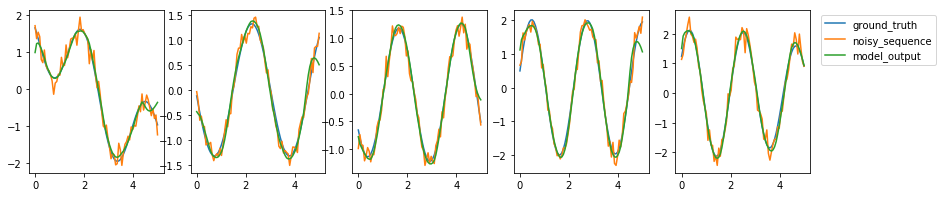

40.42% of noise removed.
epoch: 95, validation loss:65.06810760498047


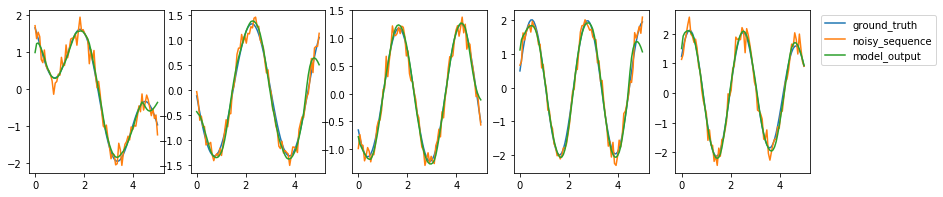

40.52% of noise removed.
epoch: 96, validation loss:64.92802429199219


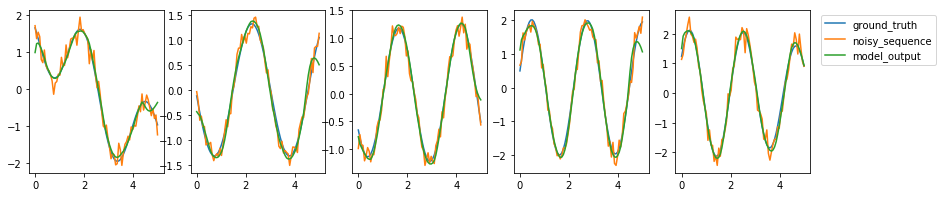

40.65% of noise removed.
epoch: 97, validation loss:64.83598327636719


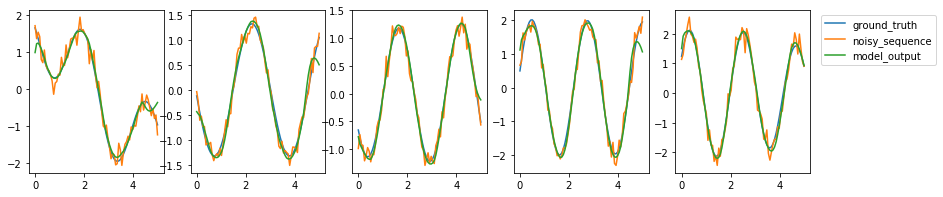

40.76% of noise removed.
epoch: 98, validation loss:64.77882385253906


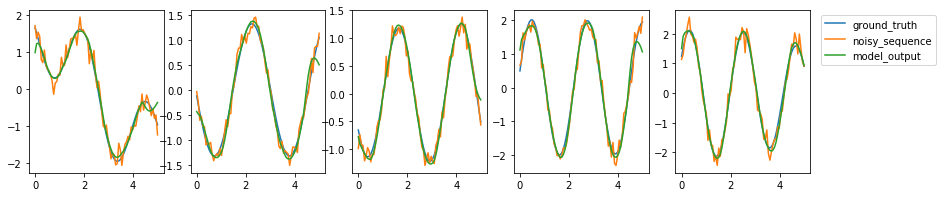

40.83% of noise removed.
epoch: 99, validation loss:64.7462387084961


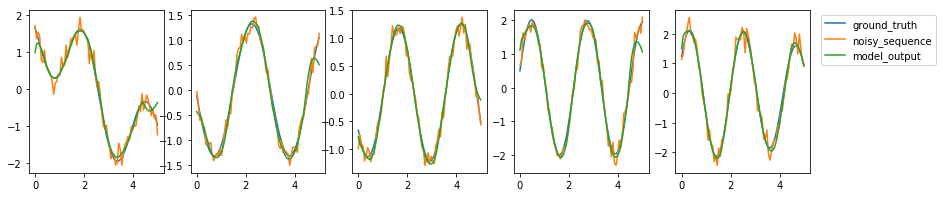

40.87% of noise removed.
epoch: 100, validation loss:64.73095703125


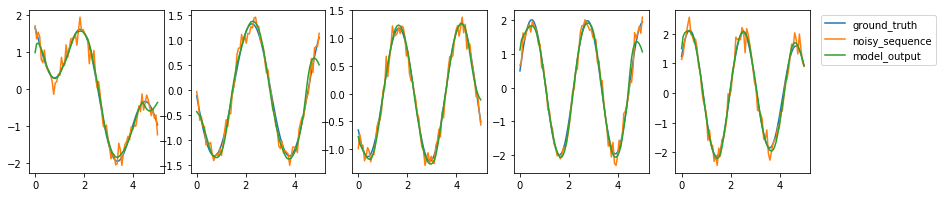

40.90% of noise removed.


In [11]:
batch_size = 20
num_epochs = 101

model = NoiseRemovalModel(hidden_size=40, shift=10)
optimizer = optim.Adam(model.parameters(), lr=0.005, betas=(0.6, 0.87))
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)
print("cuda avialable :", torch.cuda.is_available())
# this should remove ~32% of the noise
train(model, optimizer, scheduler, num_epochs, batch_size)

## Hyperparameter Optimization
As a preparation for next week's lecture, play with the model's hyperparameters and try to improve the amount of noise removed. List at least three different configurations you have tried and the respective percentage of noise removed. Make sure to always create a new model and that you train and validate on the same data!

| configuration        | Noise removed in percent |
| -------------------- | -----------------------: |
| initial configuration| 32.52% -> 40.90%         |
| batch_size = 10      | 53.07%                   |
| learning_rate = 0.001| 31.73%                   |

cuda avialable : False
epoch: 0, validation loss:907.3182373046875


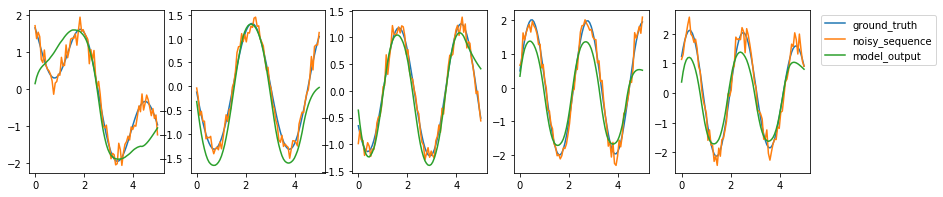

-199.38% of noise removed.
epoch: 1, validation loss:770.273193359375


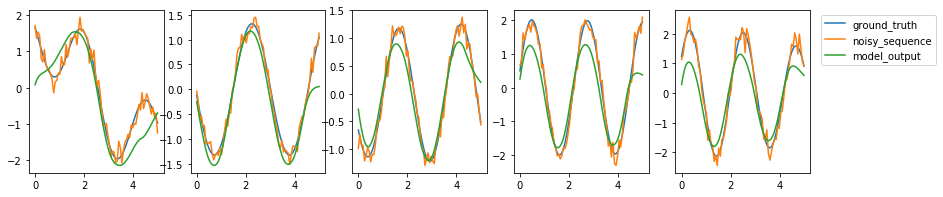

-160.59% of noise removed.
epoch: 2, validation loss:626.0784912109375


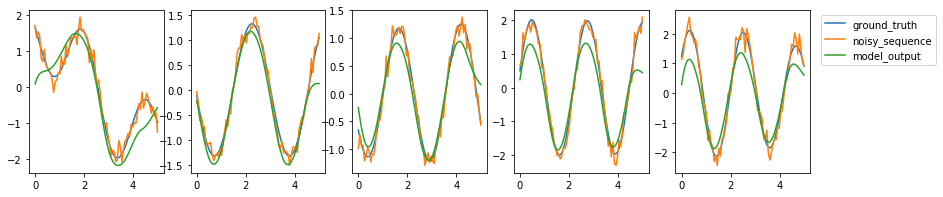

-128.28% of noise removed.
epoch: 3, validation loss:300.0476989746094


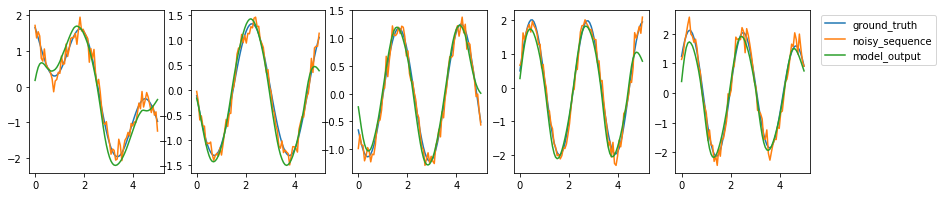

-46.42% of noise removed.
epoch: 4, validation loss:268.7820129394531


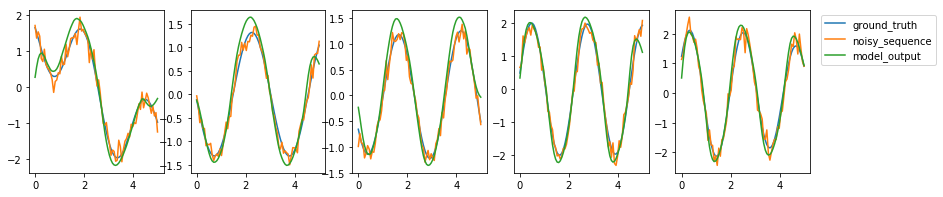

-55.78% of noise removed.
epoch: 5, validation loss:310.20361328125


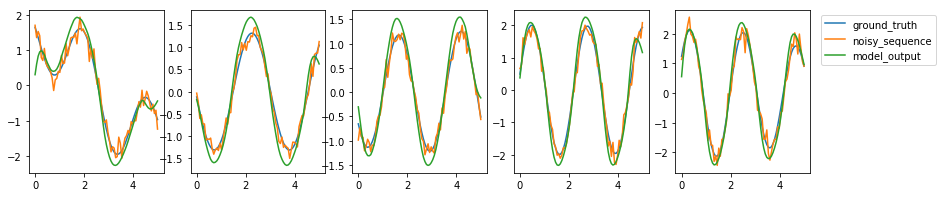

-72.74% of noise removed.
epoch: 6, validation loss:268.3553161621094


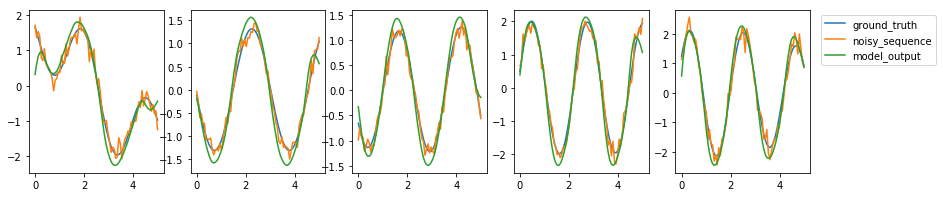

-54.51% of noise removed.
epoch: 7, validation loss:229.55020141601562


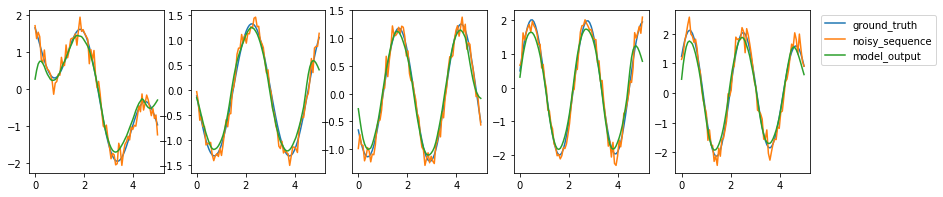

-24.88% of noise removed.
epoch: 8, validation loss:204.31854248046875


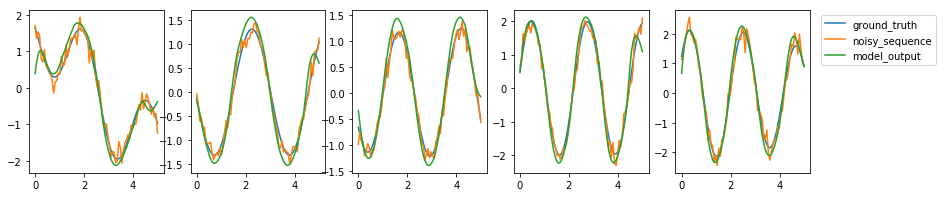

-35.03% of noise removed.
epoch: 9, validation loss:170.7988739013672


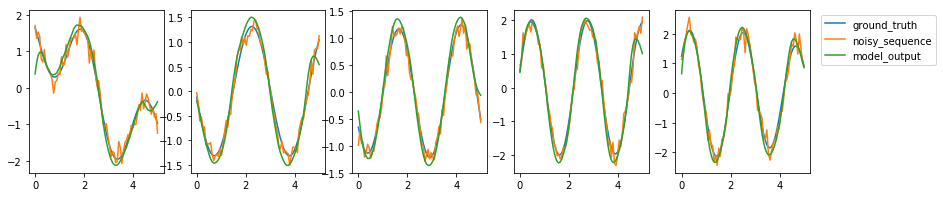

-16.73% of noise removed.
epoch: 10, validation loss:188.79550170898438


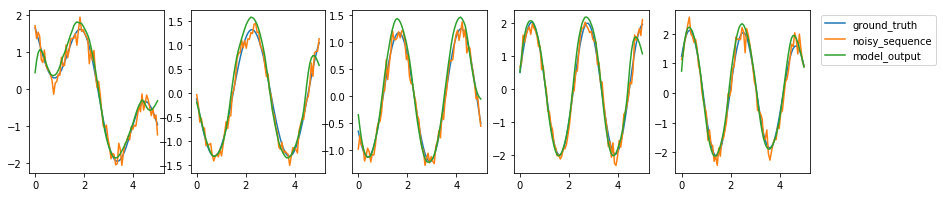

-25.33% of noise removed.
epoch: 11, validation loss:141.37307739257812


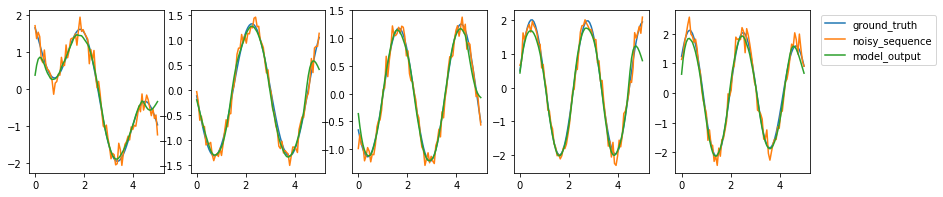

15.40% of noise removed.
epoch: 12, validation loss:164.69644165039062


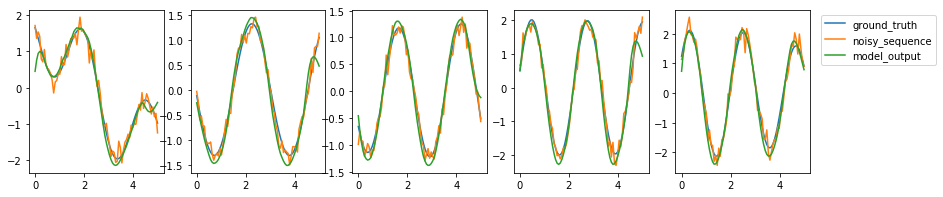

-9.55% of noise removed.
epoch: 13, validation loss:179.99697875976562


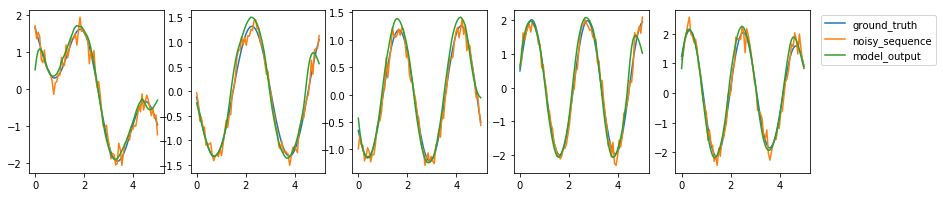

-22.35% of noise removed.
epoch: 14, validation loss:220.71002197265625


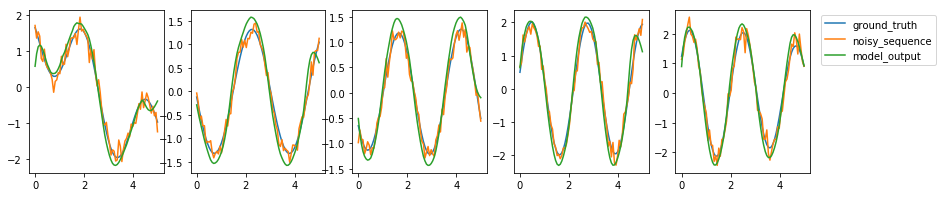

-46.10% of noise removed.
epoch: 15, validation loss:258.6059875488281


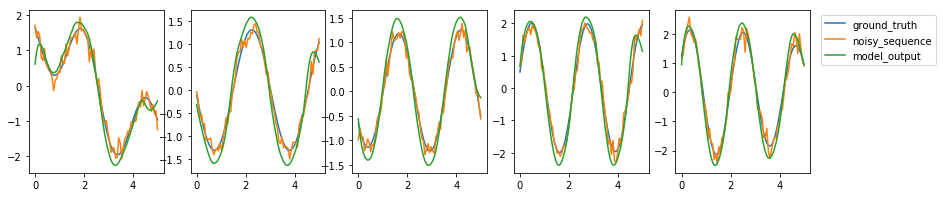

-62.10% of noise removed.
epoch: 16, validation loss:248.85023498535156


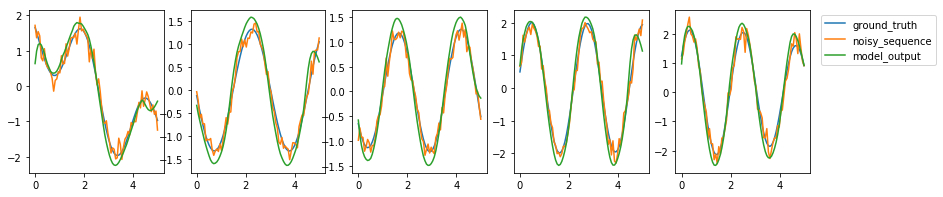

-58.29% of noise removed.
epoch: 17, validation loss:203.83984375


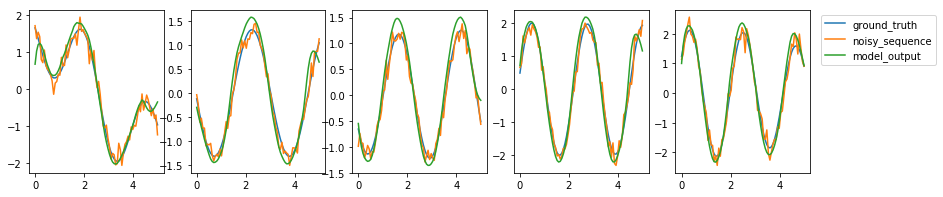

-39.41% of noise removed.
epoch: 18, validation loss:210.46463012695312


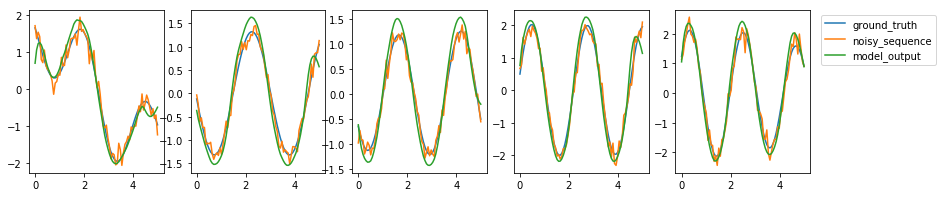

-47.63% of noise removed.
epoch: 19, validation loss:118.19364166259766


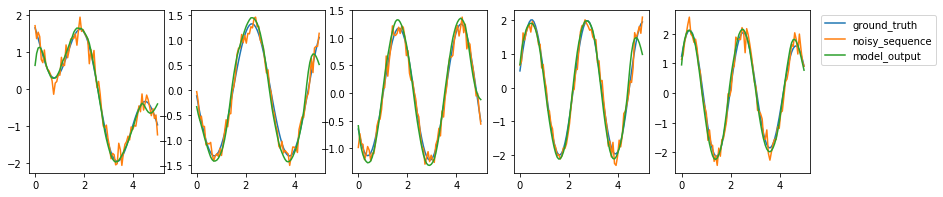

7.20% of noise removed.
epoch: 20, validation loss:93.45381927490234


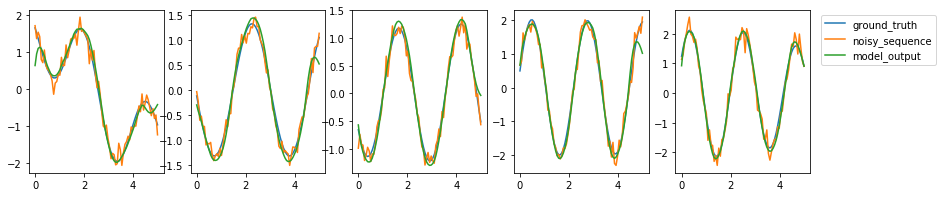

21.58% of noise removed.
epoch: 21, validation loss:140.21788024902344


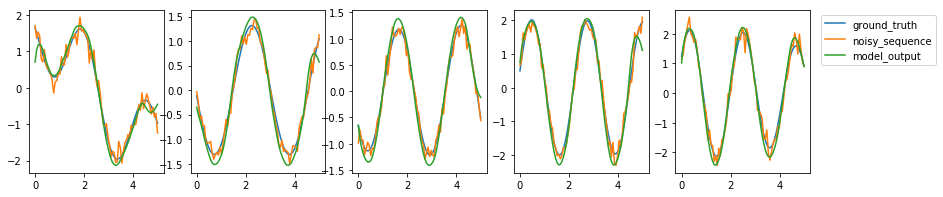

-12.84% of noise removed.
epoch: 22, validation loss:101.8782958984375


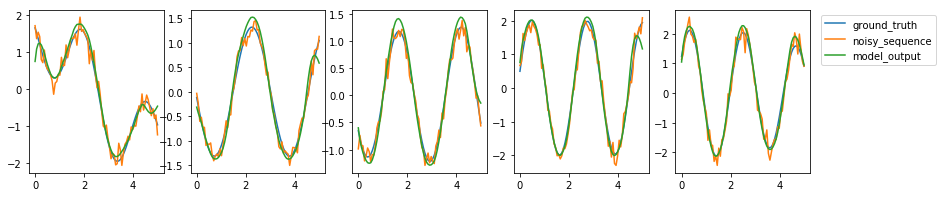

11.09% of noise removed.
epoch: 23, validation loss:129.93215942382812


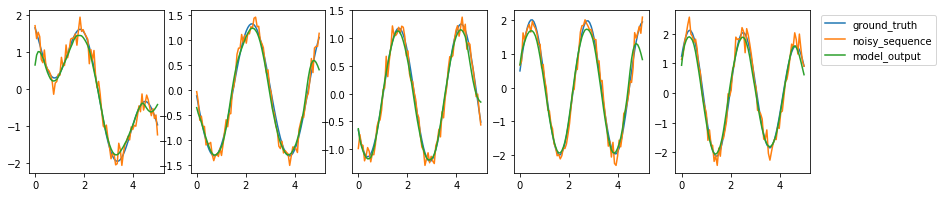

7.34% of noise removed.
epoch: 24, validation loss:112.21946716308594


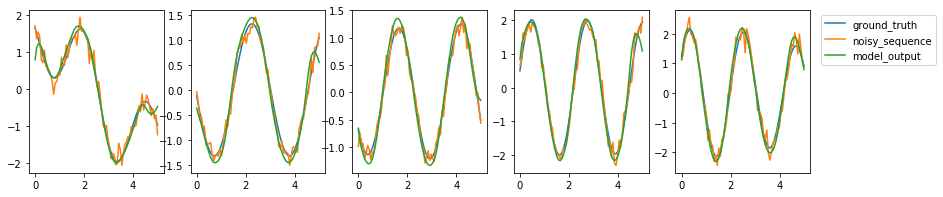

2.59% of noise removed.
epoch: 25, validation loss:89.82884979248047


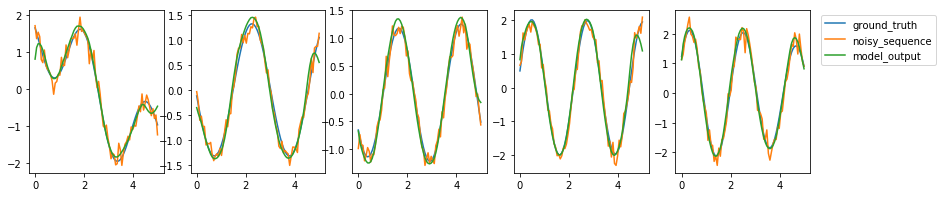

19.61% of noise removed.
epoch: 26, validation loss:100.47986602783203


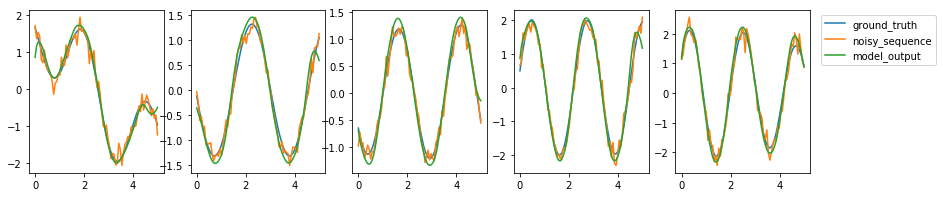

6.16% of noise removed.
epoch: 27, validation loss:113.01408386230469


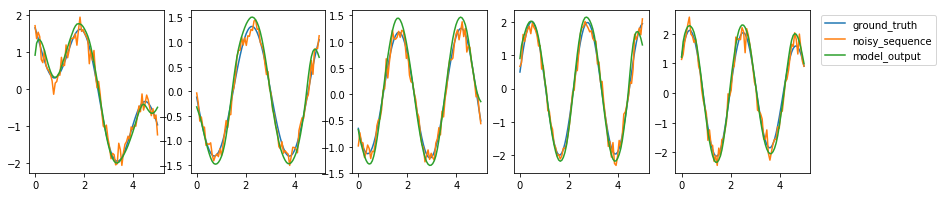

-5.24% of noise removed.
epoch: 28, validation loss:82.04399108886719


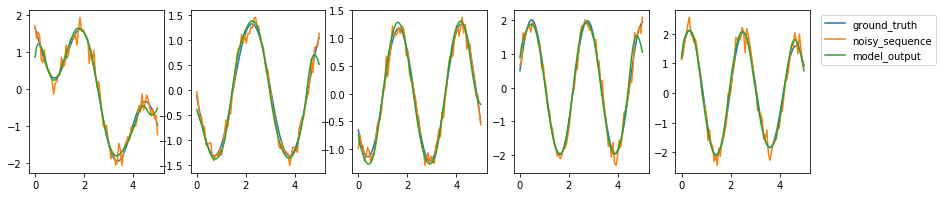

23.28% of noise removed.
epoch: 29, validation loss:81.03526306152344


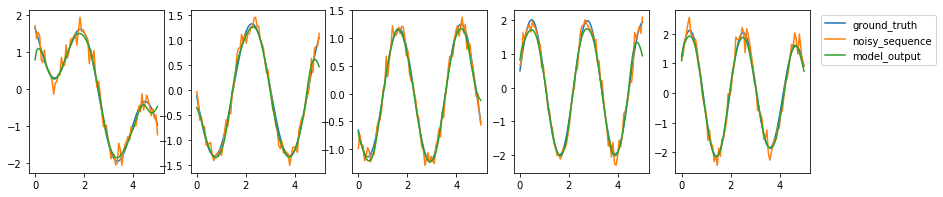

35.13% of noise removed.
epoch: 30, validation loss:80.21076202392578


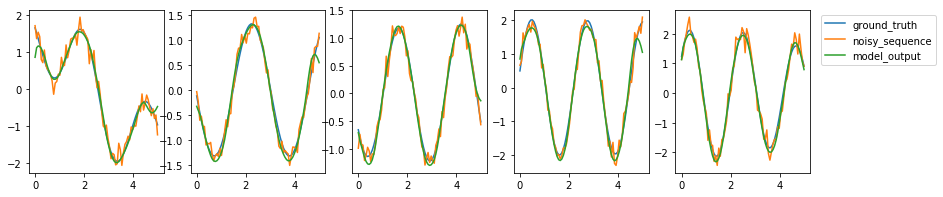

27.52% of noise removed.
epoch: 31, validation loss:93.5102310180664


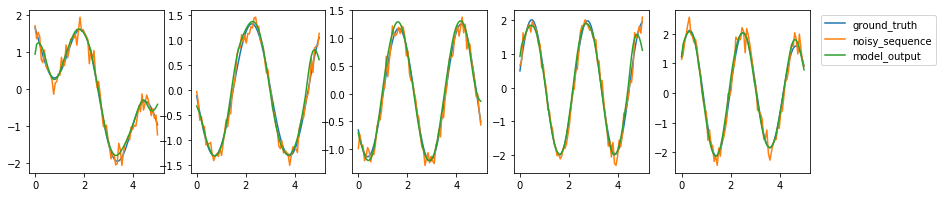

13.18% of noise removed.
epoch: 32, validation loss:77.25615692138672


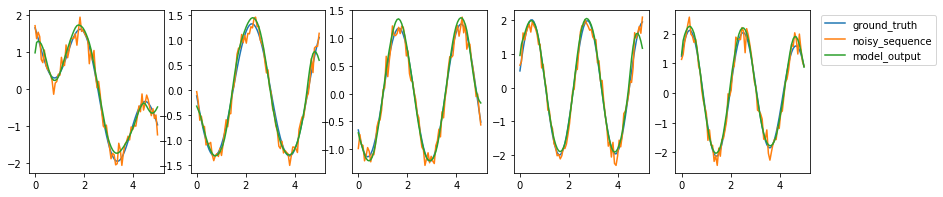

25.19% of noise removed.
epoch: 33, validation loss:95.03374481201172


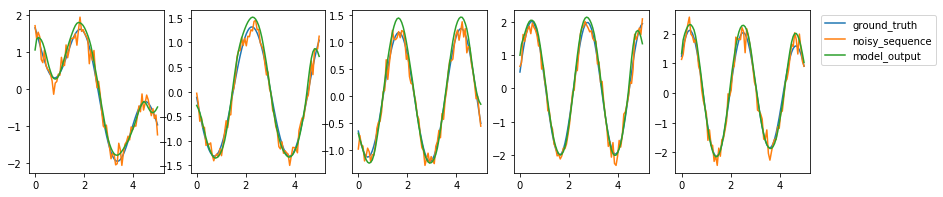

7.36% of noise removed.
epoch: 34, validation loss:66.59070587158203


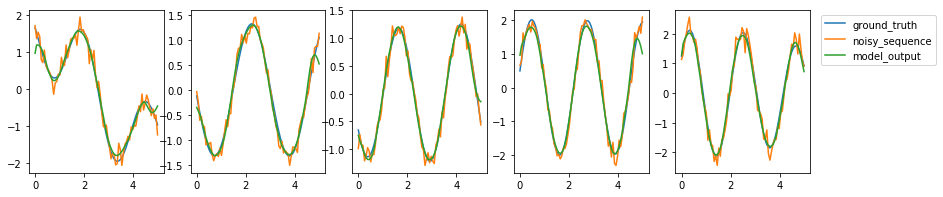

36.90% of noise removed.
epoch: 35, validation loss:60.38273239135742


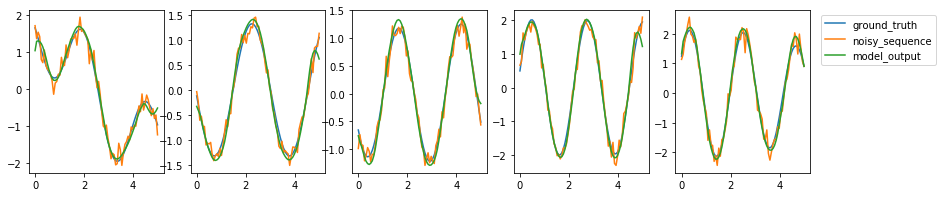

31.87% of noise removed.
epoch: 36, validation loss:64.79537200927734


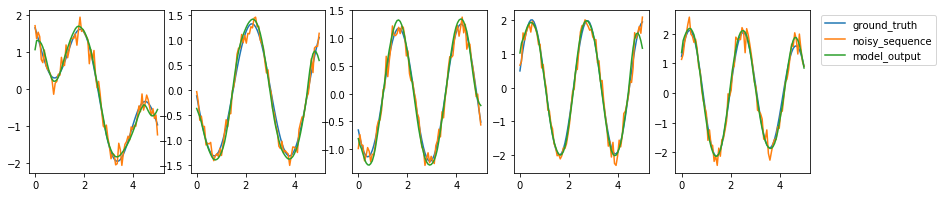

27.89% of noise removed.
epoch: 37, validation loss:63.29704666137695


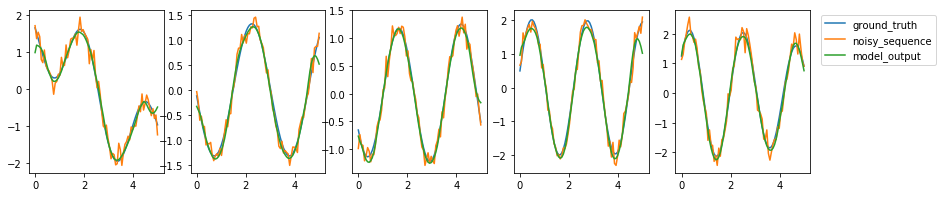

38.30% of noise removed.
epoch: 38, validation loss:50.910240173339844


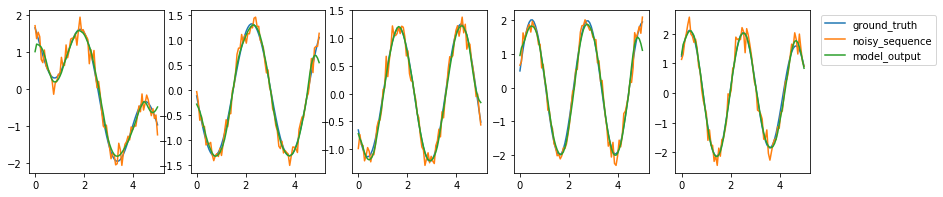

45.91% of noise removed.
epoch: 39, validation loss:83.23967742919922


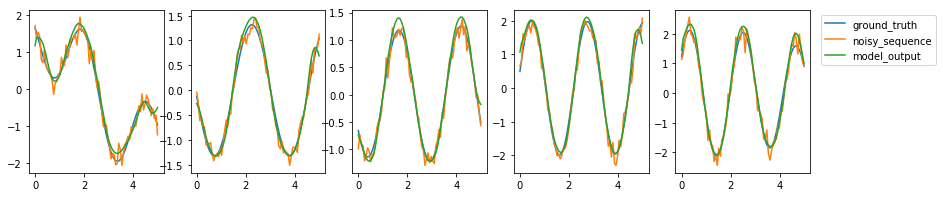

14.70% of noise removed.
epoch: 40, validation loss:56.72593307495117


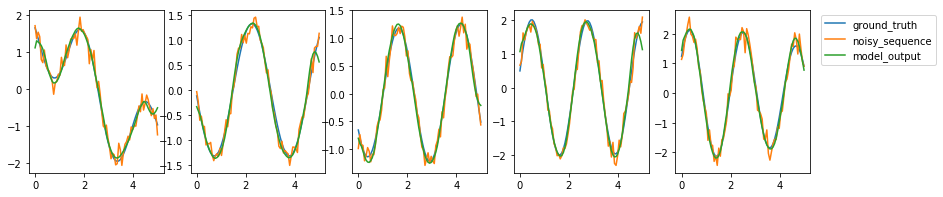

38.61% of noise removed.
epoch: 41, validation loss:52.484859466552734


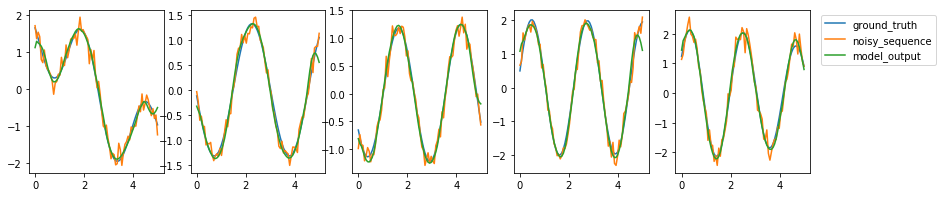

41.82% of noise removed.
epoch: 42, validation loss:53.64275360107422


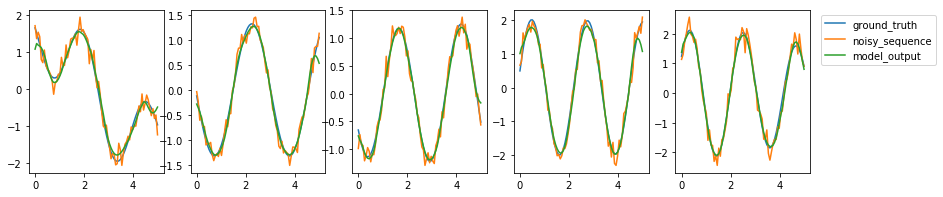

42.86% of noise removed.
epoch: 43, validation loss:51.95974349975586


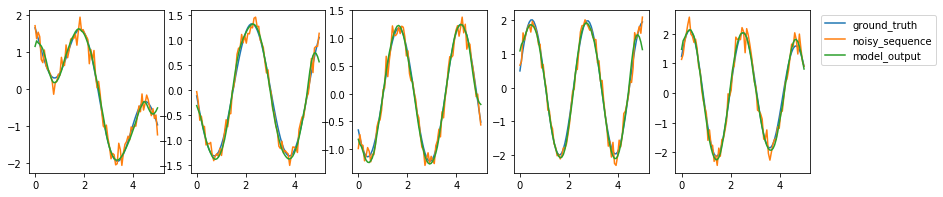

41.19% of noise removed.
epoch: 44, validation loss:46.201019287109375


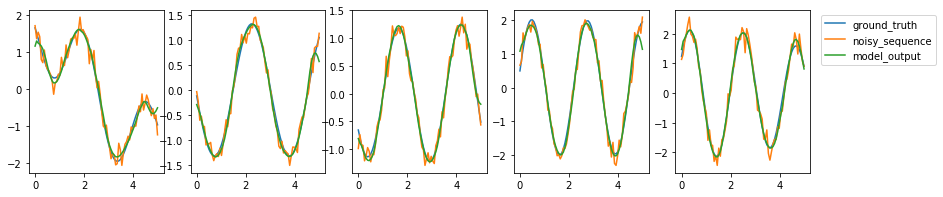

46.88% of noise removed.
epoch: 45, validation loss:51.06655502319336


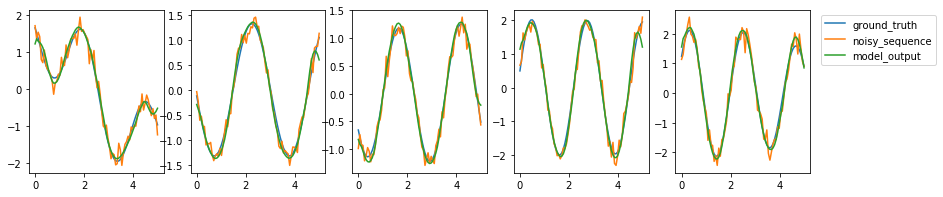

40.08% of noise removed.
epoch: 46, validation loss:51.26982879638672


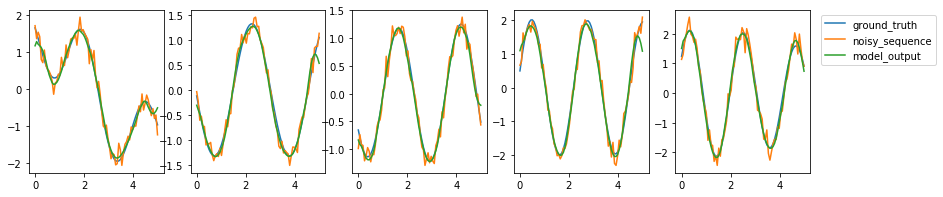

43.68% of noise removed.
epoch: 47, validation loss:49.82151412963867


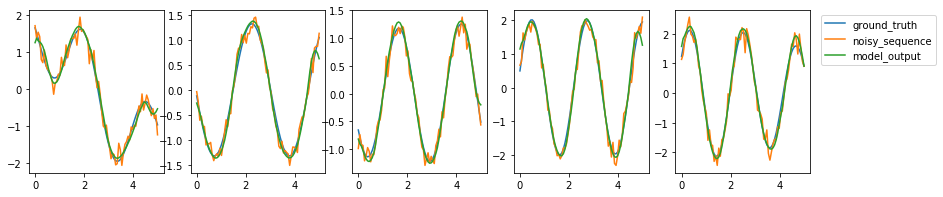

39.92% of noise removed.
epoch: 48, validation loss:49.19254684448242


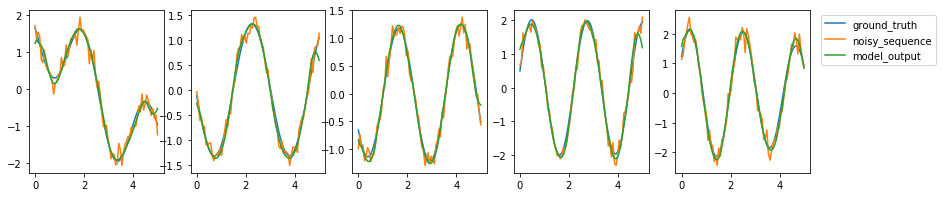

42.39% of noise removed.
epoch: 49, validation loss:47.561038970947266


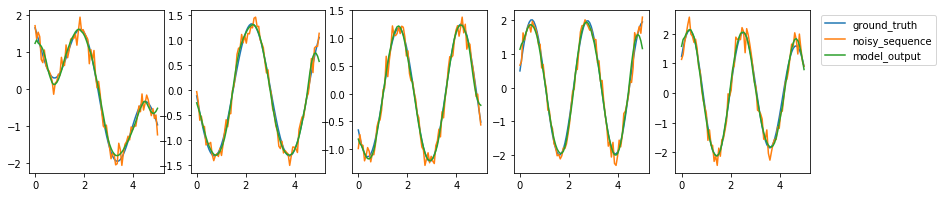

44.84% of noise removed.
epoch: 50, validation loss:49.60667037963867


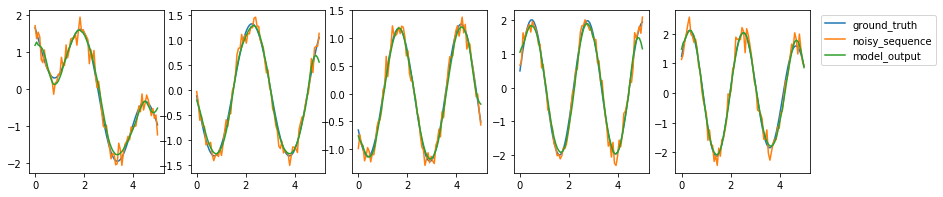

41.87% of noise removed.
epoch: 51, validation loss:47.44826126098633


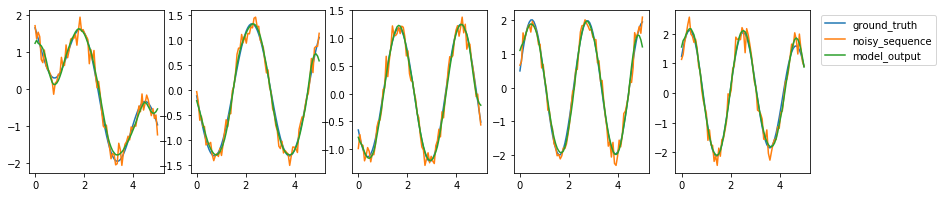

44.44% of noise removed.
epoch: 52, validation loss:50.85762023925781


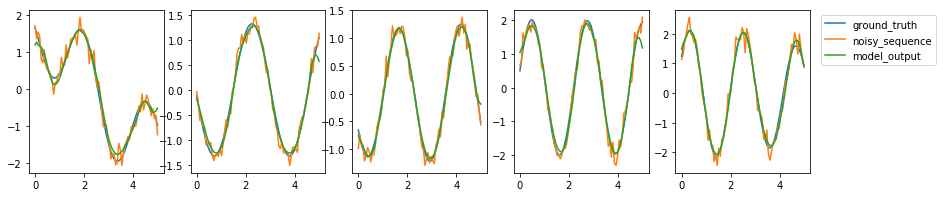

40.07% of noise removed.
epoch: 53, validation loss:51.25729751586914


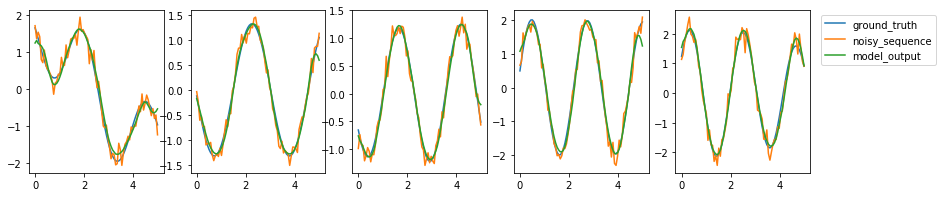

41.16% of noise removed.
epoch: 54, validation loss:49.16469955444336


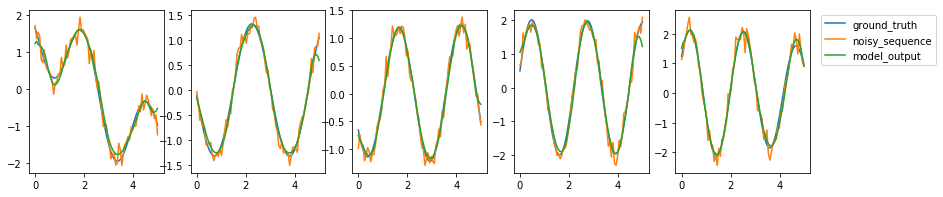

41.12% of noise removed.
epoch: 55, validation loss:52.73624801635742


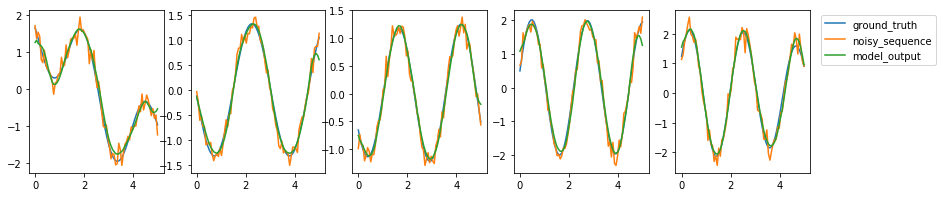

39.17% of noise removed.
epoch: 56, validation loss:51.5001220703125


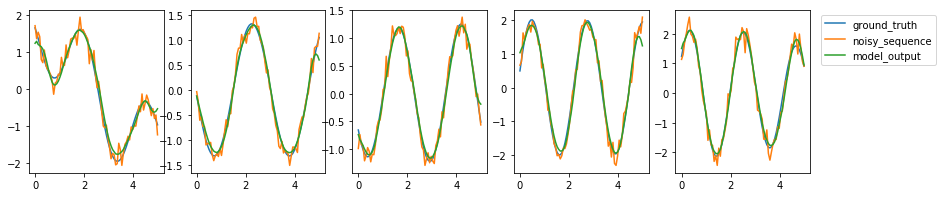

38.49% of noise removed.
epoch: 57, validation loss:53.93737030029297


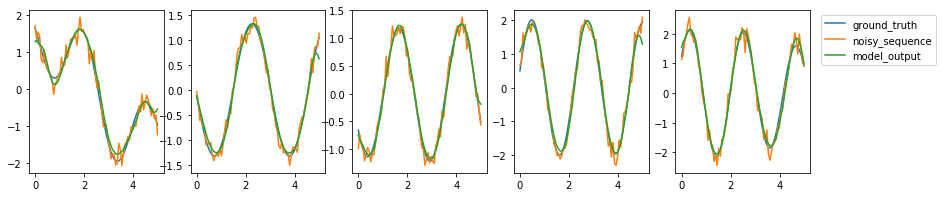

37.14% of noise removed.
epoch: 58, validation loss:51.61338806152344


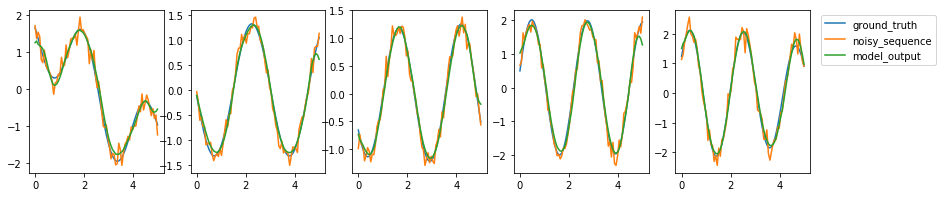

37.61% of noise removed.
epoch: 59, validation loss:53.73324966430664


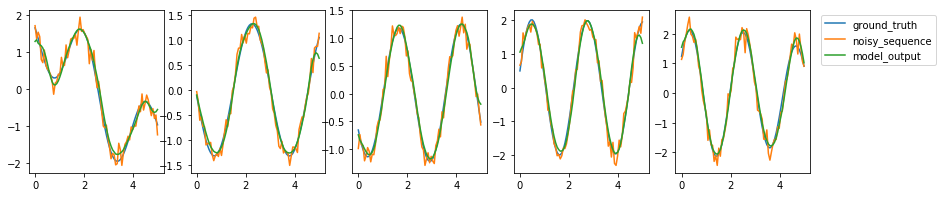

36.38% of noise removed.
epoch: 60, validation loss:51.832679748535156


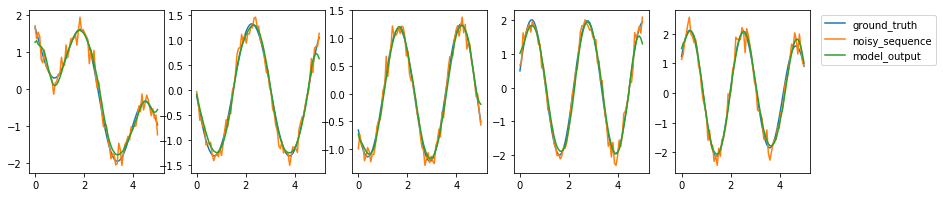

36.72% of noise removed.
epoch: 61, validation loss:54.75657653808594


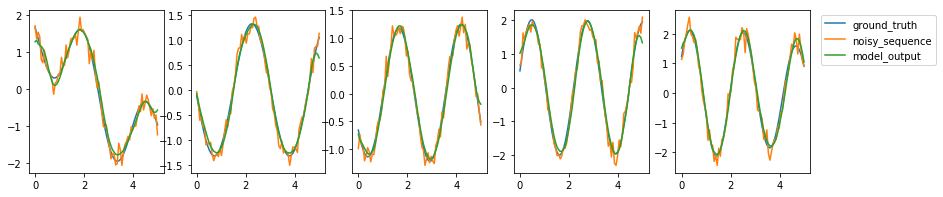

34.36% of noise removed.
epoch: 62, validation loss:55.973731994628906


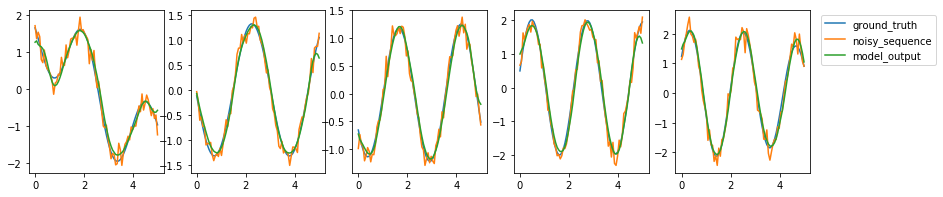

32.73% of noise removed.
epoch: 63, validation loss:54.91171646118164


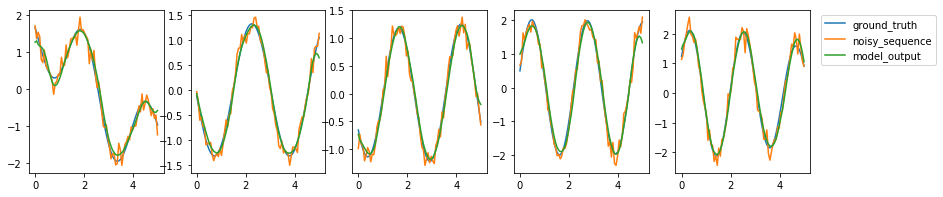

33.36% of noise removed.
epoch: 64, validation loss:50.997955322265625


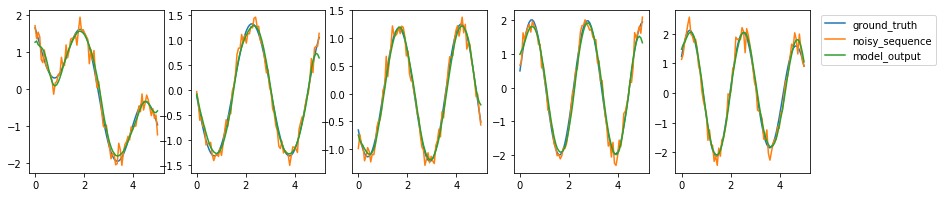

36.78% of noise removed.
epoch: 65, validation loss:47.6309700012207


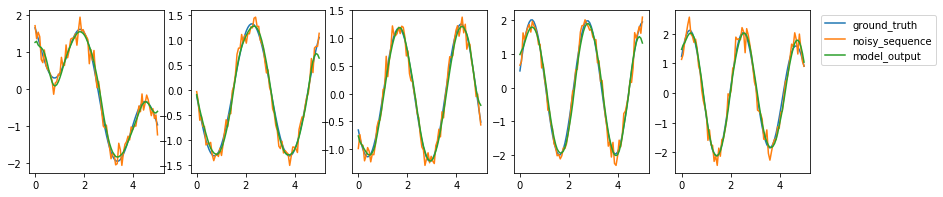

40.28% of noise removed.
epoch: 66, validation loss:46.34153747558594


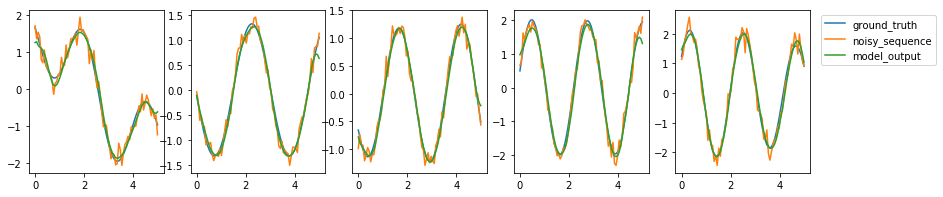

42.38% of noise removed.
epoch: 67, validation loss:46.764610290527344


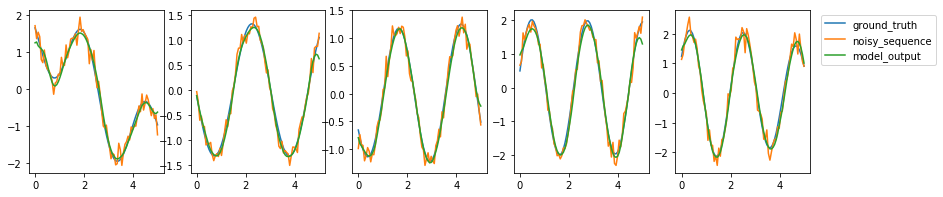

42.55% of noise removed.
epoch: 68, validation loss:46.008995056152344


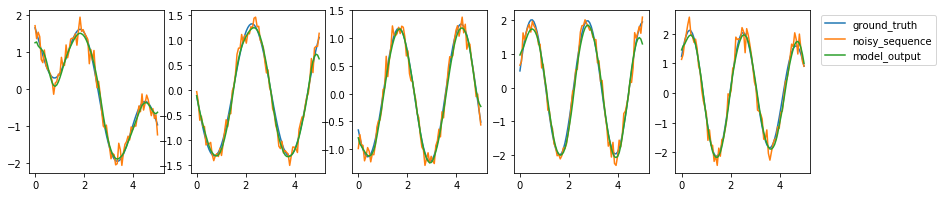

43.05% of noise removed.
epoch: 69, validation loss:44.69093322753906


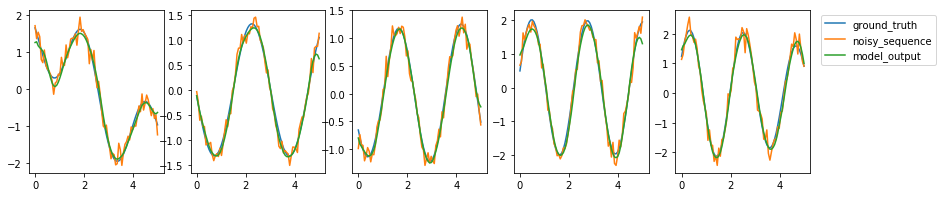

43.85% of noise removed.
epoch: 70, validation loss:43.57775115966797


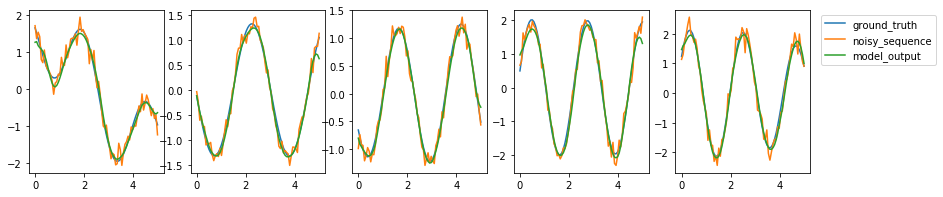

44.57% of noise removed.
epoch: 71, validation loss:42.5321159362793


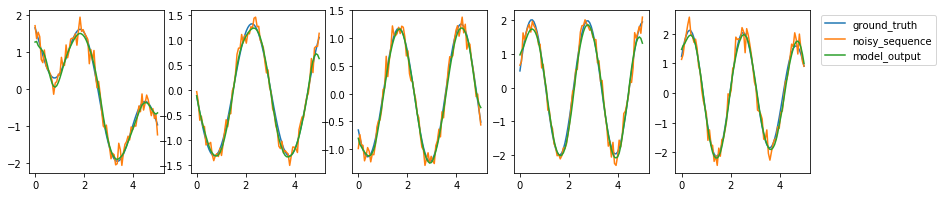

45.27% of noise removed.
epoch: 72, validation loss:41.4212532043457


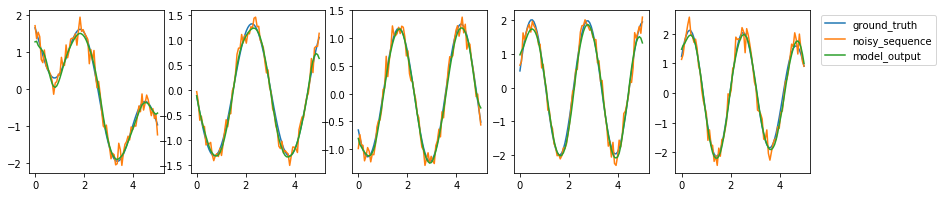

46.03% of noise removed.
epoch: 73, validation loss:40.196449279785156


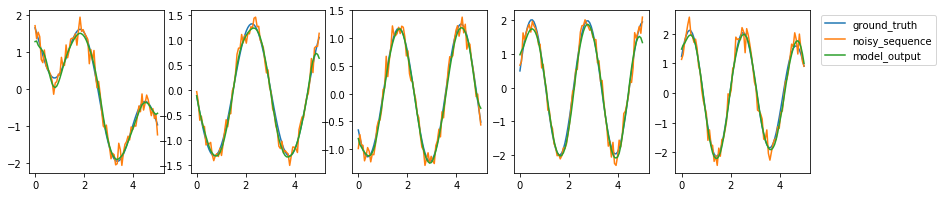

46.85% of noise removed.
epoch: 74, validation loss:38.88421630859375


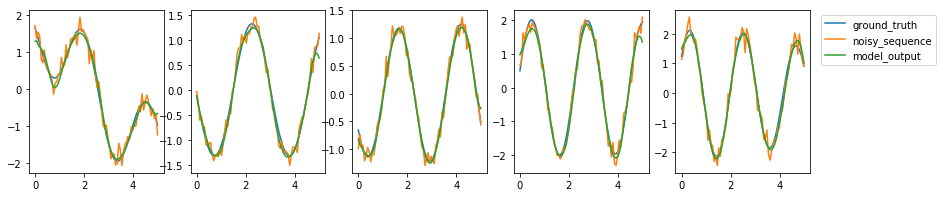

47.71% of noise removed.
epoch: 75, validation loss:37.573219299316406


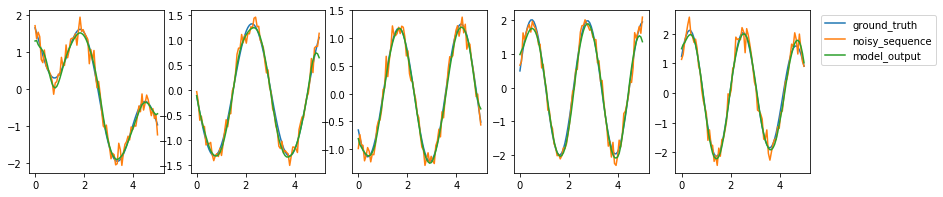

48.57% of noise removed.
epoch: 76, validation loss:36.37503433227539


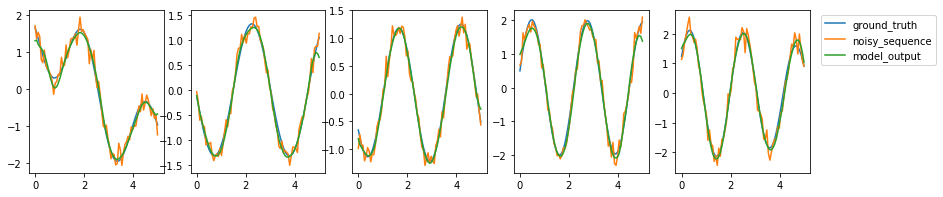

49.39% of noise removed.
epoch: 77, validation loss:35.35890197753906


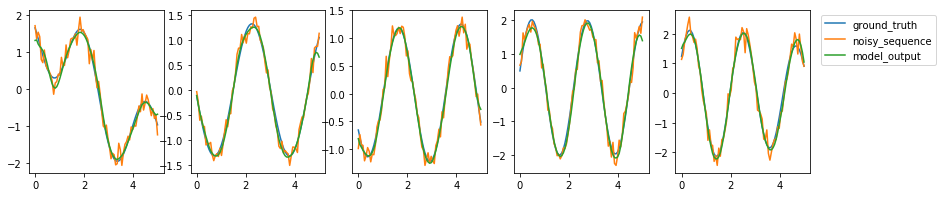

50.07% of noise removed.
epoch: 78, validation loss:34.51106262207031


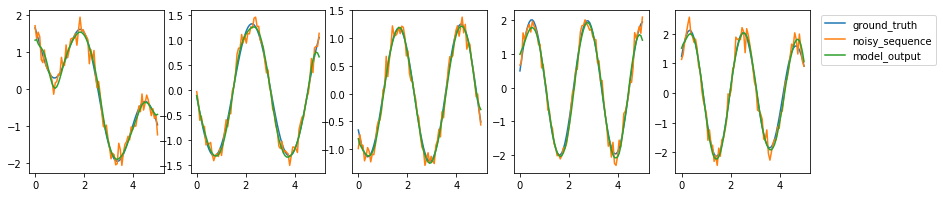

50.65% of noise removed.
epoch: 79, validation loss:33.76019287109375


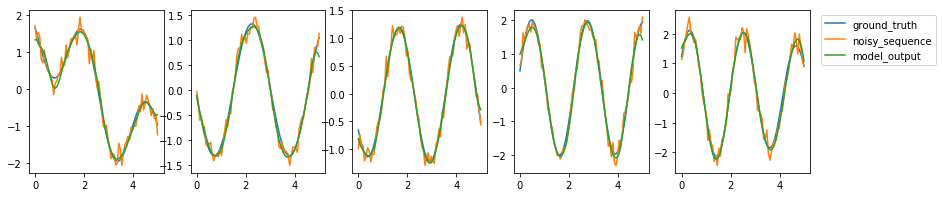

51.16% of noise removed.
epoch: 80, validation loss:33.0401725769043


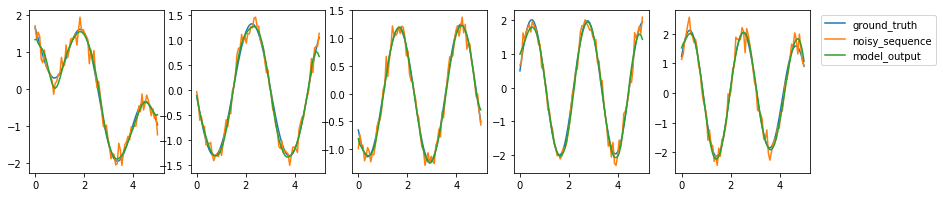

51.65% of noise removed.
epoch: 81, validation loss:32.33987045288086


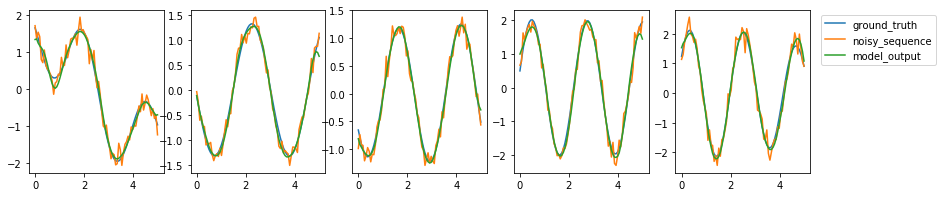

52.16% of noise removed.
epoch: 82, validation loss:31.708681106567383


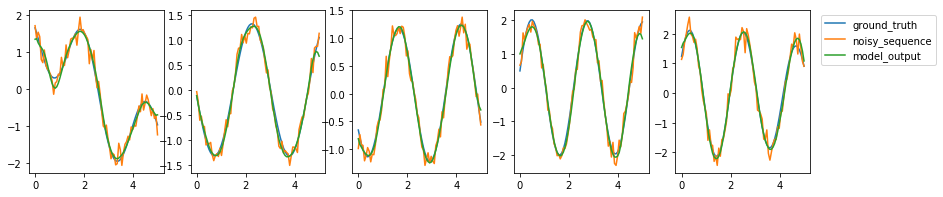

52.64% of noise removed.
epoch: 83, validation loss:31.21499252319336


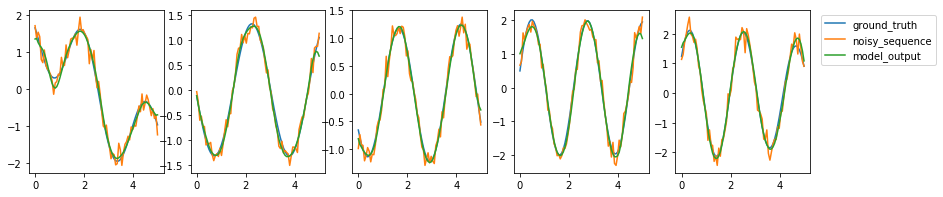

52.99% of noise removed.
epoch: 84, validation loss:30.91117286682129


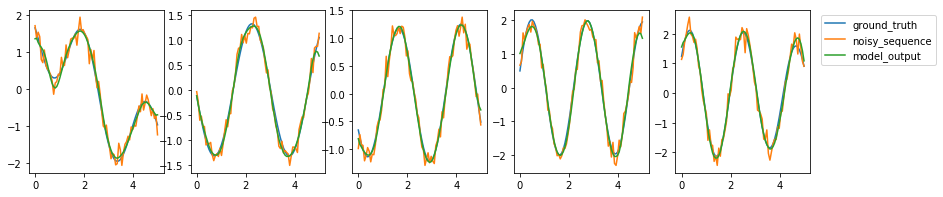

53.18% of noise removed.
epoch: 85, validation loss:30.823850631713867


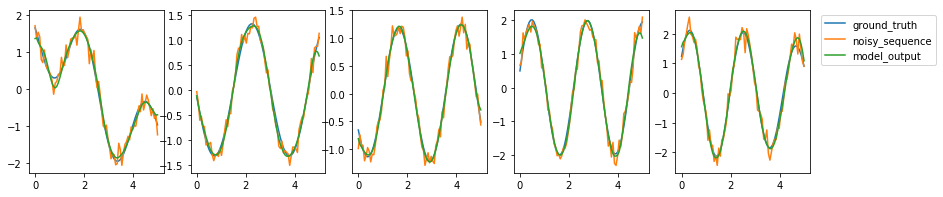

53.17% of noise removed.
epoch: 86, validation loss:30.9359073638916


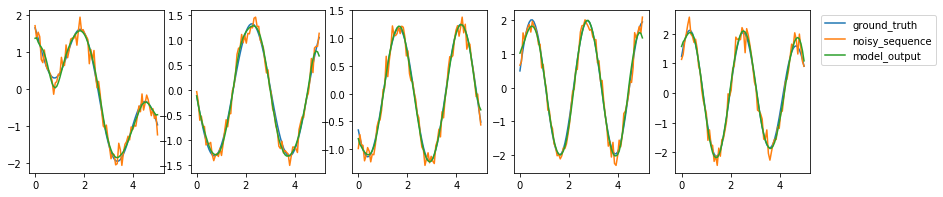

52.95% of noise removed.
epoch: 87, validation loss:31.166494369506836


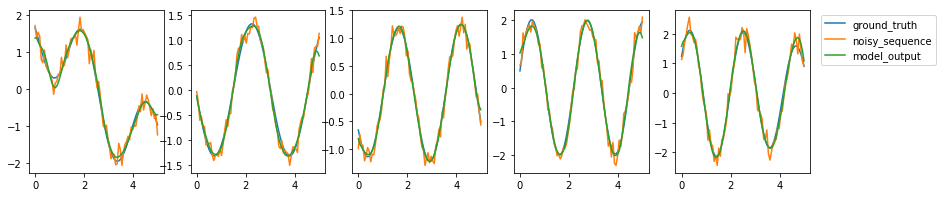

52.59% of noise removed.
epoch: 88, validation loss:31.410493850708008


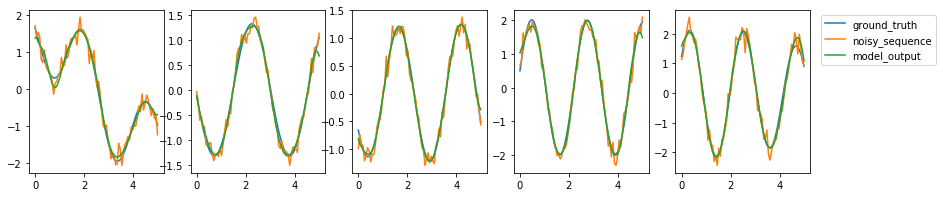

52.23% of noise removed.
epoch: 89, validation loss:31.600568771362305


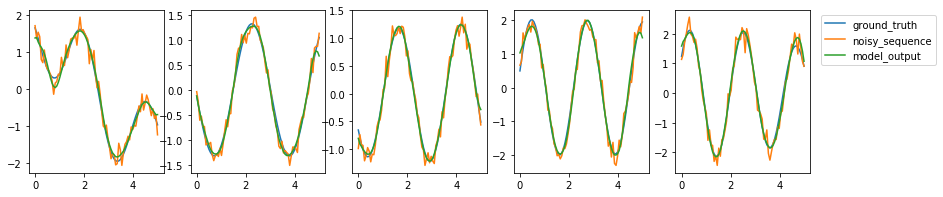

51.93% of noise removed.
epoch: 90, validation loss:31.714637756347656


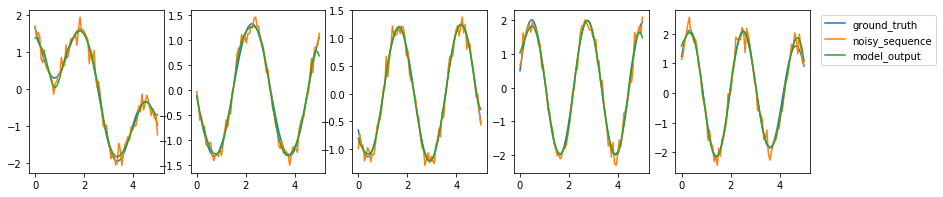

51.70% of noise removed.
epoch: 91, validation loss:31.709577560424805


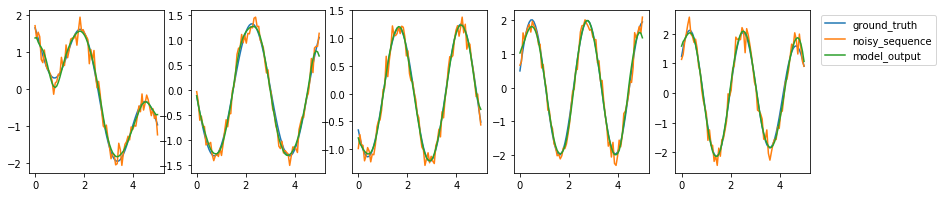

51.59% of noise removed.
epoch: 92, validation loss:31.491809844970703


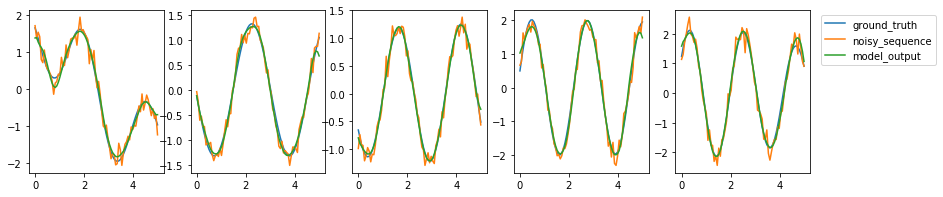

51.73% of noise removed.
epoch: 93, validation loss:31.12067222595215


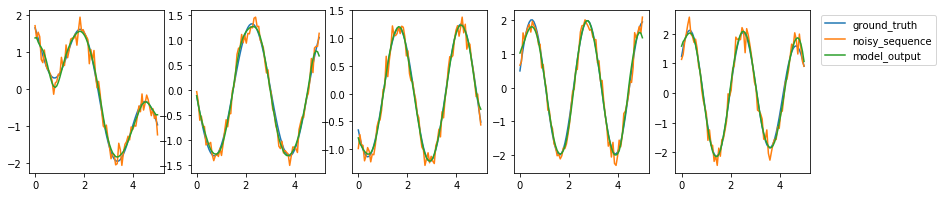

52.02% of noise removed.
epoch: 94, validation loss:30.76668930053711


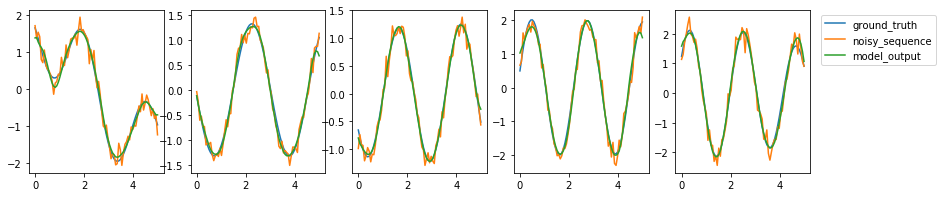

52.31% of noise removed.
epoch: 95, validation loss:30.47539710998535


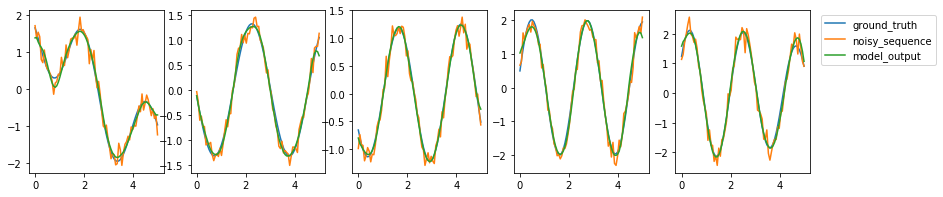

52.54% of noise removed.
epoch: 96, validation loss:30.239194869995117


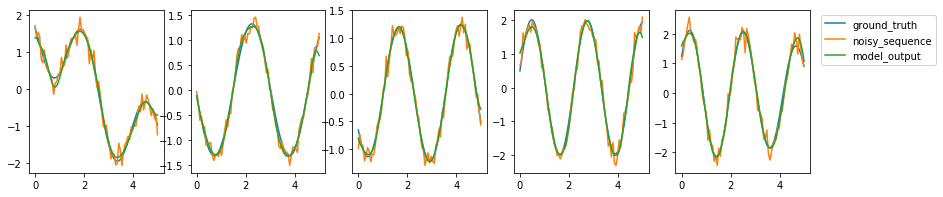

52.75% of noise removed.
epoch: 97, validation loss:30.068458557128906


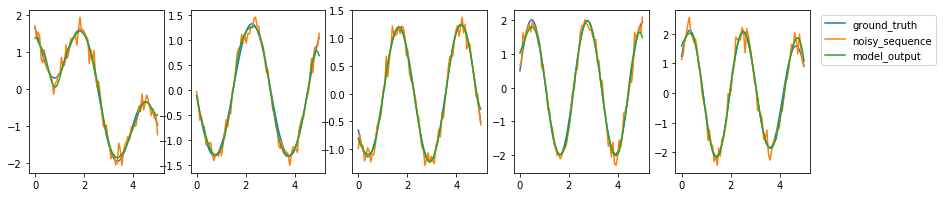

52.91% of noise removed.
epoch: 98, validation loss:29.96921157836914


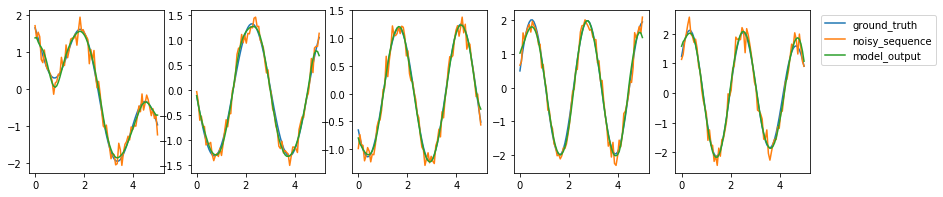

53.01% of noise removed.
epoch: 99, validation loss:29.922208786010742


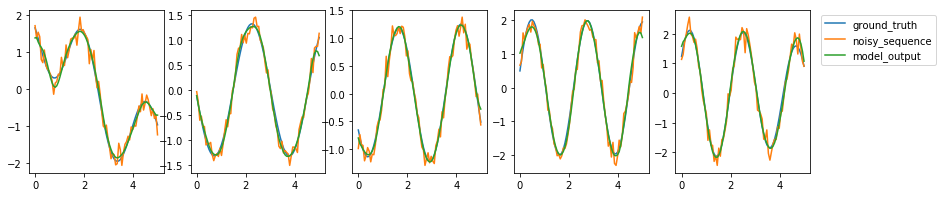

53.05% of noise removed.
epoch: 100, validation loss:29.902936935424805


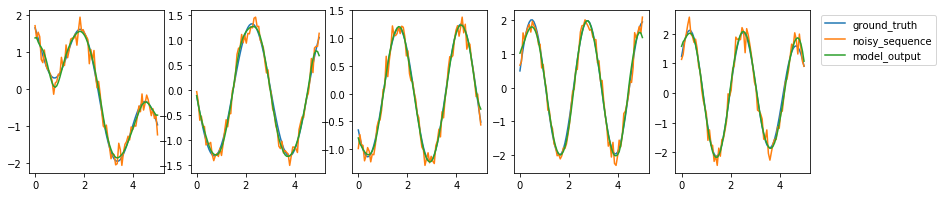

53.07% of noise removed.


In [12]:
# don't forget to create a new model each time!
# START TODO #############

# Reducing the batch size from 20 to 10

batch_size = 10 # <- CHANGED
num_epochs = 101
learning_rate = 0.005

model_2 = NoiseRemovalModel(hidden_size=40, shift=10)
optimizer = optim.Adam(model_2.parameters(), lr=learning_rate, betas=(0.6, 0.87))
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)
print("cuda avialable :", torch.cuda.is_available())
train(model_2, optimizer, scheduler, num_epochs, batch_size)


cuda avialable : False
epoch: 0, validation loss:5277.56494140625


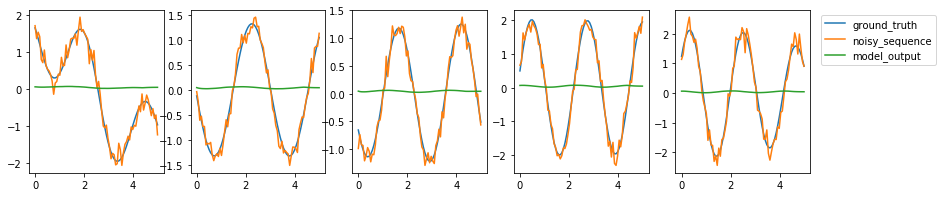

-630.31% of noise removed.
epoch: 1, validation loss:4435.45849609375


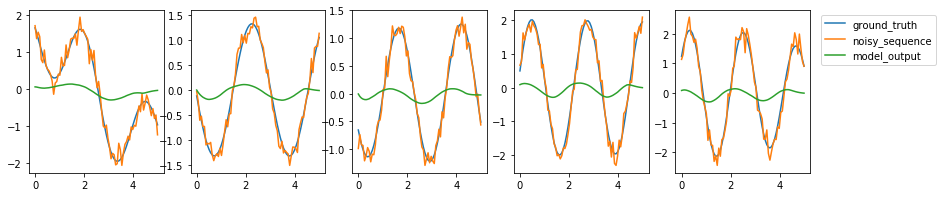

-570.49% of noise removed.
epoch: 2, validation loss:2250.85302734375


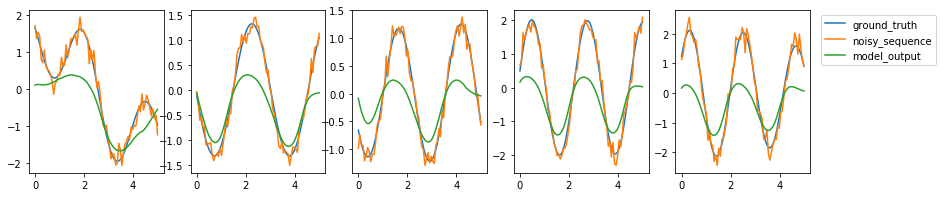

-334.29% of noise removed.
epoch: 3, validation loss:1175.0133056640625


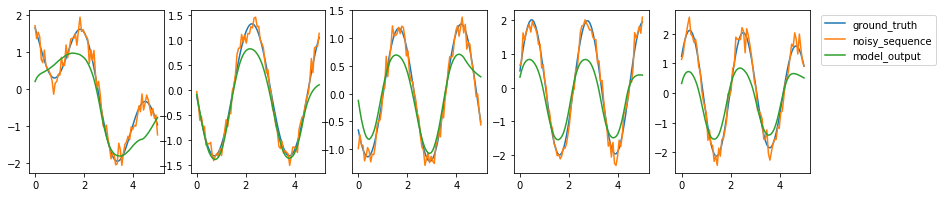

-210.74% of noise removed.
epoch: 4, validation loss:825.50341796875


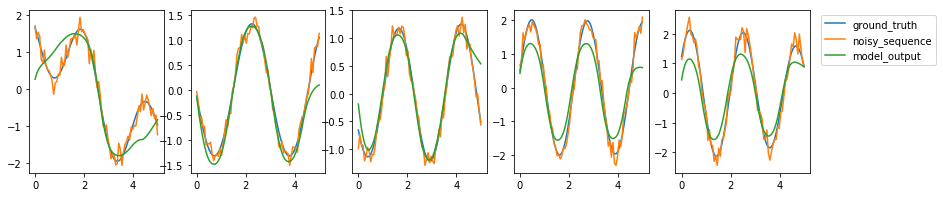

-176.32% of noise removed.
epoch: 5, validation loss:745.4921875


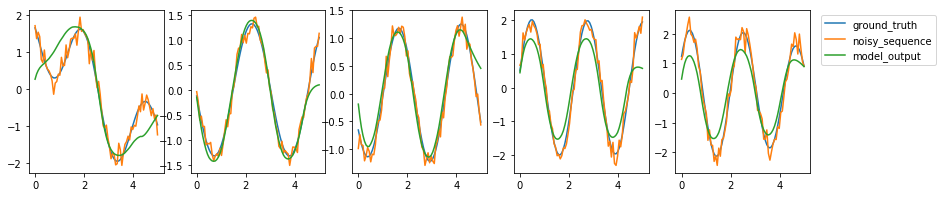

-162.81% of noise removed.
epoch: 6, validation loss:704.9974975585938


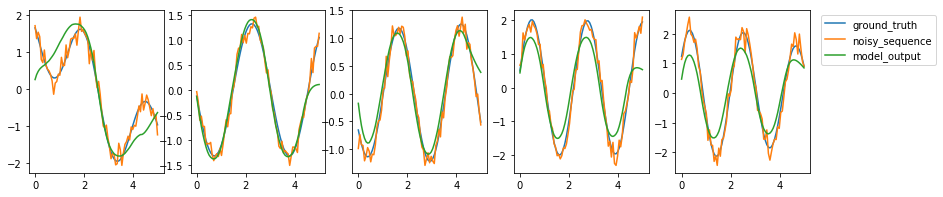

-152.80% of noise removed.
epoch: 7, validation loss:682.376708984375


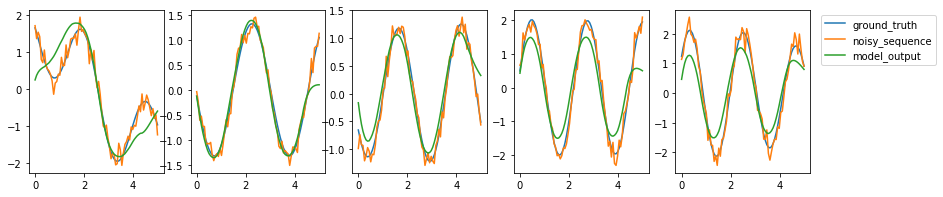

-146.76% of noise removed.
epoch: 8, validation loss:666.7181396484375


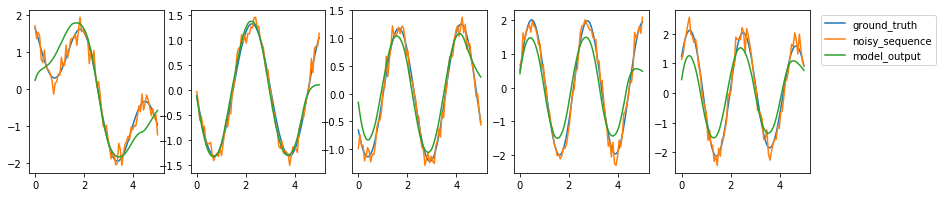

-142.99% of noise removed.
epoch: 9, validation loss:653.5528564453125


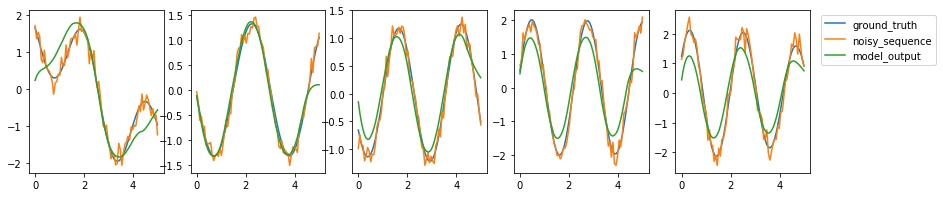

-139.91% of noise removed.
epoch: 10, validation loss:641.2626953125


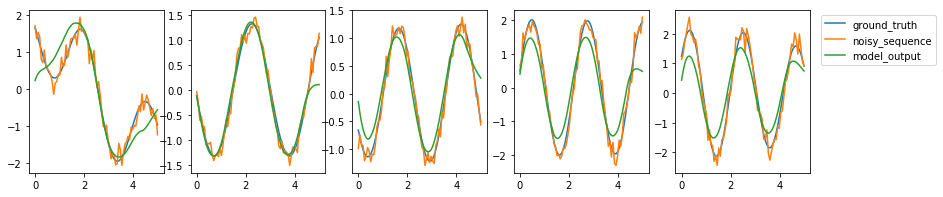

-137.03% of noise removed.
epoch: 11, validation loss:629.0833740234375


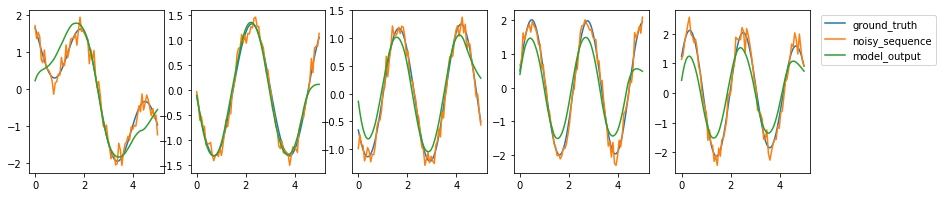

-134.14% of noise removed.
epoch: 12, validation loss:616.4321899414062


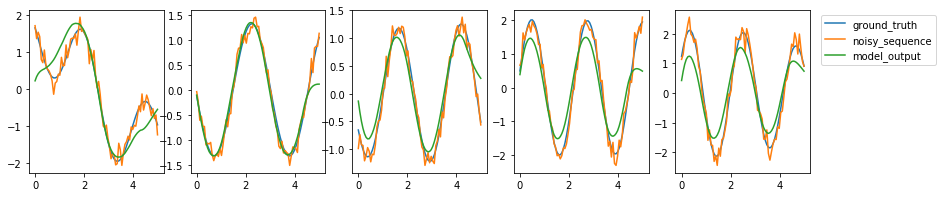

-131.09% of noise removed.
epoch: 13, validation loss:602.7708129882812


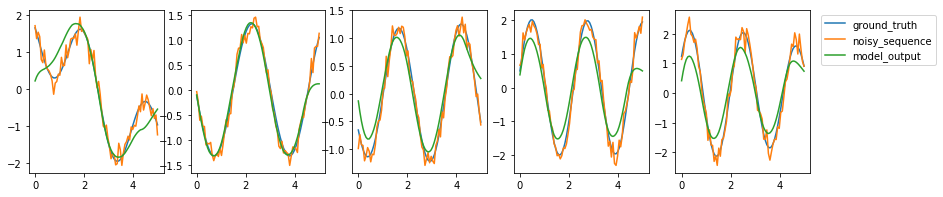

-127.73% of noise removed.
epoch: 14, validation loss:587.5692138671875


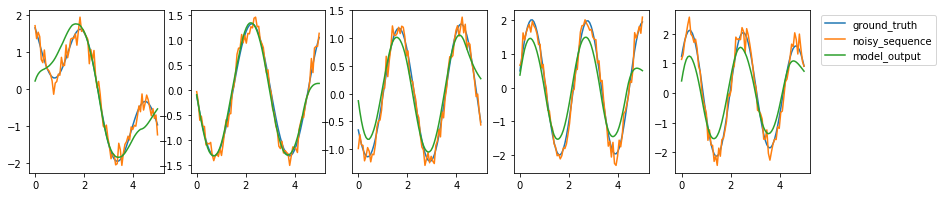

-123.94% of noise removed.
epoch: 15, validation loss:570.29345703125


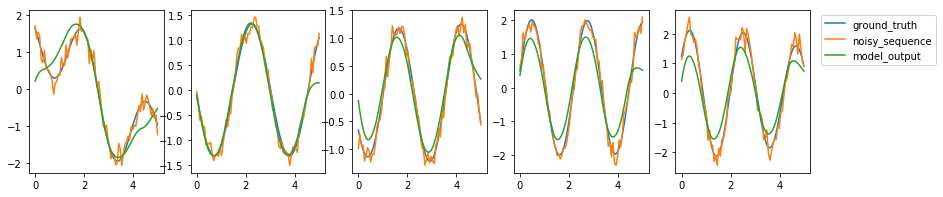

-119.55% of noise removed.
epoch: 16, validation loss:550.4003295898438


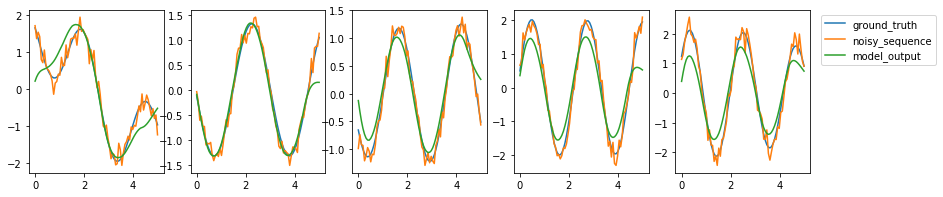

-114.39% of noise removed.
epoch: 17, validation loss:527.3462524414062


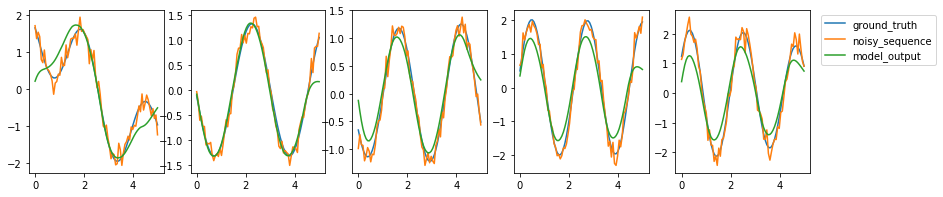

-108.26% of noise removed.
epoch: 18, validation loss:500.61407470703125


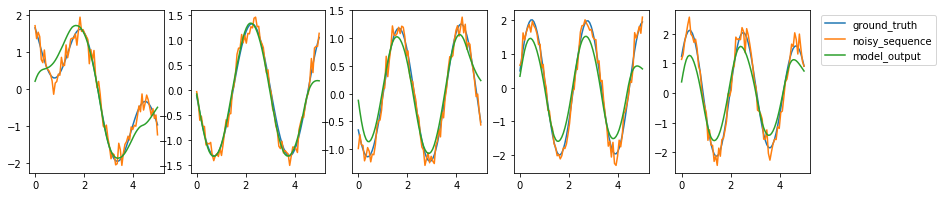

-100.91% of noise removed.
epoch: 19, validation loss:469.77545166015625


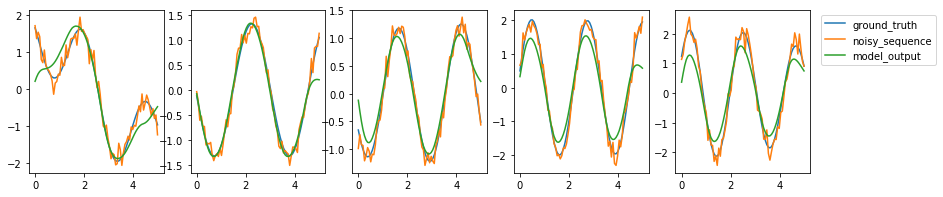

-92.05% of noise removed.
epoch: 20, validation loss:434.61029052734375


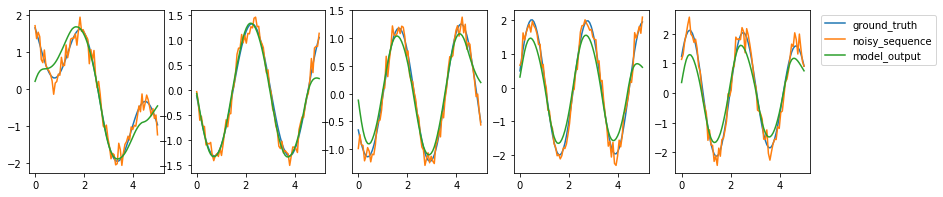

-81.42% of noise removed.
epoch: 21, validation loss:395.3184509277344


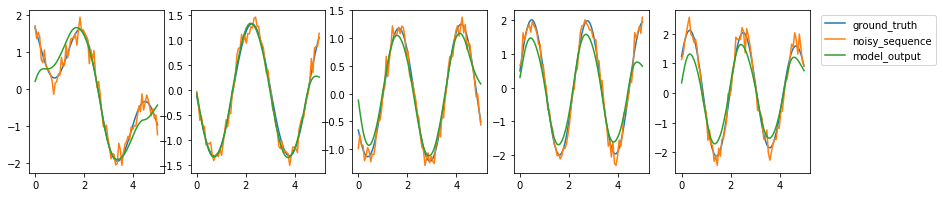

-68.74% of noise removed.
epoch: 22, validation loss:352.8630676269531


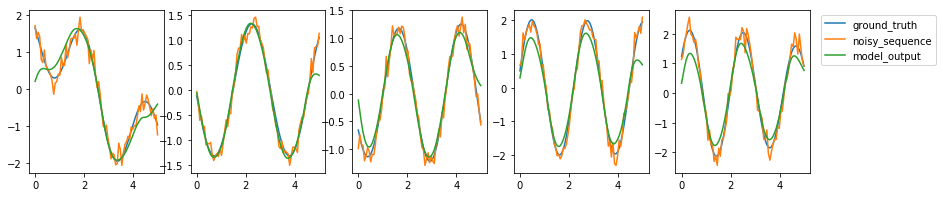

-53.81% of noise removed.
epoch: 23, validation loss:309.4617919921875


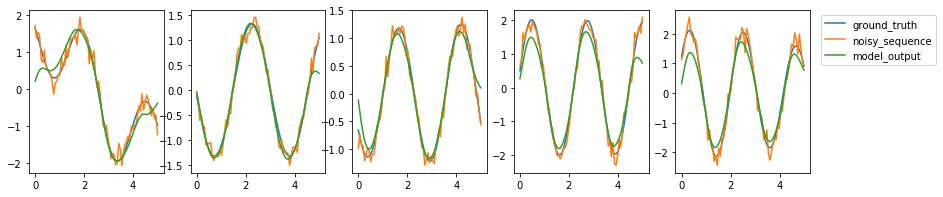

-36.86% of noise removed.
epoch: 24, validation loss:269.01556396484375


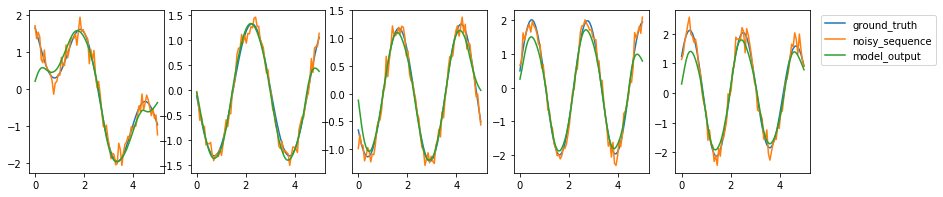

-19.18% of noise removed.
epoch: 25, validation loss:236.46243286132812


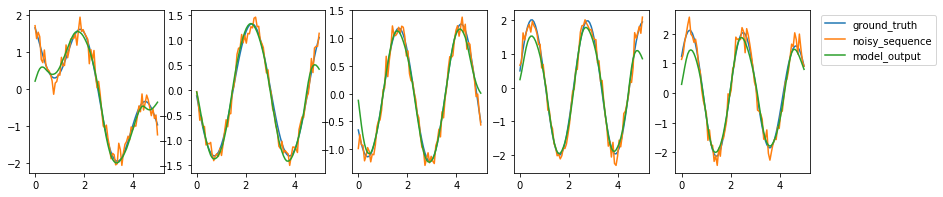

-4.71% of noise removed.
epoch: 26, validation loss:214.19422912597656


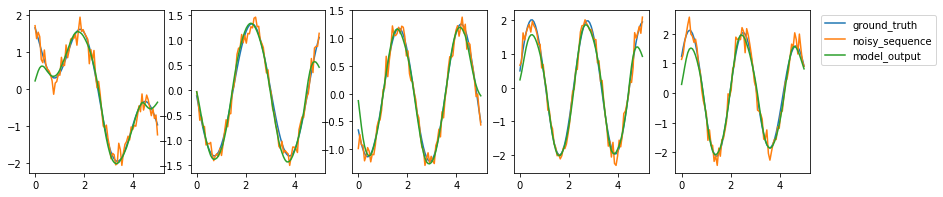

2.82% of noise removed.
epoch: 27, validation loss:198.77574157714844


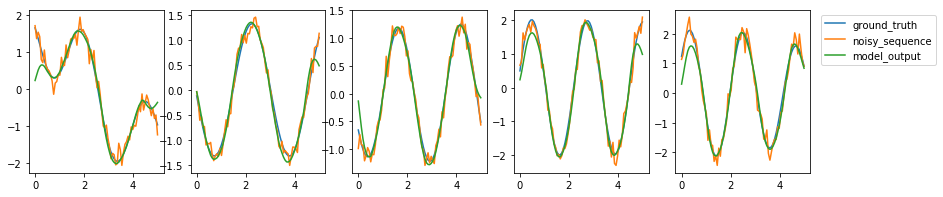

6.13% of noise removed.
epoch: 28, validation loss:187.59530639648438


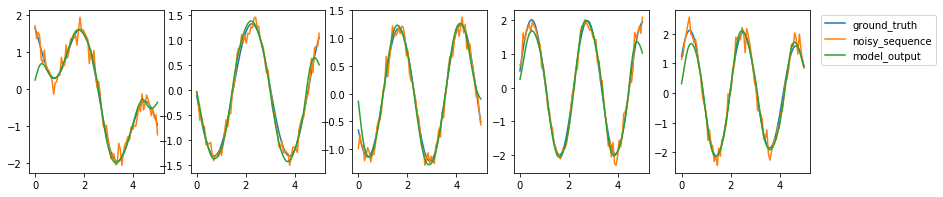

8.15% of noise removed.
epoch: 29, validation loss:179.44448852539062


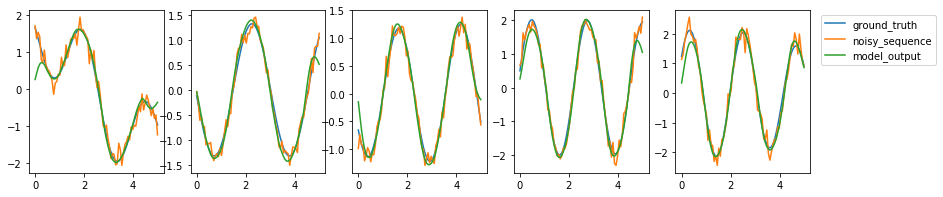

8.91% of noise removed.
epoch: 30, validation loss:172.58731079101562


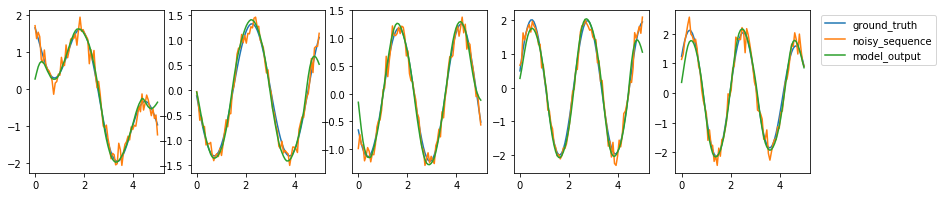

9.75% of noise removed.
epoch: 31, validation loss:166.57681274414062


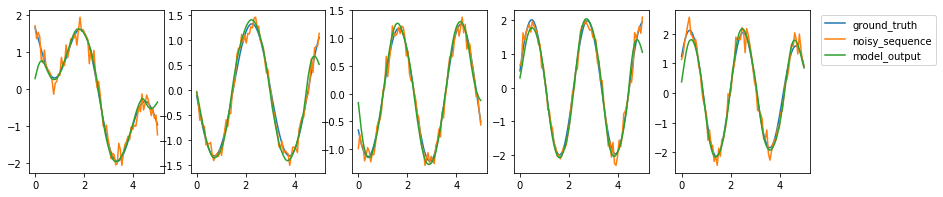

11.08% of noise removed.
epoch: 32, validation loss:161.49107360839844


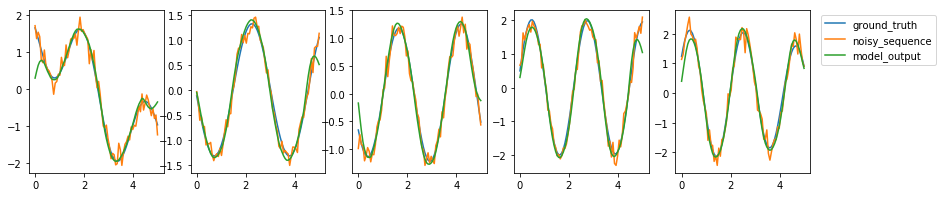

12.38% of noise removed.
epoch: 33, validation loss:157.1663818359375


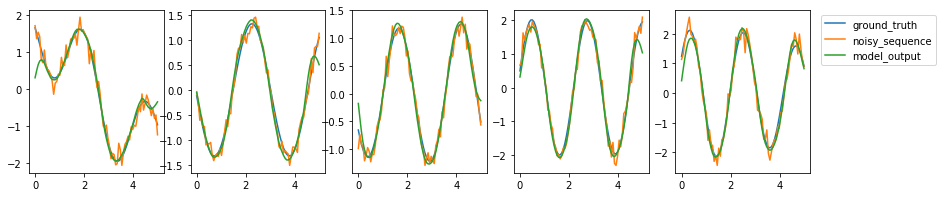

13.53% of noise removed.
epoch: 34, validation loss:153.4257354736328


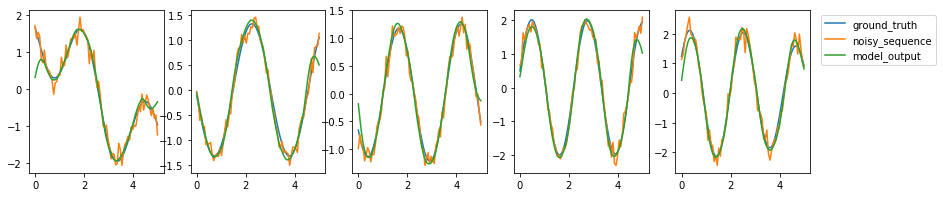

14.57% of noise removed.
epoch: 35, validation loss:150.15415954589844


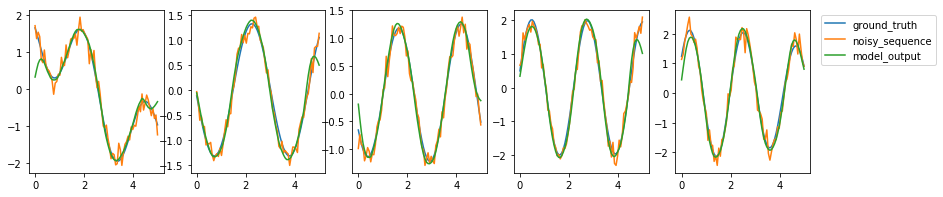

15.50% of noise removed.
epoch: 36, validation loss:147.2561798095703


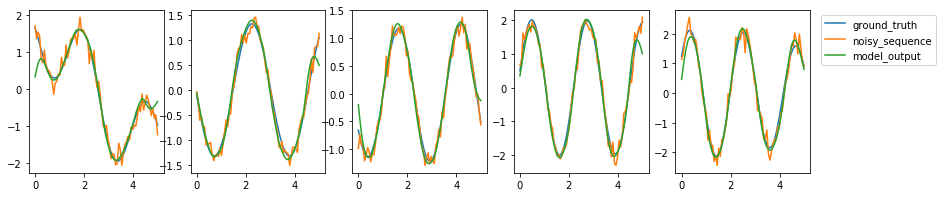

16.35% of noise removed.
epoch: 37, validation loss:144.66287231445312


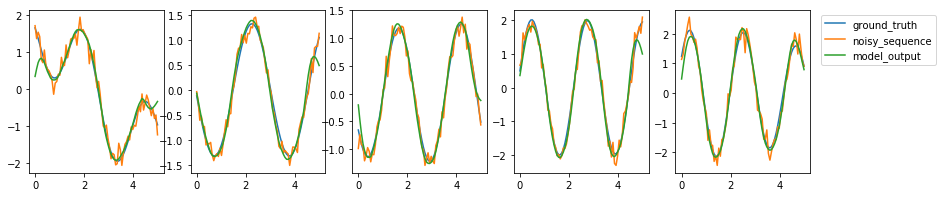

17.14% of noise removed.
epoch: 38, validation loss:142.32533264160156


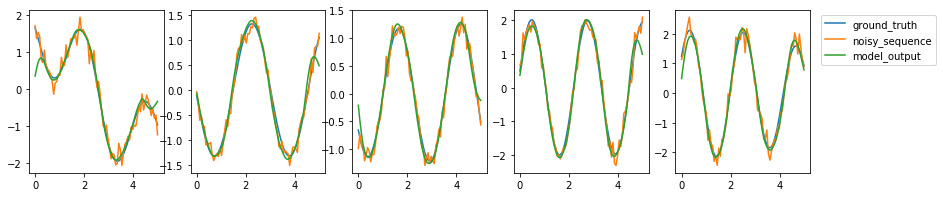

17.86% of noise removed.
epoch: 39, validation loss:140.20855712890625


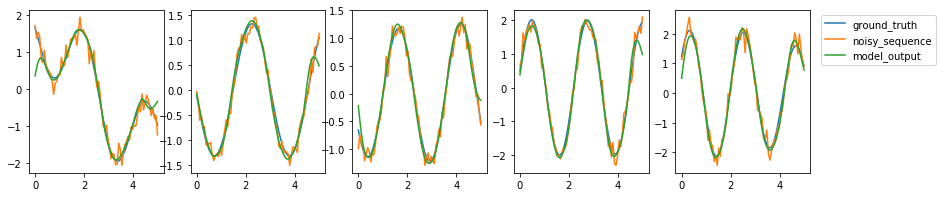

18.51% of noise removed.
epoch: 40, validation loss:138.2884063720703


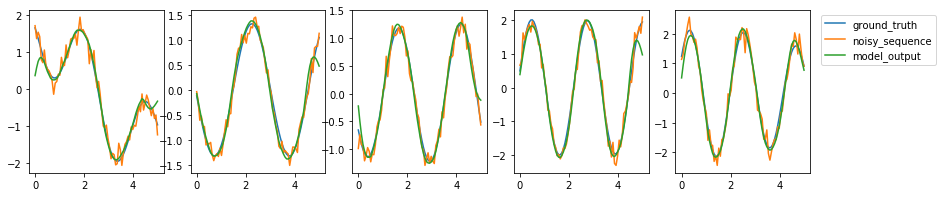

19.11% of noise removed.
epoch: 41, validation loss:136.54869079589844


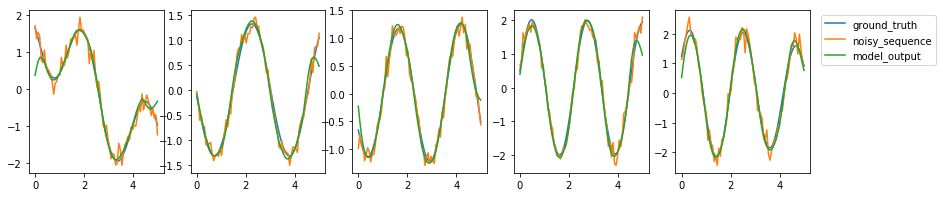

19.67% of noise removed.
epoch: 42, validation loss:134.97952270507812


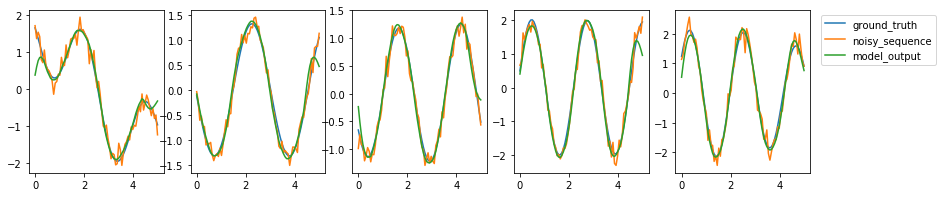

20.18% of noise removed.
epoch: 43, validation loss:133.5760498046875


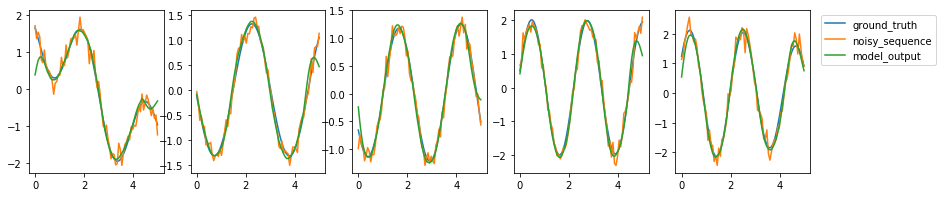

20.66% of noise removed.
epoch: 44, validation loss:132.33761596679688


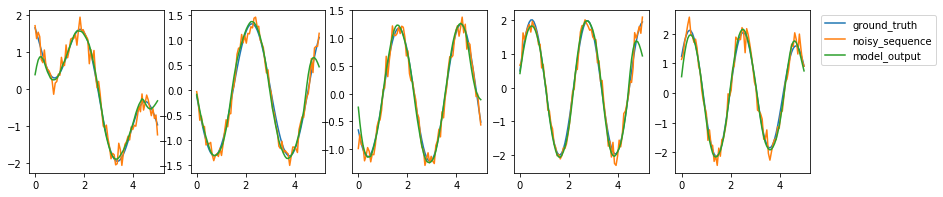

21.08% of noise removed.
epoch: 45, validation loss:131.26693725585938


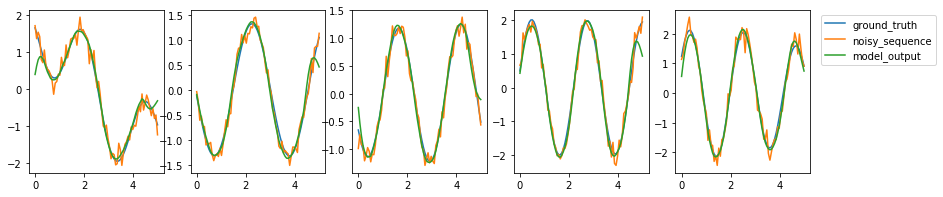

21.45% of noise removed.
epoch: 46, validation loss:130.3662109375


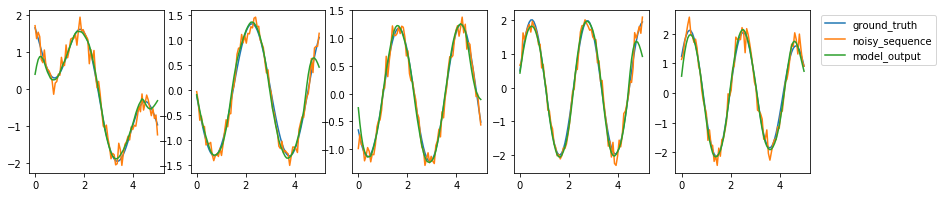

21.76% of noise removed.
epoch: 47, validation loss:129.6175079345703


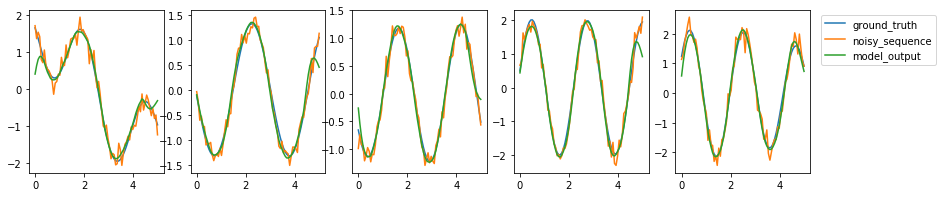

22.02% of noise removed.
epoch: 48, validation loss:128.93032836914062


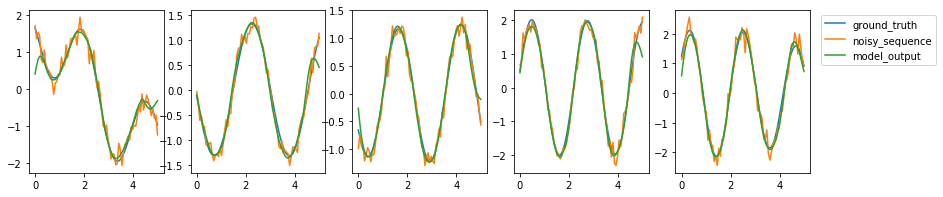

22.27% of noise removed.
epoch: 49, validation loss:128.099609375


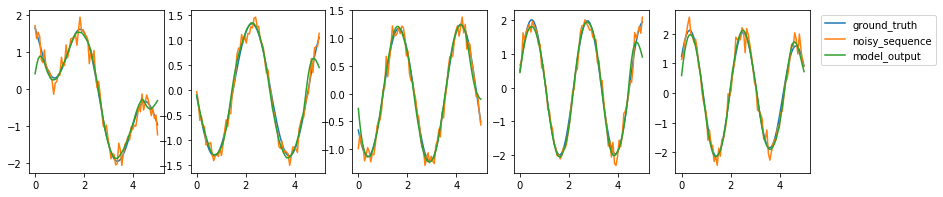

22.62% of noise removed.
epoch: 50, validation loss:126.96162414550781


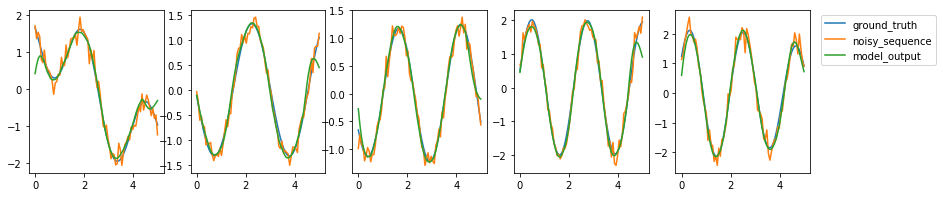

23.10% of noise removed.
epoch: 51, validation loss:125.62739562988281


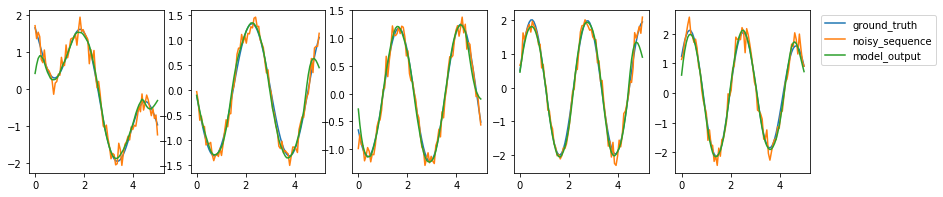

23.65% of noise removed.
epoch: 52, validation loss:124.31033325195312


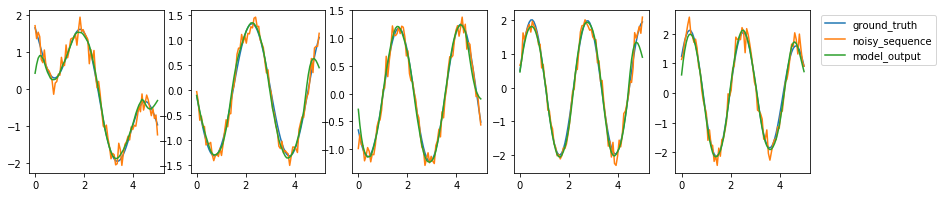

24.18% of noise removed.
epoch: 53, validation loss:123.07714080810547


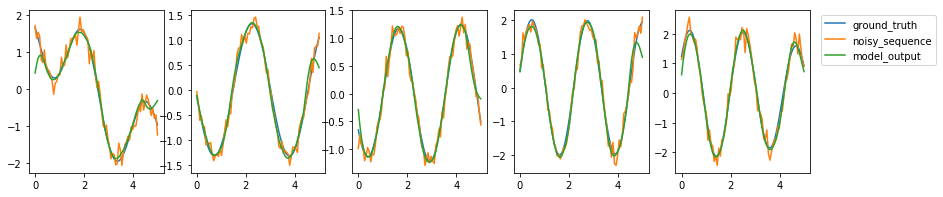

24.68% of noise removed.
epoch: 54, validation loss:121.89533996582031


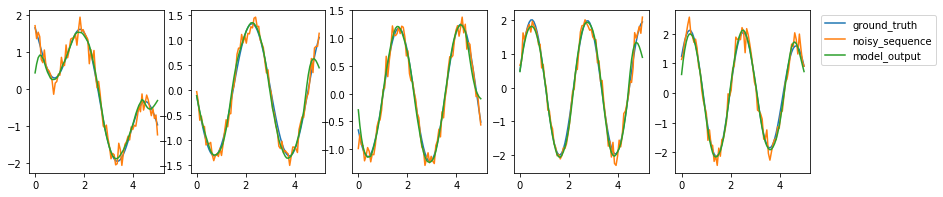

25.16% of noise removed.
epoch: 55, validation loss:120.73639678955078


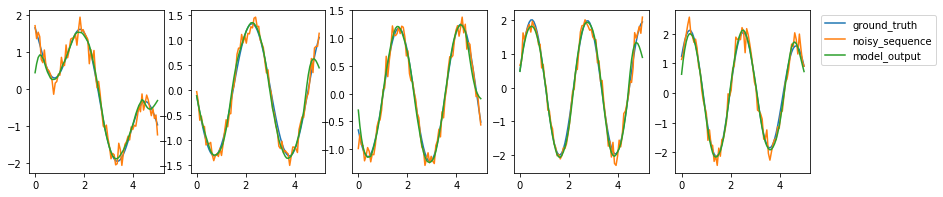

25.64% of noise removed.
epoch: 56, validation loss:119.59794616699219


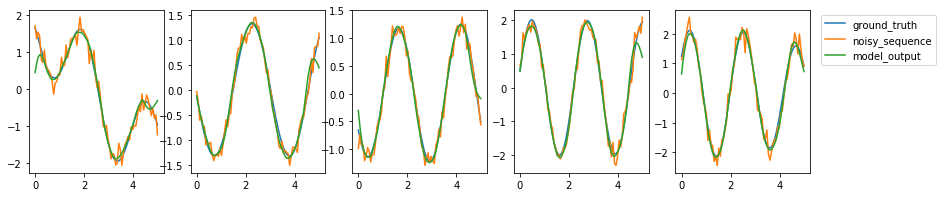

26.10% of noise removed.
epoch: 57, validation loss:118.48683166503906


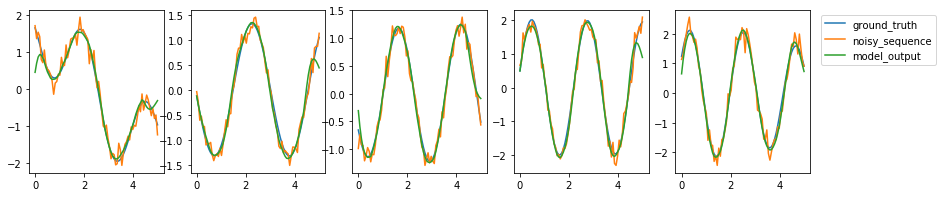

26.54% of noise removed.
epoch: 58, validation loss:117.40670013427734


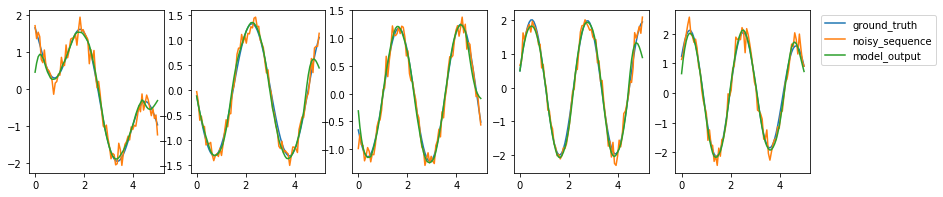

26.97% of noise removed.
epoch: 59, validation loss:116.35848999023438


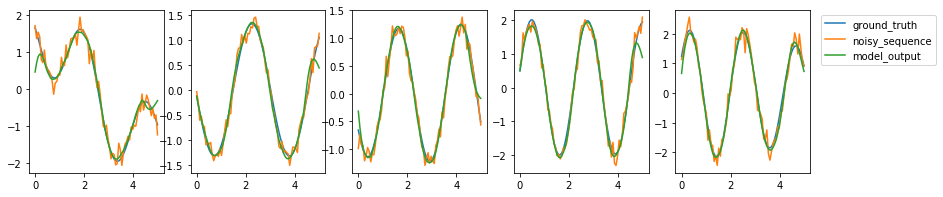

27.39% of noise removed.
epoch: 60, validation loss:115.34313201904297


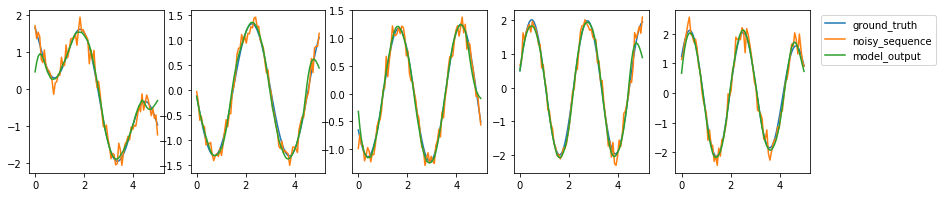

27.78% of noise removed.
epoch: 61, validation loss:114.36217498779297


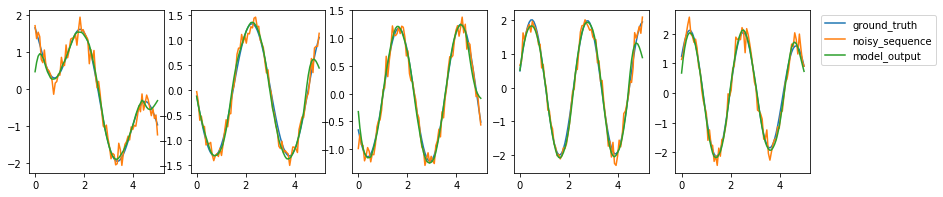

28.16% of noise removed.
epoch: 62, validation loss:113.41730499267578


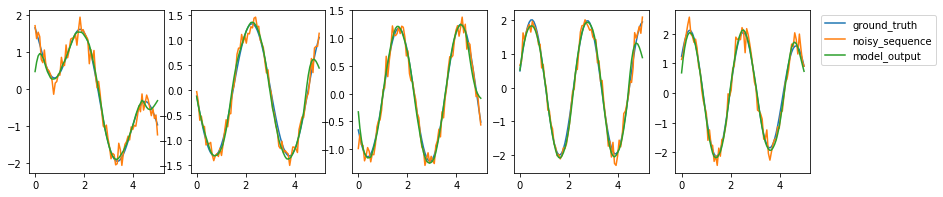

28.52% of noise removed.
epoch: 63, validation loss:112.5102310180664


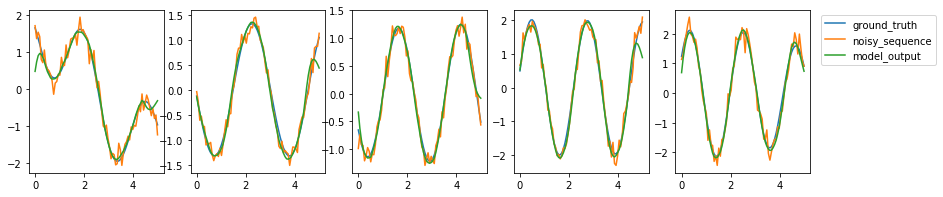

28.87% of noise removed.
epoch: 64, validation loss:111.6425552368164


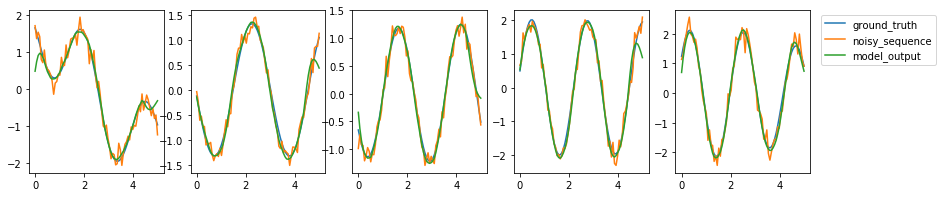

29.19% of noise removed.
epoch: 65, validation loss:110.8156509399414


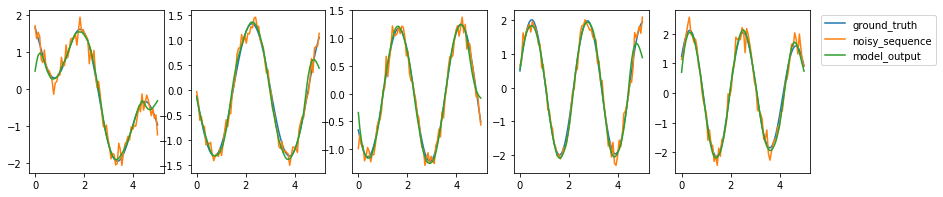

29.50% of noise removed.
epoch: 66, validation loss:110.03077697753906


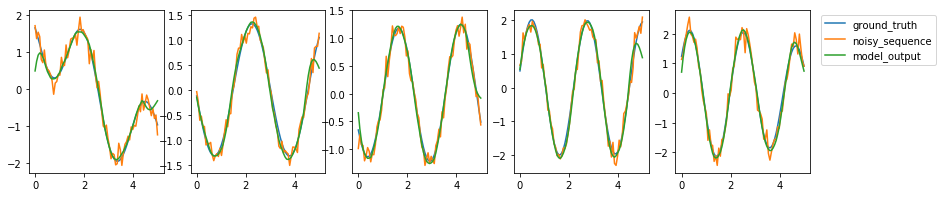

29.79% of noise removed.
epoch: 67, validation loss:109.28868865966797


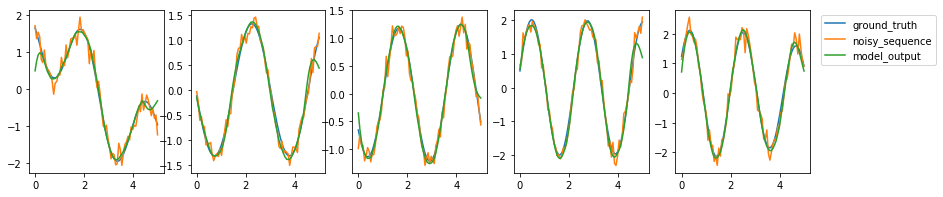

30.06% of noise removed.
epoch: 68, validation loss:108.58969116210938


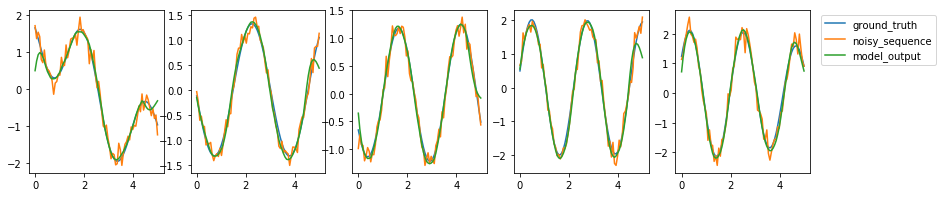

30.30% of noise removed.
epoch: 69, validation loss:107.93350219726562


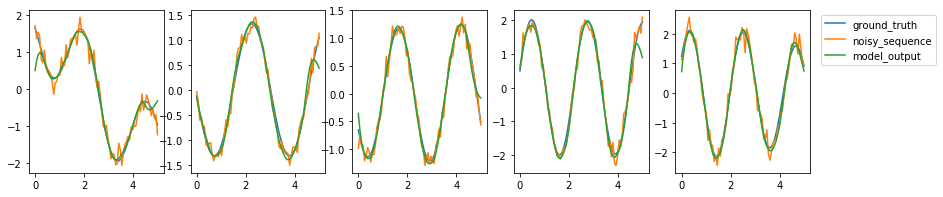

30.52% of noise removed.
epoch: 70, validation loss:107.3191909790039


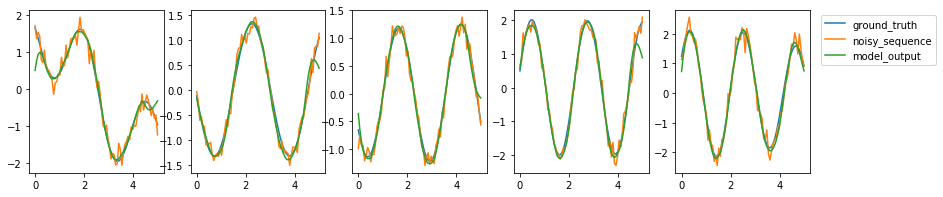

30.72% of noise removed.
epoch: 71, validation loss:106.74527740478516


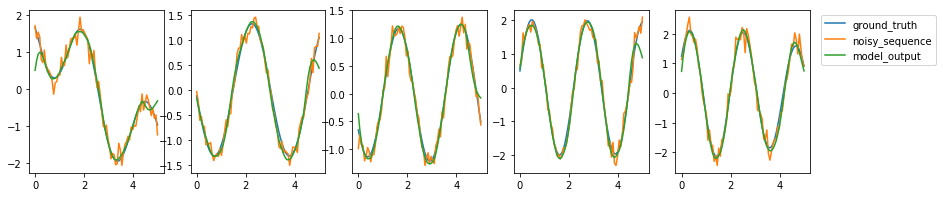

30.90% of noise removed.
epoch: 72, validation loss:106.2096939086914


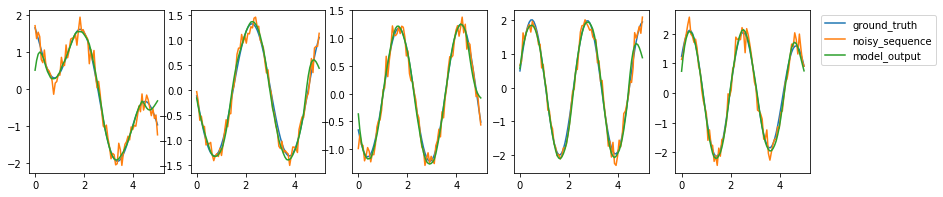

31.06% of noise removed.
epoch: 73, validation loss:105.70987701416016


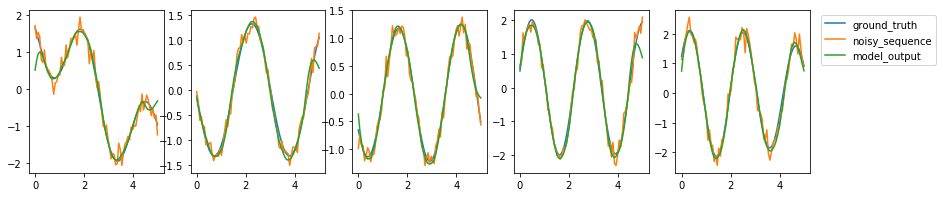

31.21% of noise removed.
epoch: 74, validation loss:105.24285888671875


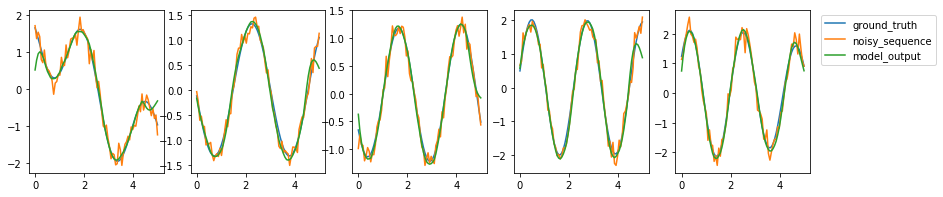

31.34% of noise removed.
epoch: 75, validation loss:104.80548858642578


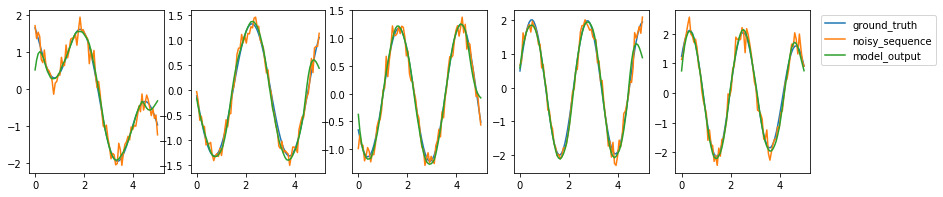

31.44% of noise removed.
epoch: 76, validation loss:104.39482116699219


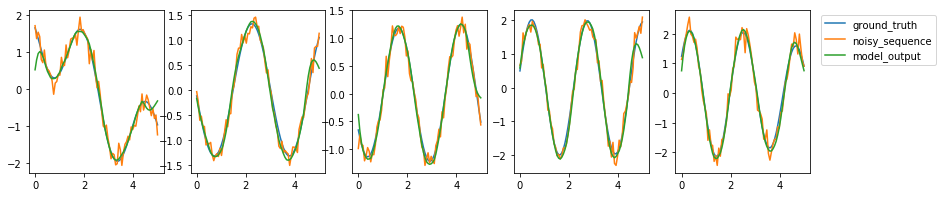

31.53% of noise removed.
epoch: 77, validation loss:104.00883483886719


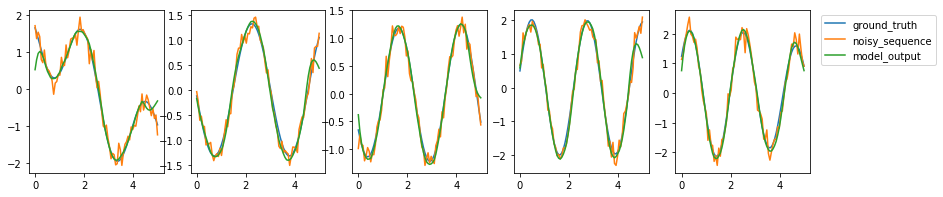

31.60% of noise removed.
epoch: 78, validation loss:103.6476821899414


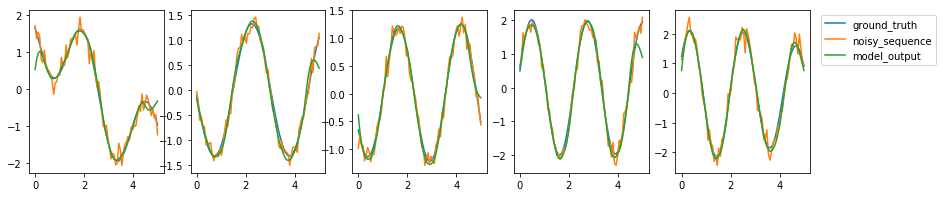

31.63% of noise removed.
epoch: 79, validation loss:103.31468200683594


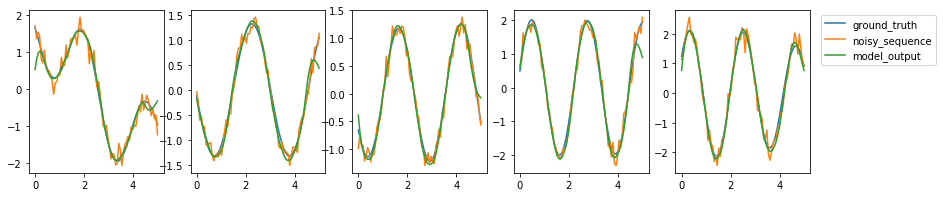

31.63% of noise removed.
epoch: 80, validation loss:103.01616668701172


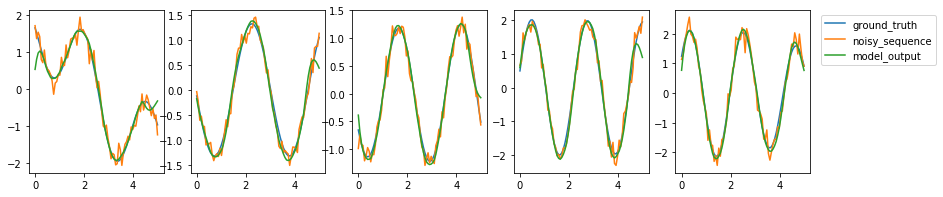

31.58% of noise removed.
epoch: 81, validation loss:102.75872039794922


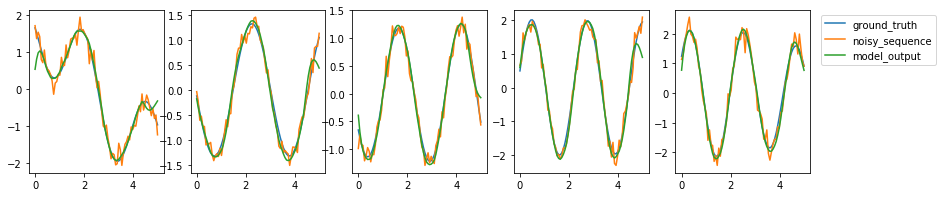

31.49% of noise removed.
epoch: 82, validation loss:102.5445556640625


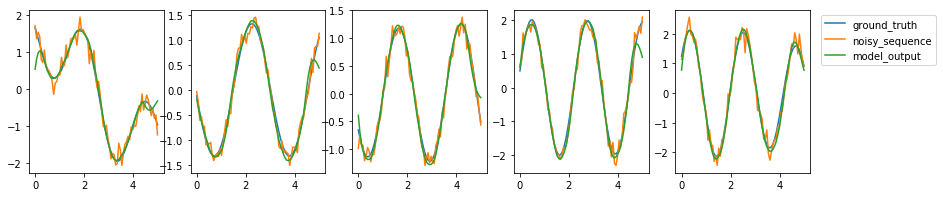

31.37% of noise removed.
epoch: 83, validation loss:102.36842346191406


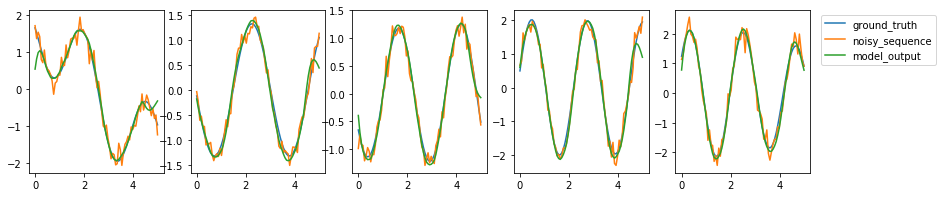

31.25% of noise removed.
epoch: 84, validation loss:102.2191390991211


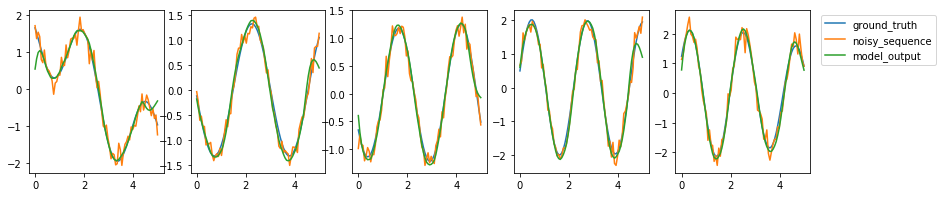

31.15% of noise removed.
epoch: 85, validation loss:102.08457946777344


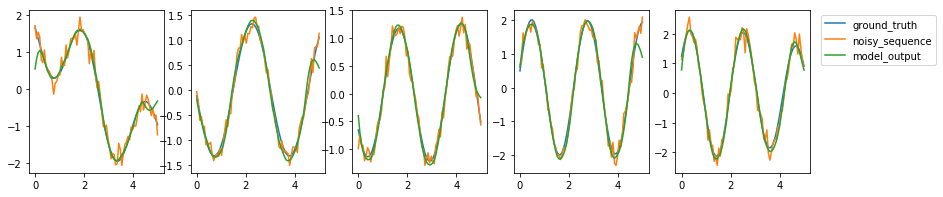

31.09% of noise removed.
epoch: 86, validation loss:101.95638275146484


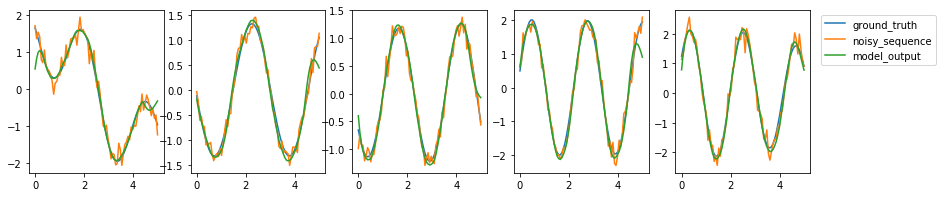

31.08% of noise removed.
epoch: 87, validation loss:101.8320083618164


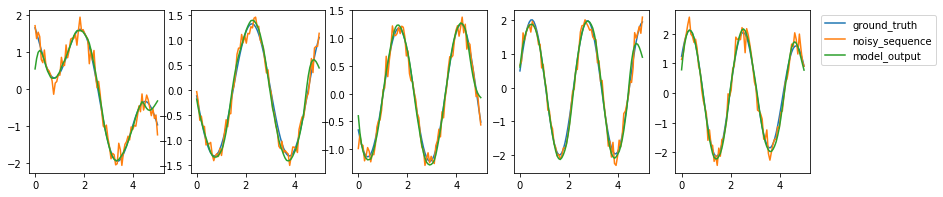

31.10% of noise removed.
epoch: 88, validation loss:101.71342468261719


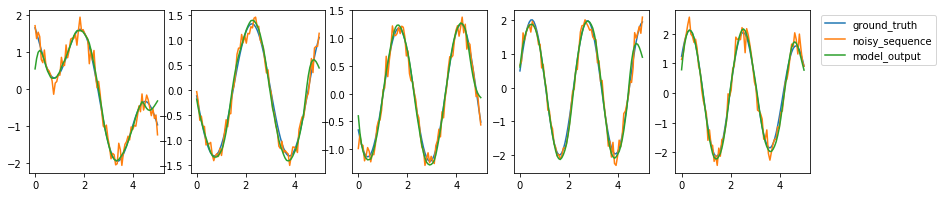

31.16% of noise removed.
epoch: 89, validation loss:101.60429382324219


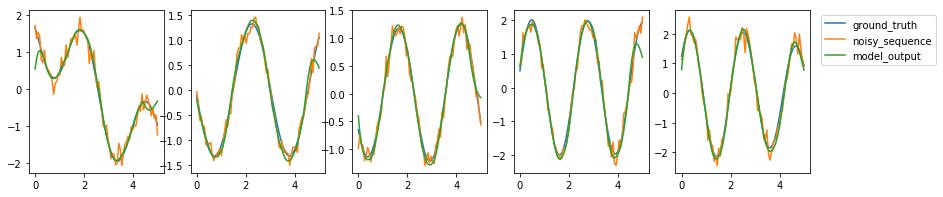

31.24% of noise removed.
epoch: 90, validation loss:101.50740814208984


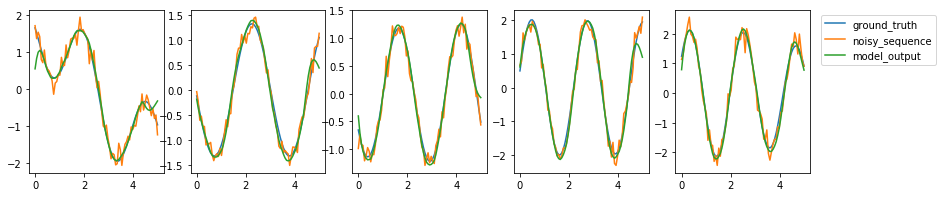

31.32% of noise removed.
epoch: 91, validation loss:101.42431640625


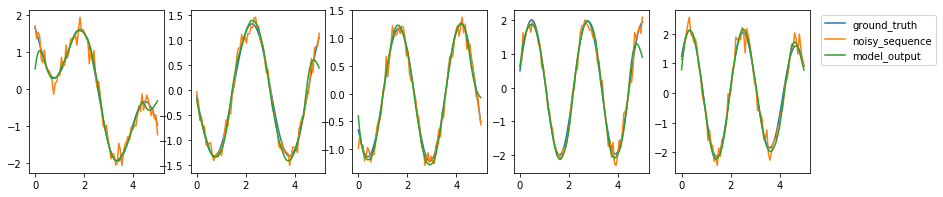

31.40% of noise removed.
epoch: 92, validation loss:101.35513305664062


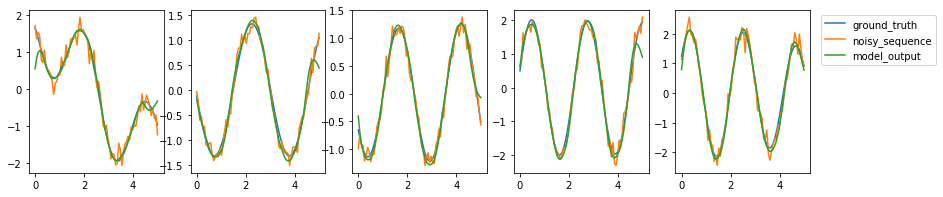

31.47% of noise removed.
epoch: 93, validation loss:101.29916381835938


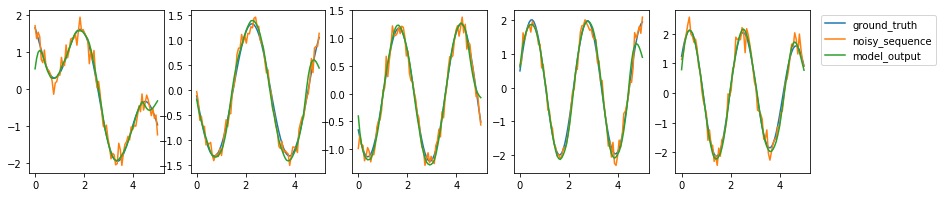

31.54% of noise removed.
epoch: 94, validation loss:101.25519561767578


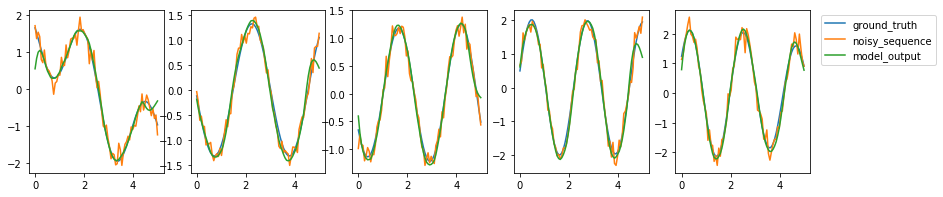

31.59% of noise removed.
epoch: 95, validation loss:101.22188568115234


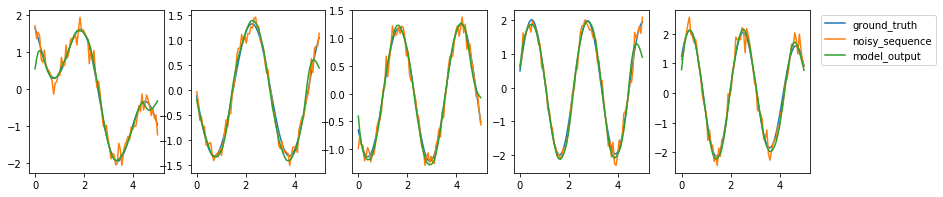

31.63% of noise removed.
epoch: 96, validation loss:101.19767761230469


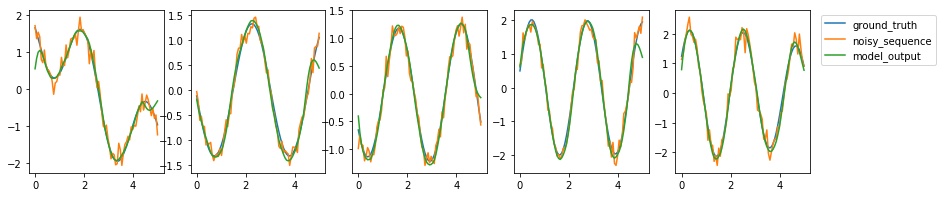

31.67% of noise removed.
epoch: 97, validation loss:101.18104553222656


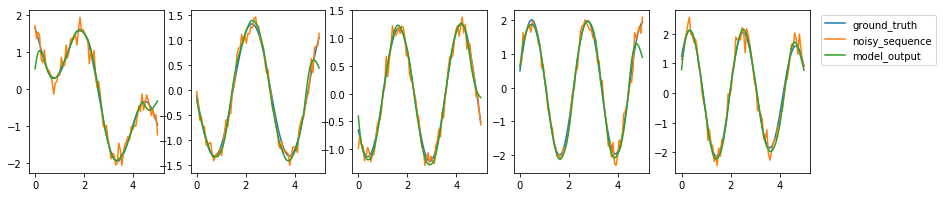

31.70% of noise removed.
epoch: 98, validation loss:101.17051696777344


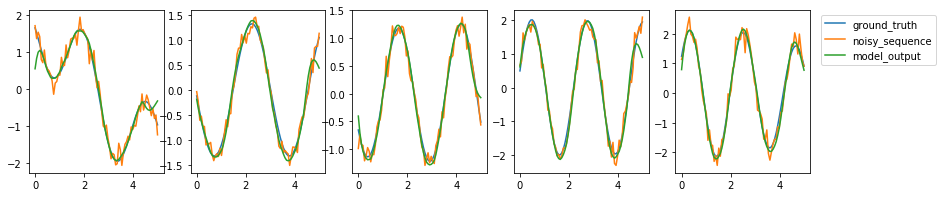

31.71% of noise removed.
epoch: 99, validation loss:101.16463470458984


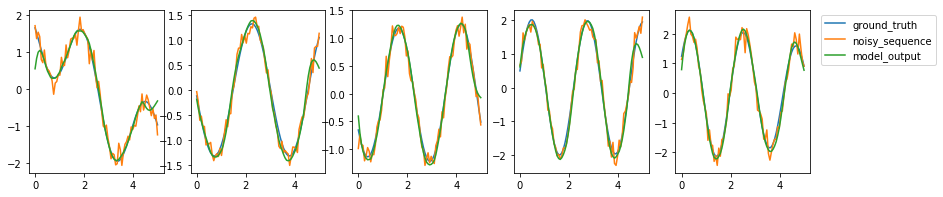

31.73% of noise removed.
epoch: 100, validation loss:101.16201782226562


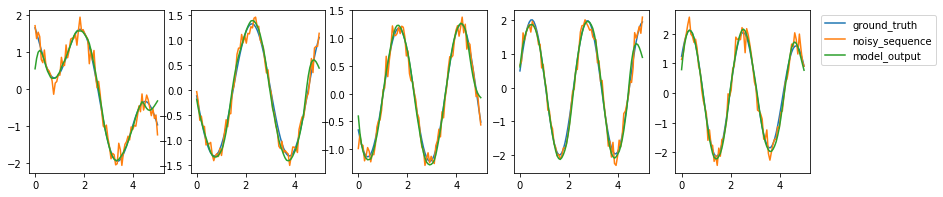

31.73% of noise removed.


In [13]:
# Reducing the learning rate to 0.001

batch_size = 20
num_epochs = 101
learning_rate = 0.001 # <- CHANGED

model_3 = NoiseRemovalModel(hidden_size=40, shift=10)
optimizer = optim.Adam(model_3.parameters(), lr=learning_rate, betas=(0.6, 0.87))
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)
print("cuda avialable :", torch.cuda.is_available())
train(model_3, optimizer, scheduler, num_epochs, batch_size)